In [1]:
import pandas as pd

# 데이터 불러오기

In [2]:
df_trial_1 = pd.read_csv("시도 지역코드.csv", encoding="cp949")
df_trial_2 = pd.read_csv("실제진료정보_감기_시도.csv", encoding="cp949")
df_trial_3 = pd.read_csv("실제진료정보_눈병_시도.csv", encoding="cp949")
df_trial_4 = pd.read_csv("실제진료정보_천식_시도.csv", encoding="cp949")
df_trial_5 = pd.read_csv("실제진료정보_피부염_시도.csv", encoding="cp949")
df_trial_2

,날짜,시도지역코드,발생건수(건)
0,20140101,11,5992
1,20140101,26,3158
2,20140101,27,2190
3,20140101,28,3426
4,20140101,29,2635
...,...,...,...
41900,20200930,46,3436
41901,20200930,47,4081
41902,20200930,48,4881
41903,20200930,49,1364


# 데이터 전처리

In [3]:
drop_sample_1 = df_trial_2[df_trial_2["시도지역코드"] == 99].index
drop_sample_2 = df_trial_3[df_trial_3["시도지역코드"] == 99].index
drop_sample_3 = df_trial_4[df_trial_4["시도지역코드"] == 99].index
drop_sample_4 = df_trial_5[df_trial_5["시도지역코드"] == 99].index

In [4]:
df_trial_2 = df_trial_2.drop(drop_sample_1).copy()
df_trial_3 = df_trial_3.drop(drop_sample_2).copy()
df_trial_4 = df_trial_4.drop(drop_sample_3).copy()
df_trial_5 = df_trial_5.drop(drop_sample_4).copy()

In [5]:
df_trial_2["날짜"] = df_trial_2["날짜"].astype("str")
df_trial_3["날짜"] = df_trial_3["날짜"].astype("str")
df_trial_4["날짜"] = df_trial_4["날짜"].astype("str")
df_trial_5["날짜"] = df_trial_5["날짜"].astype("str")

In [6]:
df_trial_2["날짜"].head(100)

0      20140101
1      20140101
2      20140101
3      20140101
4      20140101
         ...   
100    20140106
102    20140107
103    20140107
104    20140107
105    20140107
Name: 날짜, Length: 100, dtype: object

In [7]:
df_trial_2["날짜"] = pd.to_datetime(df_trial_2["날짜"])
df_trial_3["날짜"] = pd.to_datetime(df_trial_3["날짜"])
df_trial_4["날짜"] = pd.to_datetime(df_trial_4["날짜"])
df_trial_5["날짜"] = pd.to_datetime(df_trial_5["날짜"])

In [8]:
df_trial_2["연도"] = df_trial_2["날짜"].dt.year
df_trial_3["연도"] = df_trial_3["날짜"].dt.year
df_trial_4["연도"] = df_trial_4["날짜"].dt.year
df_trial_5["연도"] = df_trial_5["날짜"].dt.year

In [9]:
df_trial_2["월"] = df_trial_2["날짜"].dt.month
df_trial_3["월"] = df_trial_3["날짜"].dt.month
df_trial_4["월"] = df_trial_4["날짜"].dt.month
df_trial_5["월"] = df_trial_5["날짜"].dt.month

In [10]:
df_trial_2["월"]

0        1
1        1
2        1
3        1
4        1
        ..
41899    9
41900    9
41901    9
41902    9
41903    9
Name: 월, Length: 39440, dtype: int64

In [11]:
df_trial_2["연도"] = df_trial_2["연도"].astype("str")
df_trial_2["월"] = df_trial_2["월"].astype("str")

df_trial_3["연도"] = df_trial_3["연도"].astype("str")
df_trial_3["월"] = df_trial_3["월"].astype("str")

df_trial_4["연도"] = df_trial_4["연도"].astype("str")
df_trial_4["월"] = df_trial_4["월"].astype("str")

df_trial_5["연도"] = df_trial_5["연도"].astype("str")
df_trial_5["월"] = df_trial_5["월"].astype("str")

In [12]:
df_trial_2["연도별 월"] = df_trial_2[['연도', '월']].apply('-'.join, axis=1)
df_trial_3["연도별 월"] = df_trial_3[['연도', '월']].apply('-'.join, axis=1)
df_trial_4["연도별 월"] = df_trial_4[['연도', '월']].apply('-'.join, axis=1)
df_trial_5["연도별 월"] = df_trial_5[['연도', '월']].apply('-'.join, axis=1)

In [13]:
df_trial_2["연도별 월"].head(100)

0      2014-1
1      2014-1
2      2014-1
3      2014-1
4      2014-1
        ...  
100    2014-1
102    2014-1
103    2014-1
104    2014-1
105    2014-1
Name: 연도별 월, Length: 100, dtype: object

In [14]:
df_trial_2["시도지역코드"] = df_trial_2["시도지역코드"].astype("str").copy()
df_trial_3["시도지역코드"] = df_trial_3["시도지역코드"].astype("str").copy()
df_trial_4["시도지역코드"] = df_trial_4["시도지역코드"].astype("str").copy()
df_trial_5["시도지역코드"] = df_trial_5["시도지역코드"].astype("str").copy()

# 시도

In [15]:
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("11"), "시도명"] = "서울특별시"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("26"), "시도명"] = "부산광역시"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("27"), "시도명"] = "대구광역시"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("28"), "시도명"] = "인천광역시"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("29"), "시도명"] = "광주광역시"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("30"), "시도명"] = "대전광역시"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("31"), "시도명"] = "울산광역시"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("41"), "시도명"] = "경기도"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("42"), "시도명"] = "강원도"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("43"), "시도명"] = "충청북도"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("44"), "시도명"] = "충청남도"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("45"), "시도명"] = "전라북도"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("46"), "시도명"] = "전라남도"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("47"), "시도명"] = "경상북도"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("48"), "시도명"] = "경상남도"
df_trial_2.loc[df_trial_2["시도지역코드"].str.contains("49"), "시도명"] = "제주특별자치도"

In [16]:
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("11"), "시도명"] = "서울특별시"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("26"), "시도명"] = "부산광역시"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("27"), "시도명"] = "대구광역시"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("28"), "시도명"] = "인천광역시"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("29"), "시도명"] = "광주광역시"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("30"), "시도명"] = "대전광역시"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("31"), "시도명"] = "울산광역시"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("41"), "시도명"] = "경기도"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("42"), "시도명"] = "강원도"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("43"), "시도명"] = "충청북도"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("44"), "시도명"] = "충청남도"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("45"), "시도명"] = "전라북도"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("46"), "시도명"] = "전라남도"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("47"), "시도명"] = "경상북도"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("48"), "시도명"] = "경상남도"
df_trial_3.loc[df_trial_3["시도지역코드"].str.contains("49"), "시도명"] = "제주특별자치도"

In [17]:
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("11"), "시도명"] = "서울특별시"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("26"), "시도명"] = "부산광역시"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("27"), "시도명"] = "대구광역시"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("28"), "시도명"] = "인천광역시"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("29"), "시도명"] = "광주광역시"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("30"), "시도명"] = "대전광역시"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("31"), "시도명"] = "울산광역시"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("41"), "시도명"] = "경기도"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("42"), "시도명"] = "강원도"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("43"), "시도명"] = "충청북도"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("44"), "시도명"] = "충청남도"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("45"), "시도명"] = "전라북도"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("46"), "시도명"] = "전라남도"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("47"), "시도명"] = "경상북도"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("48"), "시도명"] = "경상남도"
df_trial_4.loc[df_trial_4["시도지역코드"].str.contains("49"), "시도명"] = "제주특별자치도"

In [18]:
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("11"), "시도명"] = "서울특별시"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("26"), "시도명"] = "부산광역시"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("27"), "시도명"] = "대구광역시"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("28"), "시도명"] = "인천광역시"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("29"), "시도명"] = "광주광역시"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("30"), "시도명"] = "대전광역시"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("31"), "시도명"] = "울산광역시"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("41"), "시도명"] = "경기도"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("42"), "시도명"] = "강원도"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("43"), "시도명"] = "충청북도"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("44"), "시도명"] = "충청남도"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("45"), "시도명"] = "전라북도"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("46"), "시도명"] = "전라남도"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("47"), "시도명"] = "경상북도"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("48"), "시도명"] = "경상남도"
df_trial_5.loc[df_trial_5["시도지역코드"].str.contains("49"), "시도명"] = "제주특별자치도"

In [19]:
df_trial_2 = df_trial_2.drop("시도지역코드", axis=1).copy()
df_trial_3 = df_trial_3.drop("시도지역코드", axis=1).copy()
df_trial_4 = df_trial_4.drop("시도지역코드", axis=1).copy()
df_trial_5 = df_trial_5.drop("시도지역코드", axis=1).copy()
df_trial_2

,날짜,발생건수(건),연도,월,연도별 월,시도명
0,2014-01-01,5992,2014,1,2014-1,서울특별시
1,2014-01-01,3158,2014,1,2014-1,부산광역시
2,2014-01-01,2190,2014,1,2014-1,대구광역시
3,2014-01-01,3426,2014,1,2014-1,인천광역시
4,2014-01-01,2635,2014,1,2014-1,광주광역시
...,...,...,...,...,...,...
41899,2020-09-30,3483,2020,9,2020-9,전라북도
41900,2020-09-30,3436,2020,9,2020-9,전라남도
41901,2020-09-30,4081,2020,9,2020-9,경상북도
41902,2020-09-30,4881,2020,9,2020-9,경상남도


In [20]:
df_trial_2 = df_trial_2.drop("날짜", axis=1).copy()
df_trial_3 = df_trial_3.drop("날짜", axis=1).copy()
df_trial_4 = df_trial_4.drop("날짜", axis=1).copy()
df_trial_5 = df_trial_5.drop("날짜", axis=1).copy()
df_trial_2

,발생건수(건),연도,월,연도별 월,시도명
0,5992,2014,1,2014-1,서울특별시
1,3158,2014,1,2014-1,부산광역시
2,2190,2014,1,2014-1,대구광역시
3,3426,2014,1,2014-1,인천광역시
4,2635,2014,1,2014-1,광주광역시
...,...,...,...,...,...
41899,3483,2020,9,2020-9,전라북도
41900,3436,2020,9,2020-9,전라남도
41901,4081,2020,9,2020-9,경상북도
41902,4881,2020,9,2020-9,경상남도


In [21]:
df_trial_2

,발생건수(건),연도,월,연도별 월,시도명
0,5992,2014,1,2014-1,서울특별시
1,3158,2014,1,2014-1,부산광역시
2,2190,2014,1,2014-1,대구광역시
3,3426,2014,1,2014-1,인천광역시
4,2635,2014,1,2014-1,광주광역시
...,...,...,...,...,...
41899,3483,2020,9,2020-9,전라북도
41900,3436,2020,9,2020-9,전라남도
41901,4081,2020,9,2020-9,경상북도
41902,4881,2020,9,2020-9,경상남도


In [22]:
df_trial_2.columns = ["감기발생건수", "연도", "월","연도별 월", "시도명"]
df_trial_3.columns = ["눈병발생건수", "연도", "월","연도별 월", "시도명"]
df_trial_4.columns = ["천식발생건수", "연도", "월","연도별 월", "시도명"]
df_trial_5.columns = ["피부염발생건수", "연도", "월","연도별 월", "시도명"]

In [23]:
df_trial_2

,감기발생건수,연도,월,연도별 월,시도명
0,5992,2014,1,2014-1,서울특별시
1,3158,2014,1,2014-1,부산광역시
2,2190,2014,1,2014-1,대구광역시
3,3426,2014,1,2014-1,인천광역시
4,2635,2014,1,2014-1,광주광역시
...,...,...,...,...,...
41899,3483,2020,9,2020-9,전라북도
41900,3436,2020,9,2020-9,전라남도
41901,4081,2020,9,2020-9,경상북도
41902,4881,2020,9,2020-9,경상남도


In [24]:
#df_trial_2 = df_trial_2.drop(["연도", "월"], axis=1)
df_trial_3 = df_trial_3.drop(["연도", "월", "연도별 월", "시도명"], axis=1)
df_trial_4 = df_trial_4.drop(["연도", "월", "연도별 월", "시도명"], axis=1)
df_trial_5 = df_trial_5.drop(["연도", "월", "연도별 월", "시도명"], axis=1)

In [25]:
df_trial_5

,피부염발생건수
0,246
1,138
2,85
3,138
4,81
...,...
41899,255
41900,495
41901,425
41902,583


In [26]:
df = pd.concat([df_trial_2, df_trial_3], axis=1)
df = pd.concat([df, df_trial_4], axis=1)
df = pd.concat([df, df_trial_5], axis=1)

In [27]:
pd.set_option('display.max_row', 500)
pd.set_option('display.max_columns', 100)

In [28]:
df.head(100)

,감기발생건수,연도,월,연도별 월,시도명,눈병발생건수,천식발생건수,피부염발생건수
0,5992,2014,1,2014-1,서울특별시,247,715,246
1,3158,2014,1,2014-1,부산광역시,91,554,138
2,2190,2014,1,2014-1,대구광역시,96,370,85
3,3426,2014,1,2014-1,인천광역시,83,437,138
4,2635,2014,1,2014-1,광주광역시,57,480,81
5,2861,2014,1,2014-1,대전광역시,73,238,123
6,1381,2014,1,2014-1,울산광역시,36,144,41
7,13646,2014,1,2014-1,경기도,325,1460,481
8,1101,2014,1,2014-1,강원도,44,193,44
9,2322,2014,1,2014-1,충청북도,73,335,118


In [29]:
df = df.reindex(columns=["시도명","연도", "월", "연도별 월", "감기발생건수", "눈병발생건수", "천식발생건수", "피부염발생건수"])

In [30]:
#지역별 월별 데이터
#증가량 추이 / lineplot

In [31]:
df["연도별 월"].value_counts()

2019-12    496
2020-8     496
2015-7     496
2017-12    496
2018-10    496
2020-7     496
2017-1     496
2016-10    496
2019-5     496
2018-7     496
2014-3     496
2014-12    496
2016-1     496
2014-10    496
2020-5     496
2016-8     496
2018-1     496
2020-1     496
2019-10    496
2017-10    496
2014-8     496
2015-8     496
2015-12    496
2016-7     496
2019-3     496
2014-5     496
2014-1     496
2016-5     496
2015-5     496
2017-5     496
2014-7     496
2018-3     496
2018-8     496
2016-3     496
2017-3     496
2017-8     496
2017-7     496
2019-7     496
2015-3     496
2016-12    496
2020-3     496
2018-12    496
2015-10    496
2019-1     496
2015-1     496
2019-8     496
2018-5     496
2018-9     480
2019-9     480
2018-4     480
2015-4     480
2016-11    480
2015-6     480
2017-11    480
2014-4     480
2019-6     480
2020-6     480
2016-6     480
2016-9     480
2019-4     480
2020-9     480
2017-9     480
2014-6     480
2019-11    480
2014-11    480
2017-6     480
2015-9    

In [32]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.rc('font', family='Malgun Gothic')
from IPython.display import set_matplotlib_formats
set_matplotlib_formats("retina")
plt.rcParams['axes.unicode_minus'] = False

# 서울 데이터

## 서울 전체 데이터

In [33]:
df_seoul_fool = df[df["시도명"] == "서울특별시"]
df_seoul_fool = df_seoul_fool.groupby("연도별 월").sum().copy()
df_seoul_fool = df_seoul_fool.reindex(index=["2014-1", "2014-2", "2014-3", "2014-4", "2014-5", "2014-6", "2014-7", "2014-8", "2014-9"
                                  , "2014-10", "2014-11", "2014-12", "2015-1", "2015-2", "2015-3", "2015-4", "2015-5"
                                  , "2015-6", "2015-7", "2015-8", "2015-9", "2015-10", "2015-11", "2015-12", "2016-1"
                                  , "2016-2", "2016-3", "2016-4", "2016-5", "2016-6", "2016-7", "2016-8", "2016-9"
                                  , "2016-10", "2016-11", "2016-12", "2017-1", "2017-2", "2017-3", "2017-4", "2017-5"
                                  , "2017-6", "2017-7", "2017-8", "2017-9", "2017-10", "2017-11", "2017-12", "2018-1"
                                  , "2018-2", "2018-3", "2018-4", "2018-5", "2018-6", "2018-7", "2018-8", "2018-9"
                                  , "2018-10", "2018-11", "2018-12", "2019-1", "2019-2", "2019-3", "2019-4", "2019-5"
                                  , "2019-6", "2019-7", "2019-8", "2019-9", "2019-10", "2019-11", "2019-12", "2020-1"
                                  , "2020-2", "2020-3", "2020-4", "2020-5", "2020-6", "2020-7", "2020-8", "2020-9"])
df_seoul_fool = df_seoul_fool.reset_index()

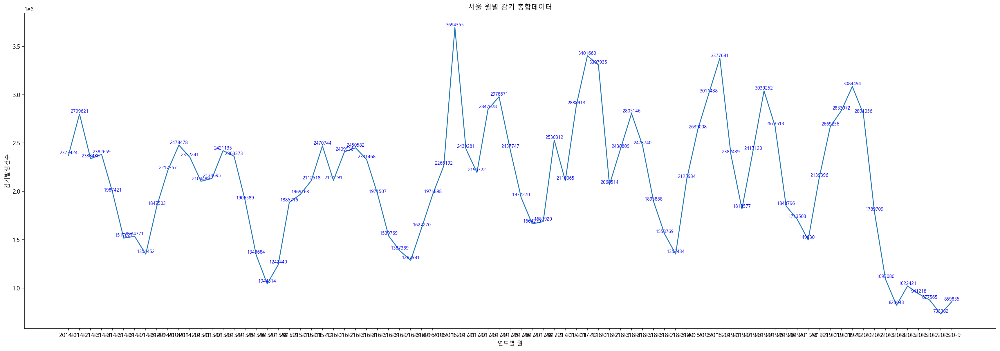

In [34]:
plt.figure(figsize=(30, 10))
plt.title("서울 월별 감기 총합데이터")
sns.lineplot(data=df_seoul_fool, x="연도별 월", y="감기발생건수")
for i, v in enumerate(df_seoul_fool["연도별 월"]):
    plt.text(v, (df_seoul_fool["감기발생건수"])[i], (df_seoul_fool["감기발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

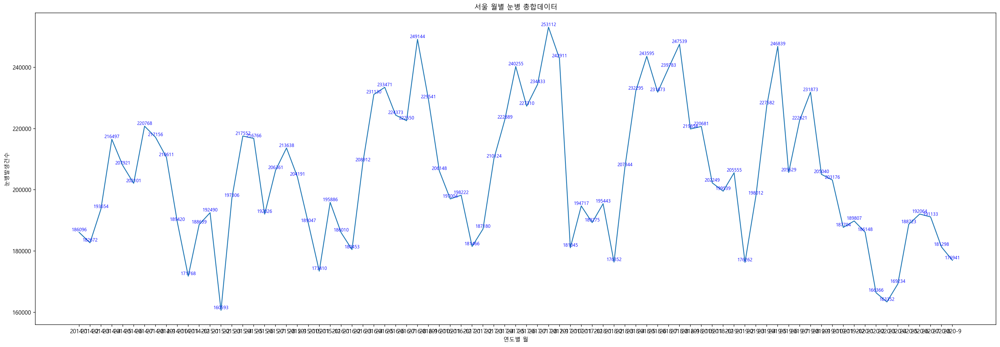

In [35]:
plt.figure(figsize=(30, 10))
plt.title("서울 월별 눈병 총합데이터")
sns.lineplot(data=df_seoul_fool, x="연도별 월", y="눈병발생건수")
for i, v in enumerate(df_seoul_fool["연도별 월"]):
    plt.text(v, (df_seoul_fool["눈병발생건수"])[i], (df_seoul_fool["눈병발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

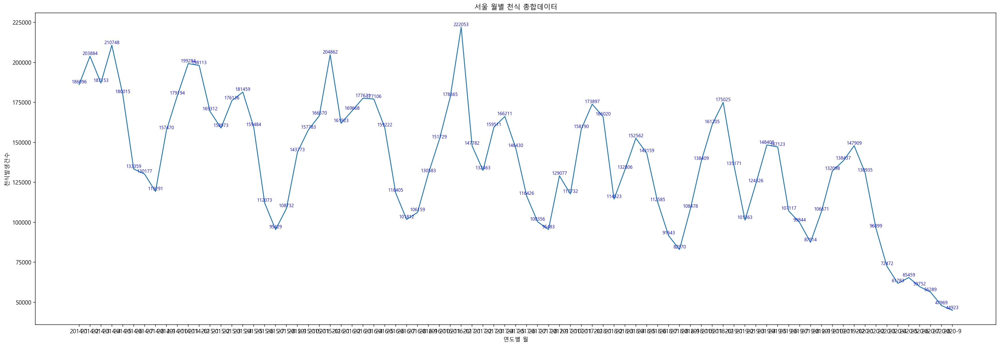

In [36]:
plt.figure(figsize=(30, 10))
plt.title("서울 월별 천식 총합데이터")
sns.lineplot(data=df_seoul_fool, x="연도별 월", y="천식발생건수")
for i, v in enumerate(df_seoul_fool["연도별 월"]):
    plt.text(v, (df_seoul_fool["천식발생건수"])[i], (df_seoul_fool["천식발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

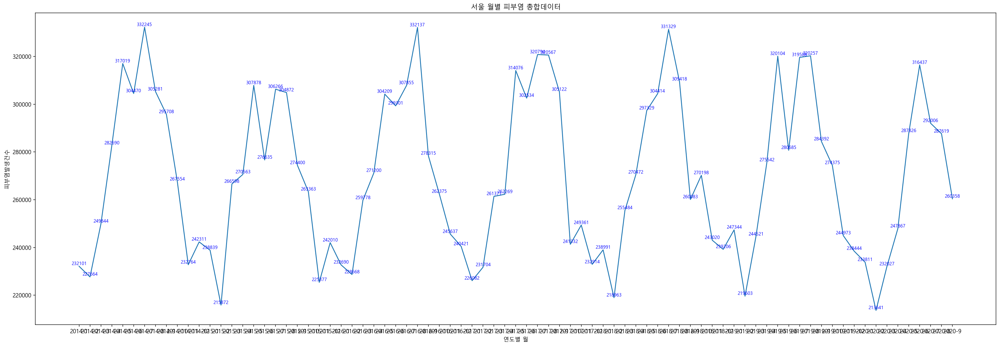

In [37]:
plt.figure(figsize=(30, 10))
plt.title("서울 월별 피부염 총합데이터")
sns.lineplot(data=df_seoul_fool, x="연도별 월", y="피부염발생건수")
for i, v in enumerate(df_seoul_fool["연도별 월"]):
    plt.text(v, (df_seoul_fool["피부염발생건수"])[i], (df_seoul_fool["피부염발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

## 서울 2014년도 데이터

In [38]:
df_seoul_2014 = df[(df["시도명"] == "서울특별시") | (df["연도"] == "2014")]
df_seoul_2014 = df_seoul_2014.drop(["연도별 월"], axis=1).copy()
df_seoul_2014["연도"] = df_seoul_2014["연도"].astype("str")
df_seoul_2014 = df_seoul_2014.groupby("월").sum()
df_seoul_2014 = df_seoul_2014.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_seoul_2014 = df_seoul_2014.reset_index()

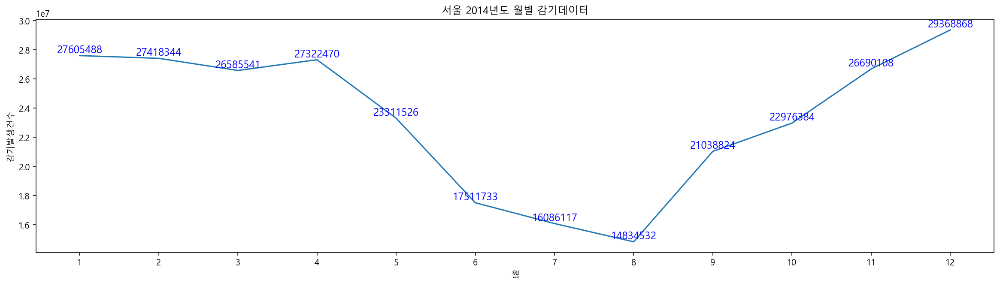

In [39]:
plt.figure(figsize=(20, 5))
plt.title("서울 2014년도 월별 감기데이터")
sns.lineplot(data=df_seoul_2014, x="월", y="감기발생건수")
for i, v in enumerate(df_seoul_2014["월"]):
    plt.text(v, (df_seoul_2014["감기발생건수"])[i], (df_seoul_2014["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

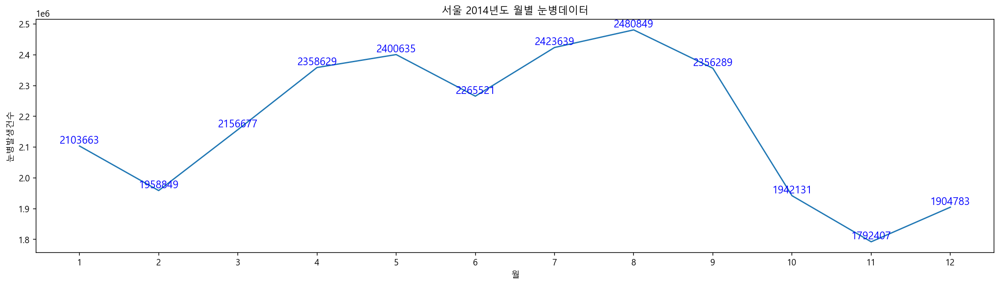

In [40]:
plt.figure(figsize=(20, 5))
plt.title("서울 2014년도 월별 눈병데이터")
sns.lineplot(data=df_seoul_2014, x="월", y="눈병발생건수")
for i, v in enumerate(df_seoul_2014["월"]):
    plt.text(v, (df_seoul_2014["눈병발생건수"])[i], (df_seoul_2014["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

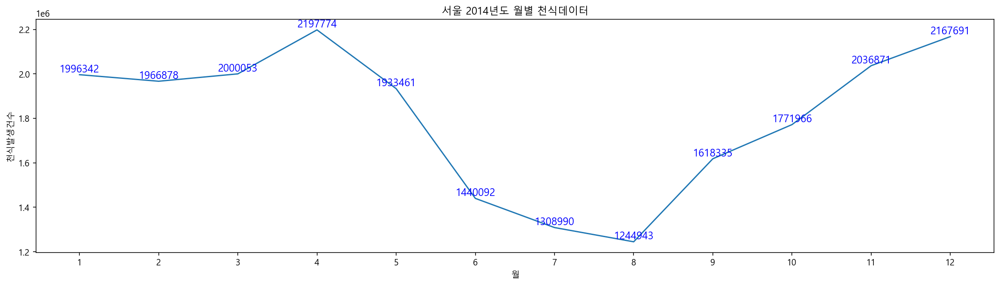

In [41]:
plt.figure(figsize=(20, 5))
plt.title("서울 2014년도 월별 천식데이터")
sns.lineplot(data=df_seoul_2014, x="월", y="천식발생건수")
for i, v in enumerate(df_seoul_2014["월"]):
    plt.text(v, (df_seoul_2014["천식발생건수"])[i], (df_seoul_2014["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

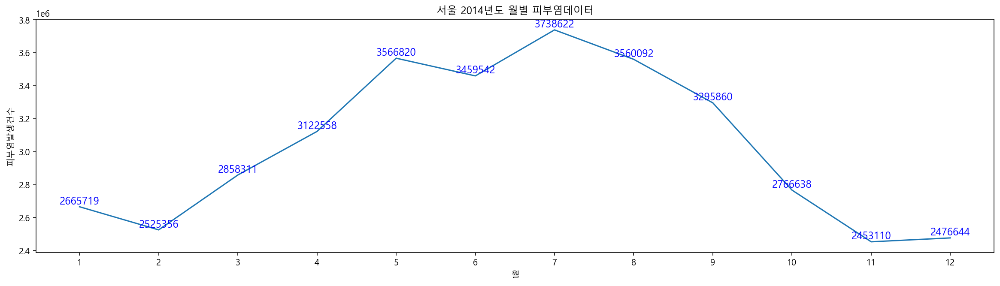

In [42]:
plt.figure(figsize=(20, 5))
plt.title("서울 2014년도 월별 피부염데이터")
sns.lineplot(data=df_seoul_2014, x="월", y="피부염발생건수")
for i, v in enumerate(df_seoul_2014["월"]):
    plt.text(v, (df_seoul_2014["피부염발생건수"])[i], (df_seoul_2014["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 서울 2015년도 데이터

In [43]:
df_seoul_2015 = df[(df["시도명"] == "서울특별시") | (df["연도"] == "2015")]
df_seoul_2015 = df_seoul_2015.drop(["연도별 월"], axis=1).copy()
df_seoul_2015["연도"] = df_seoul_2015["연도"].astype("str")
df_seoul_2015 = df_seoul_2015.groupby("월").sum()
df_seoul_2015 = df_seoul_2015.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_seoul_2015 = df_seoul_2015.reset_index()

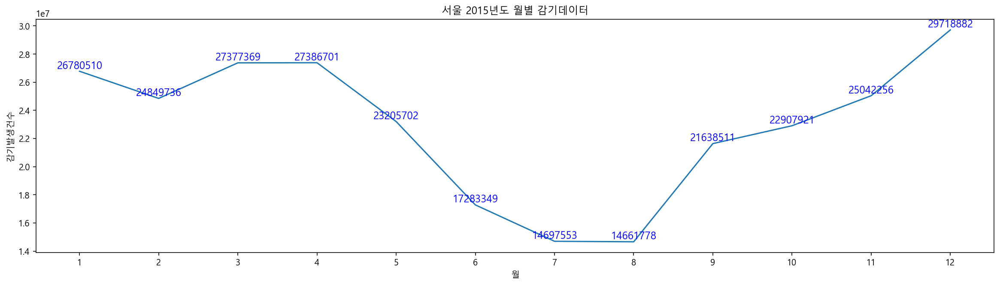

In [44]:
plt.figure(figsize=(20, 5))
plt.title("서울 2015년도 월별 감기데이터")
sns.lineplot(data=df_seoul_2015, x="월", y="감기발생건수")
for i, v in enumerate(df_seoul_2015["월"]):
    plt.text(v, (df_seoul_2015["감기발생건수"])[i], (df_seoul_2015["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

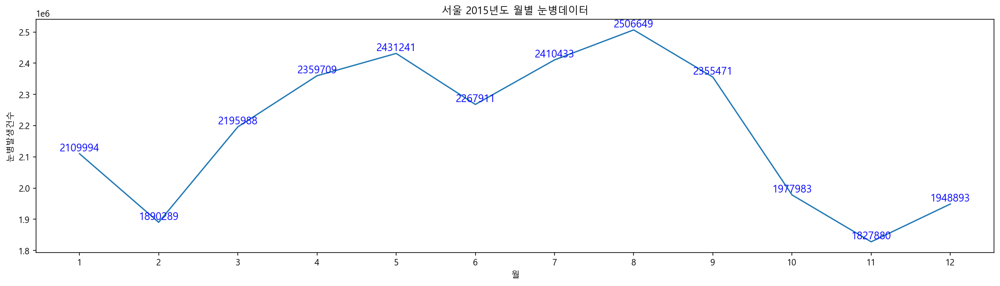

In [45]:
plt.figure(figsize=(20, 5))
plt.title("서울 2015년도 월별 눈병데이터")
sns.lineplot(data=df_seoul_2015, x="월", y="눈병발생건수")
for i, v in enumerate(df_seoul_2015["월"]):
    plt.text(v, (df_seoul_2015["눈병발생건수"])[i], (df_seoul_2015["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

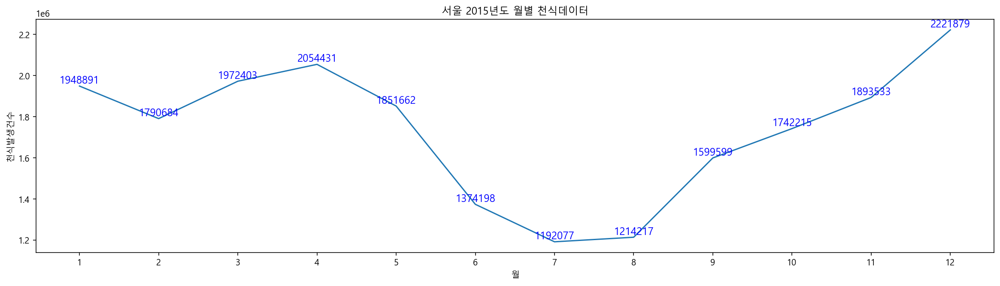

In [46]:
plt.figure(figsize=(20, 5))
plt.title("서울 2015년도 월별 천식데이터")
sns.lineplot(data=df_seoul_2015, x="월", y="천식발생건수")
for i, v in enumerate(df_seoul_2015["월"]):
    plt.text(v, (df_seoul_2015["천식발생건수"])[i], (df_seoul_2015["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

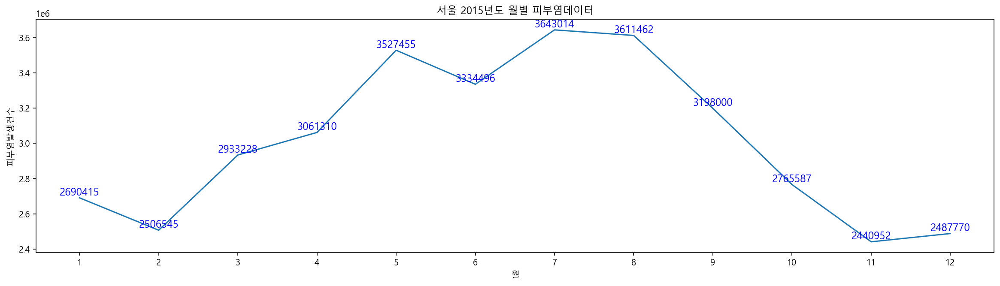

In [47]:
plt.figure(figsize=(20, 5))
plt.title("서울 2015년도 월별 피부염데이터")
sns.lineplot(data=df_seoul_2015, x="월", y="피부염발생건수")
for i, v in enumerate(df_seoul_2015["월"]):
    plt.text(v, (df_seoul_2015["피부염발생건수"])[i], (df_seoul_2015["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 서울 2016년도 데이터

In [48]:
df_seoul_2016 = df[(df["시도명"] == "서울특별시") | (df["연도"] == "2016")]
df_seoul_2016 = df_seoul_2016.drop(["연도별 월"], axis=1).copy()
df_seoul_2016["연도"] = df_seoul_2016["연도"].astype("str")
df_seoul_2016 = df_seoul_2016.groupby("월").sum()
df_seoul_2016 = df_seoul_2016.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_seoul_2016 = df_seoul_2016.reset_index()

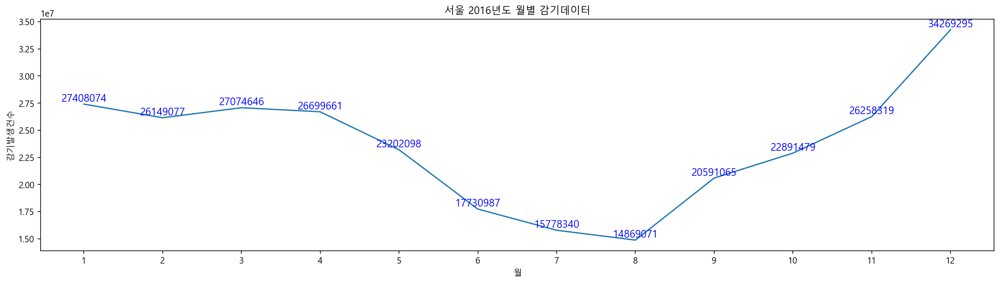

In [49]:
plt.figure(figsize=(20, 5))
plt.title("서울 2016년도 월별 감기데이터")
sns.lineplot(data=df_seoul_2016, x="월", y="감기발생건수")
for i, v in enumerate(df_seoul_2016["월"]):
    plt.text(v, (df_seoul_2016["감기발생건수"])[i], (df_seoul_2016["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

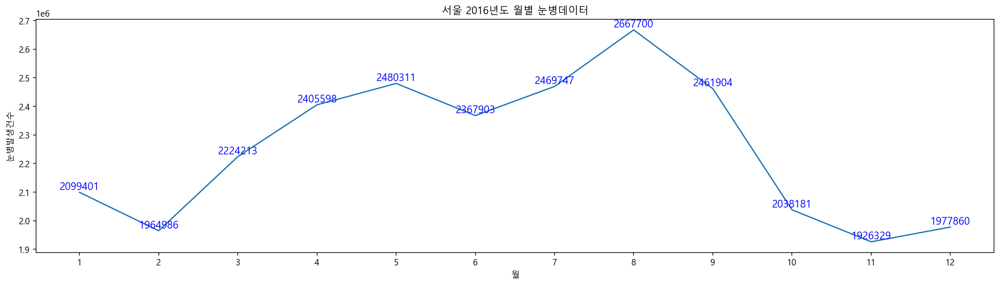

In [50]:
plt.figure(figsize=(20, 5))
plt.title("서울 2016년도 월별 눈병데이터")
sns.lineplot(data=df_seoul_2016, x="월", y="눈병발생건수")
for i, v in enumerate(df_seoul_2016["월"]):
    plt.text(v, (df_seoul_2016["눈병발생건수"])[i], (df_seoul_2016["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

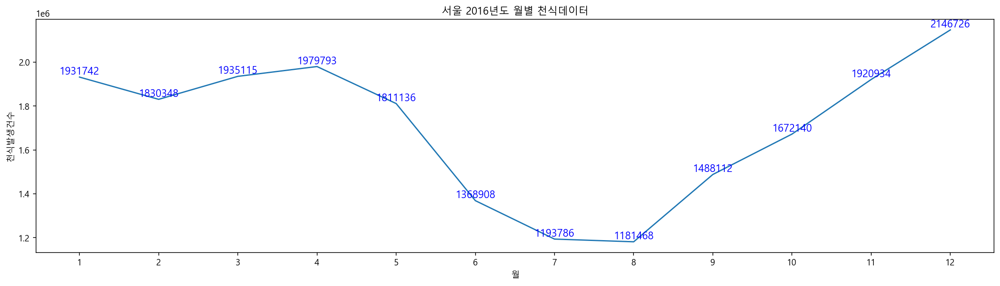

In [51]:
plt.figure(figsize=(20, 5))
plt.title("서울 2016년도 월별 천식데이터")
sns.lineplot(data=df_seoul_2016, x="월", y="천식발생건수")
for i, v in enumerate(df_seoul_2016["월"]):
    plt.text(v, (df_seoul_2016["천식발생건수"])[i], (df_seoul_2016["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

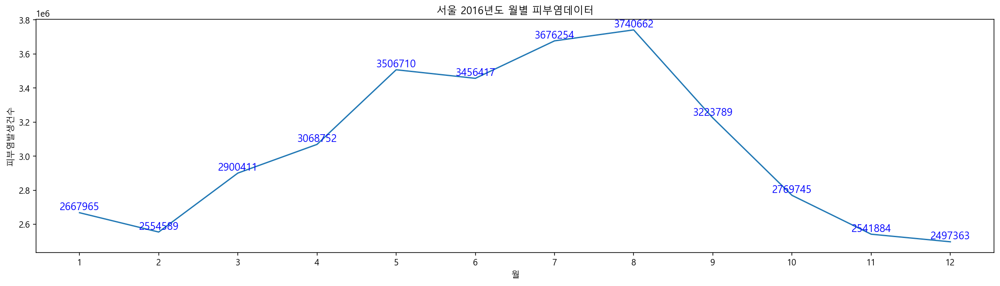

In [52]:
plt.figure(figsize=(20, 5))
plt.title("서울 2016년도 월별 피부염데이터")
sns.lineplot(data=df_seoul_2016, x="월", y="피부염발생건수")
for i, v in enumerate(df_seoul_2016["월"]):
    plt.text(v, (df_seoul_2016["피부염발생건수"])[i], (df_seoul_2016["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 서울 2017년도 데이터

In [53]:
df_seoul_2017 = df[(df["시도명"] == "서울특별시") | (df["연도"] == "2017")]
df_seoul_2017 = df_seoul_2017.drop(["연도별 월"], axis=1).copy()
df_seoul_2017["연도"] = df_seoul_2017["연도"].astype("str")
df_seoul_2017 = df_seoul_2017.groupby("월").sum()
df_seoul_2017 = df_seoul_2017.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_seoul_2017 = df_seoul_2017.reset_index()

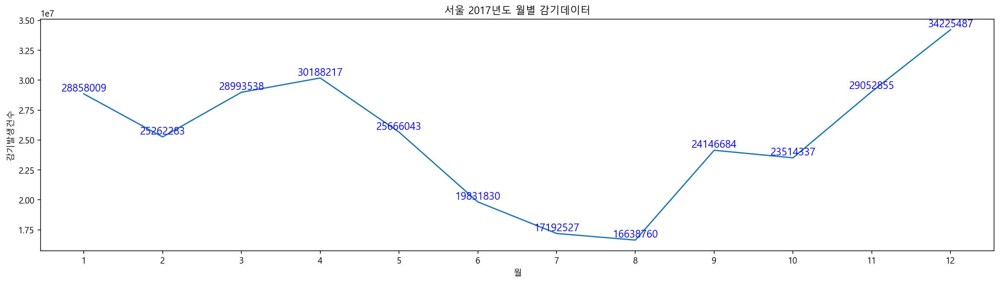

In [54]:
plt.figure(figsize=(20, 5))
plt.title("서울 2017년도 월별 감기데이터")
sns.lineplot(data=df_seoul_2017, x="월", y="감기발생건수")
for i, v in enumerate(df_seoul_2017["월"]):
    plt.text(v, (df_seoul_2017["감기발생건수"])[i], (df_seoul_2017["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

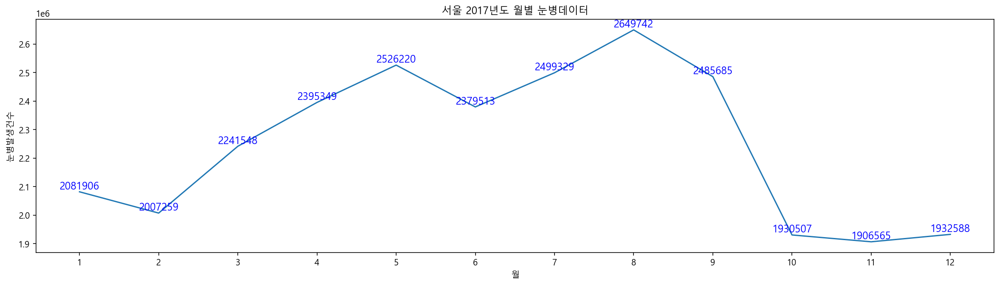

In [55]:
plt.figure(figsize=(20, 5))
plt.title("서울 2017년도 월별 눈병데이터")
sns.lineplot(data=df_seoul_2017, x="월", y="눈병발생건수")
for i, v in enumerate(df_seoul_2017["월"]):
    plt.text(v, (df_seoul_2017["눈병발생건수"])[i], (df_seoul_2017["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

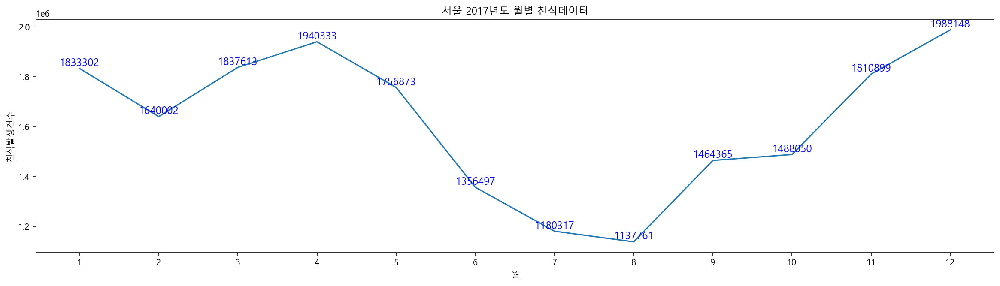

In [56]:
plt.figure(figsize=(20, 5))
plt.title("서울 2017년도 월별 천식데이터")
sns.lineplot(data=df_seoul_2017, x="월", y="천식발생건수")
for i, v in enumerate(df_seoul_2017["월"]):
    plt.text(v, (df_seoul_2017["천식발생건수"])[i], (df_seoul_2017["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

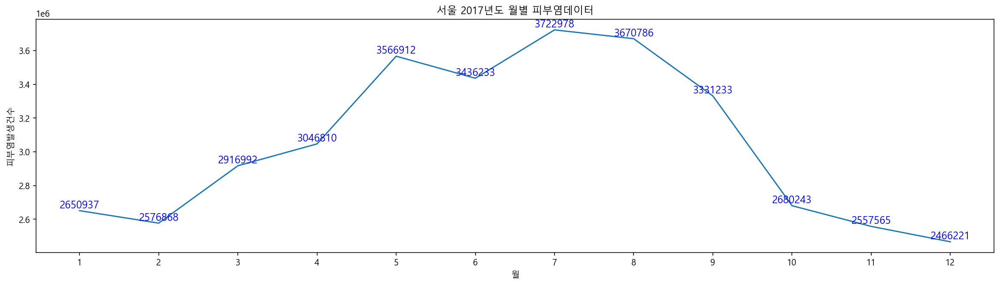

In [57]:
plt.figure(figsize=(20, 5))
plt.title("서울 2017년도 월별 피부염데이터")
sns.lineplot(data=df_seoul_2017, x="월", y="피부염발생건수")
for i, v in enumerate(df_seoul_2017["월"]):
    plt.text(v, (df_seoul_2017["피부염발생건수"])[i], (df_seoul_2017["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 서울 2018년도 데이터

In [58]:
df_seoul_2018 = df[(df["시도명"] == "서울특별시") | (df["연도"] == "2018")]
df_seoul_2018 = df_seoul_2018.drop(["연도별 월"], axis=1).copy()
df_seoul_2018["연도"] = df_seoul_2018["연도"].astype("str")
df_seoul_2018 = df_seoul_2018.groupby("월").sum()
df_seoul_2018 = df_seoul_2018.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_seoul_2018 = df_seoul_2018.reset_index()

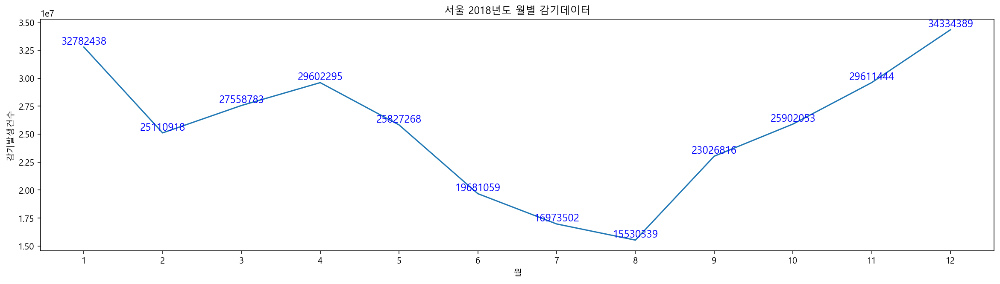

In [59]:
plt.figure(figsize=(20, 5))
plt.title("서울 2018년도 월별 감기데이터")
sns.lineplot(data=df_seoul_2018, x="월", y="감기발생건수")
for i, v in enumerate(df_seoul_2018["월"]):
    plt.text(v, (df_seoul_2018["감기발생건수"])[i], (df_seoul_2018["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

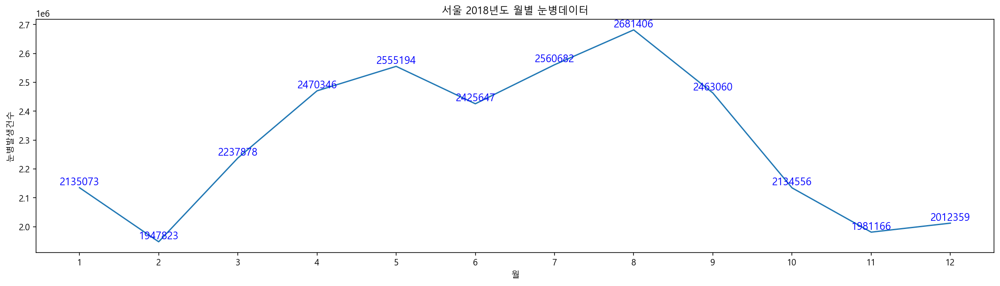

In [60]:
plt.figure(figsize=(20, 5))
plt.title("서울 2018년도 월별 눈병데이터")
sns.lineplot(data=df_seoul_2018, x="월", y="눈병발생건수")
for i, v in enumerate(df_seoul_2018["월"]):
    plt.text(v, (df_seoul_2018["눈병발생건수"])[i], (df_seoul_2018["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

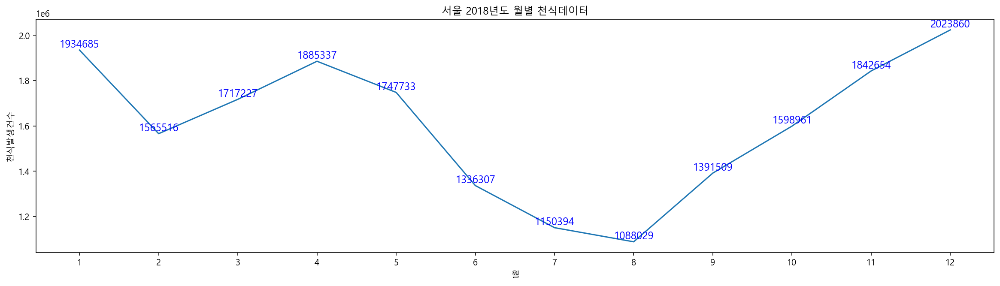

In [61]:
plt.figure(figsize=(20, 5))
plt.title("서울 2018년도 월별 천식데이터")
sns.lineplot(data=df_seoul_2018, x="월", y="천식발생건수")
for i, v in enumerate(df_seoul_2018["월"]):
    plt.text(v, (df_seoul_2018["천식발생건수"])[i], (df_seoul_2018["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

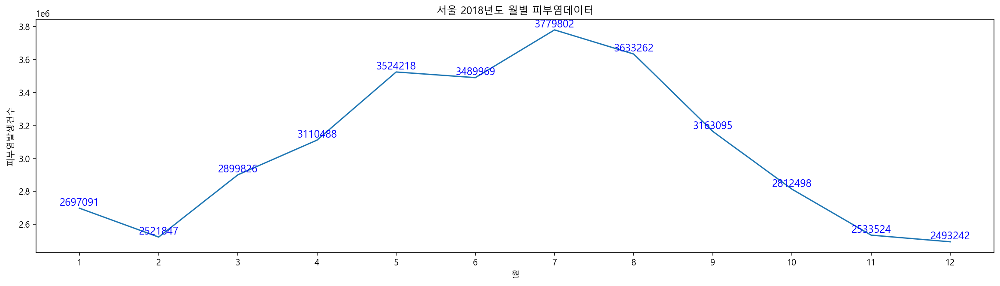

In [62]:
plt.figure(figsize=(20, 5))
plt.title("서울 2018년도 월별 피부염데이터")
sns.lineplot(data=df_seoul_2018, x="월", y="피부염발생건수")
for i, v in enumerate(df_seoul_2018["월"]):
    plt.text(v, (df_seoul_2018["피부염발생건수"])[i], (df_seoul_2018["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 서울 2019년도 데이터 

In [63]:
df_seoul_2019 = df[(df["시도명"] == "서울특별시") | (df["연도"] == "2019")]
df_seoul_2019 = df_seoul_2019.drop(["연도별 월"], axis=1).copy()
df_seoul_2019["연도"] = df_seoul_2019["연도"].astype("str")
df_seoul_2019 = df_seoul_2019.groupby("월").sum()
df_seoul_2019 = df_seoul_2019.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_seoul_2019 = df_seoul_2019.reset_index()

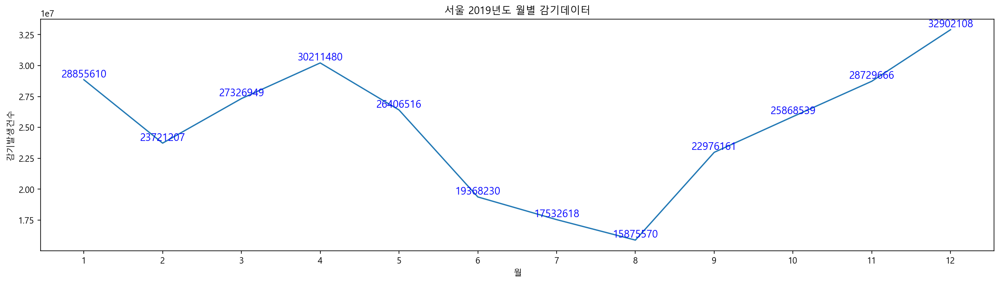

In [64]:
plt.figure(figsize=(20, 5))
plt.title("서울 2019년도 월별 감기데이터")
sns.lineplot(data=df_seoul_2019, x="월", y="감기발생건수")
for i, v in enumerate(df_seoul_2019["월"]):
    plt.text(v, (df_seoul_2019["감기발생건수"])[i], (df_seoul_2019["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

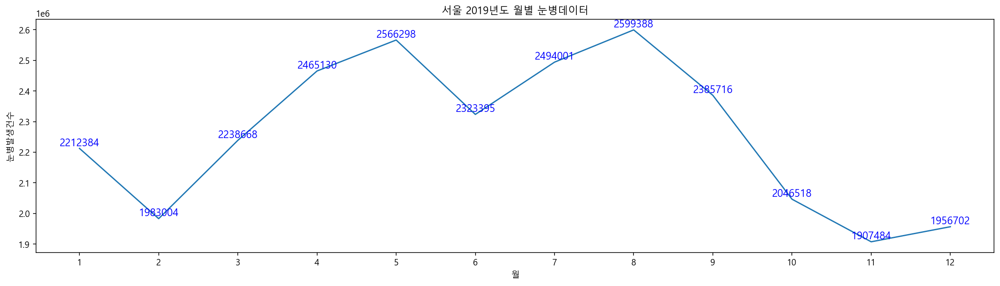

In [65]:
plt.figure(figsize=(20, 5))
plt.title("서울 2019년도 월별 눈병데이터")
sns.lineplot(data=df_seoul_2019, x="월", y="눈병발생건수")
for i, v in enumerate(df_seoul_2019["월"]):
    plt.text(v, (df_seoul_2019["눈병발생건수"])[i], (df_seoul_2019["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

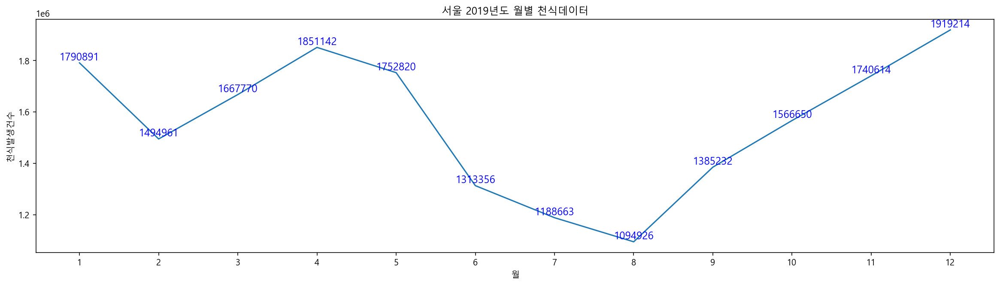

In [66]:
plt.figure(figsize=(20, 5))
plt.title("서울 2019년도 월별 천식데이터")
sns.lineplot(data=df_seoul_2019, x="월", y="천식발생건수")
for i, v in enumerate(df_seoul_2019["월"]):
    plt.text(v, (df_seoul_2019["천식발생건수"])[i], (df_seoul_2019["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

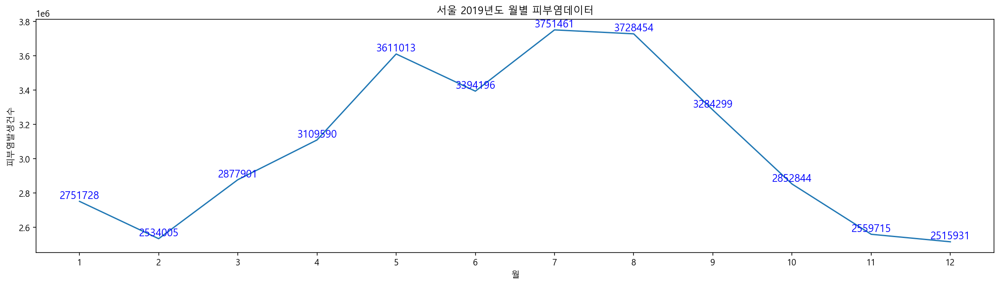

In [67]:
plt.figure(figsize=(20, 5))
plt.title("서울 2019년도 월별 피부염데이터")
sns.lineplot(data=df_seoul_2019, x="월", y="피부염발생건수")
for i, v in enumerate(df_seoul_2019["월"]):
    plt.text(v, (df_seoul_2019["피부염발생건수"])[i], (df_seoul_2019["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 서울 2020년도 데이터

In [68]:
df_seoul_2020 = df[(df["시도명"] == "서울특별시") | (df["연도"] == "2020")]
df_seoul_2020 = df_seoul_2020.drop(["연도별 월"], axis=1).copy()
df_seoul_2020["연도"] = df_seoul_2020["연도"].astype("str")
df_seoul_2020 = df_seoul_2020.groupby("월").sum()
df_seoul_2020 = df_seoul_2020.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9"])
df_seoul_2020 = df_seoul_2020.reset_index()

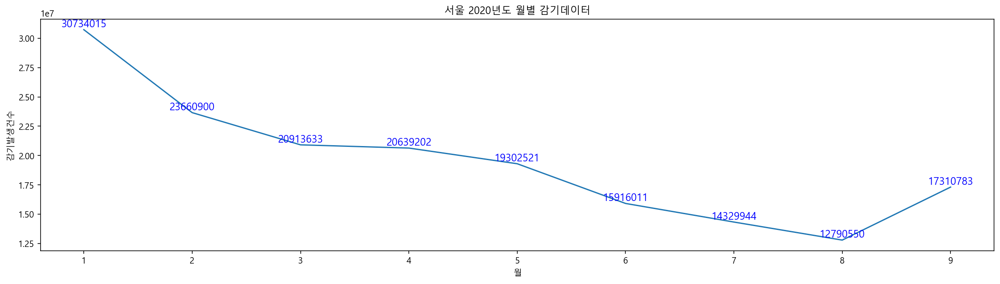

In [69]:
plt.figure(figsize=(20, 5))
plt.title("서울 2020년도 월별 감기데이터")
sns.lineplot(data=df_seoul_2020, x="월", y="감기발생건수")
for i, v in enumerate(df_seoul_2020["월"]):
    plt.text(v, (df_seoul_2020["감기발생건수"])[i], (df_seoul_2020["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

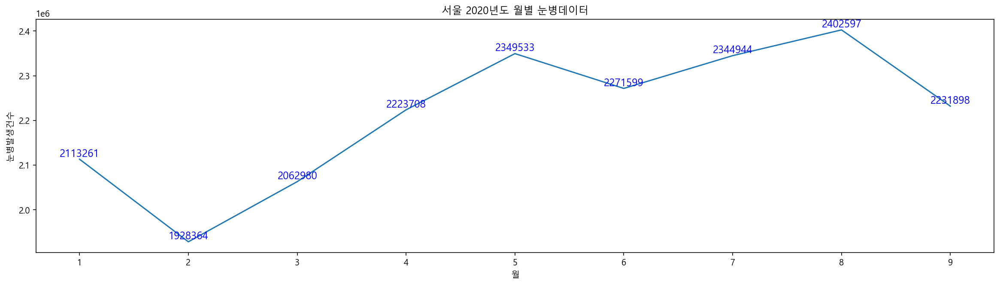

In [70]:
plt.figure(figsize=(20, 5))
plt.title("서울 2020년도 월별 눈병데이터")
sns.lineplot(data=df_seoul_2020, x="월", y="눈병발생건수")
for i, v in enumerate(df_seoul_2020["월"]):
    plt.text(v, (df_seoul_2020["눈병발생건수"])[i], (df_seoul_2020["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

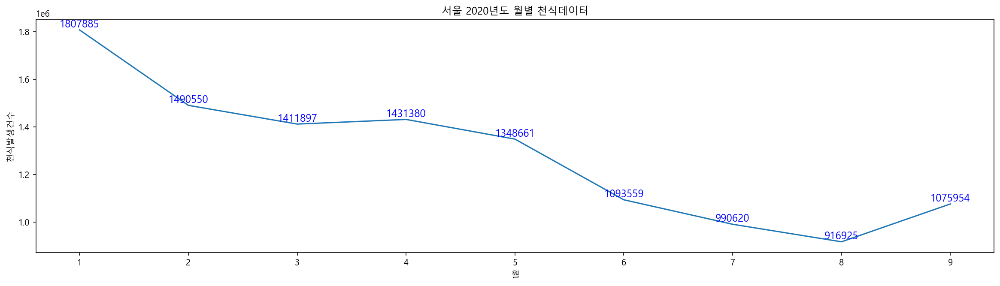

In [71]:
plt.figure(figsize=(20, 5))
plt.title("서울 2020년도 월별 천식데이터")
sns.lineplot(data=df_seoul_2020, x="월", y="천식발생건수")
for i, v in enumerate(df_seoul_2020["월"]):
    plt.text(v, (df_seoul_2020["천식발생건수"])[i], (df_seoul_2020["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

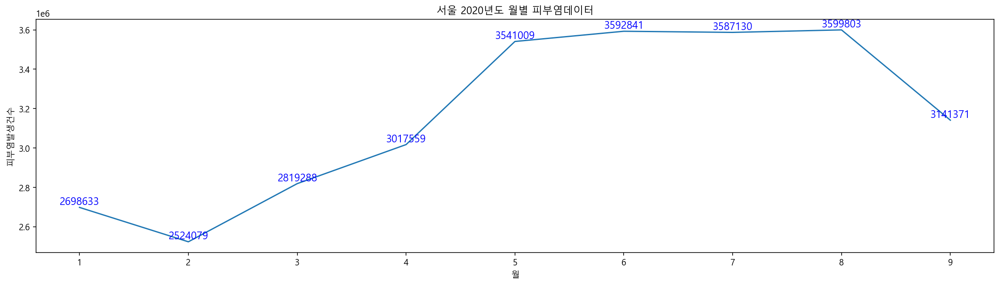

In [72]:
plt.figure(figsize=(20, 5))
plt.title("서울 2020년도 월별 피부염데이터")
sns.lineplot(data=df_seoul_2020, x="월", y="피부염발생건수")
for i, v in enumerate(df_seoul_2020["월"]):
    plt.text(v, (df_seoul_2020["피부염발생건수"])[i], (df_seoul_2020["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

# 경기도 데이터

## 경기도 전체 데이터

In [73]:
df_gyunggi_fool = df[df["시도명"] == "경기도"]
df_gyunggi_fool = df_gyunggi_fool.groupby("연도별 월").sum().copy()
df_gyunggi_fool = df_gyunggi_fool.reindex(index=["2014-1", "2014-2", "2014-3", "2014-4", "2014-5", "2014-6", "2014-7", "2014-8", "2014-9"
                                  , "2014-10", "2014-11", "2014-12", "2015-1", "2015-2", "2015-3", "2015-4", "2015-5"
                                  , "2015-6", "2015-7", "2015-8", "2015-9", "2015-10", "2015-11", "2015-12", "2016-1"
                                  , "2016-2", "2016-3", "2016-4", "2016-5", "2016-6", "2016-7", "2016-8", "2016-9"
                                  , "2016-10", "2016-11", "2016-12", "2017-1", "2017-2", "2017-3", "2017-4", "2017-5"
                                  , "2017-6", "2017-7", "2017-8", "2017-9", "2017-10", "2017-11", "2017-12", "2018-1"
                                  , "2018-2", "2018-3", "2018-4", "2018-5", "2018-6", "2018-7", "2018-8", "2018-9"
                                  , "2018-10", "2018-11", "2018-12", "2019-1", "2019-2", "2019-3", "2019-4", "2019-5"
                                  , "2019-6", "2019-7", "2019-8", "2019-9", "2019-10", "2019-11", "2019-12", "2020-1"
                                  , "2020-2", "2020-3", "2020-4", "2020-5", "2020-6", "2020-7", "2020-8", "2020-9"])
df_gyunggi_fool = df_gyunggi_fool.reset_index()

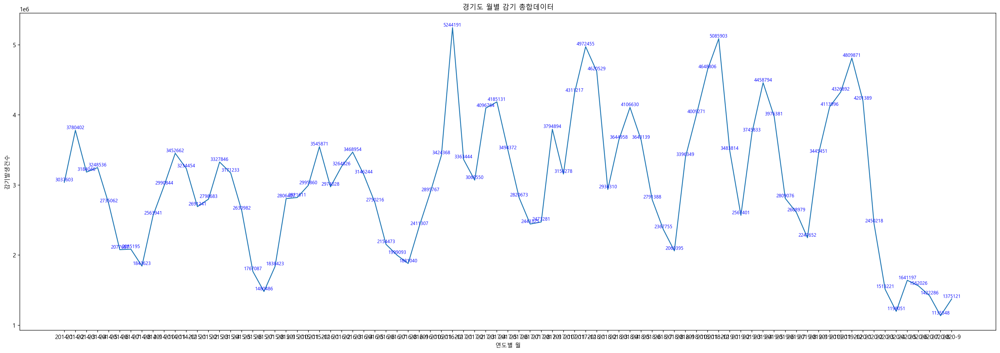

In [74]:
plt.figure(figsize=(30, 10))
plt.title("경기도 월별 감기 총합데이터")
sns.lineplot(data=df_gyunggi_fool, x="연도별 월", y="감기발생건수")
for i, v in enumerate(df_gyunggi_fool["연도별 월"]):
    plt.text(v, (df_gyunggi_fool["감기발생건수"])[i], (df_gyunggi_fool["감기발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

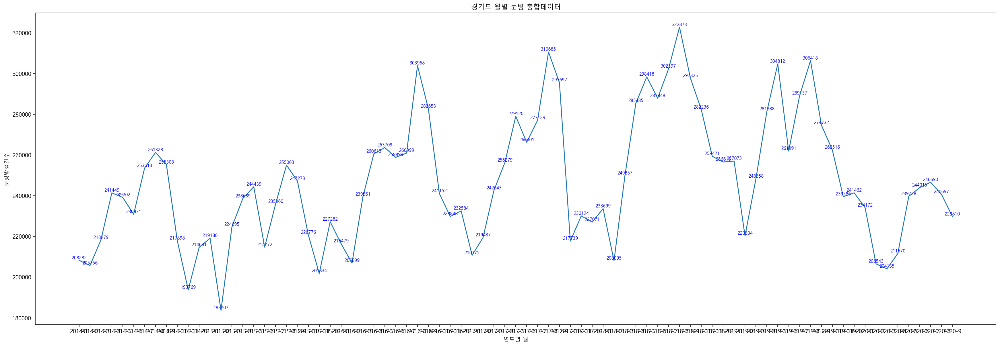

In [75]:
plt.figure(figsize=(30, 10))
plt.title("경기도 월별 눈병 총합데이터")
sns.lineplot(data=df_gyunggi_fool, x="연도별 월", y="눈병발생건수")
for i, v in enumerate(df_gyunggi_fool["연도별 월"]):
    plt.text(v, (df_gyunggi_fool["눈병발생건수"])[i], (df_gyunggi_fool["눈병발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

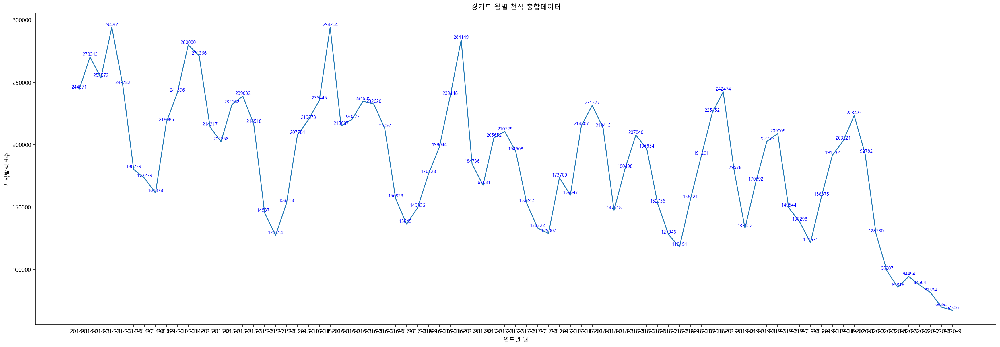

In [76]:
plt.figure(figsize=(30, 10))
plt.title("경기도 월별 천식 총합데이터")
sns.lineplot(data=df_gyunggi_fool, x="연도별 월", y="천식발생건수")
for i, v in enumerate(df_gyunggi_fool["연도별 월"]):
    plt.text(v, (df_gyunggi_fool["천식발생건수"])[i], (df_gyunggi_fool["천식발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

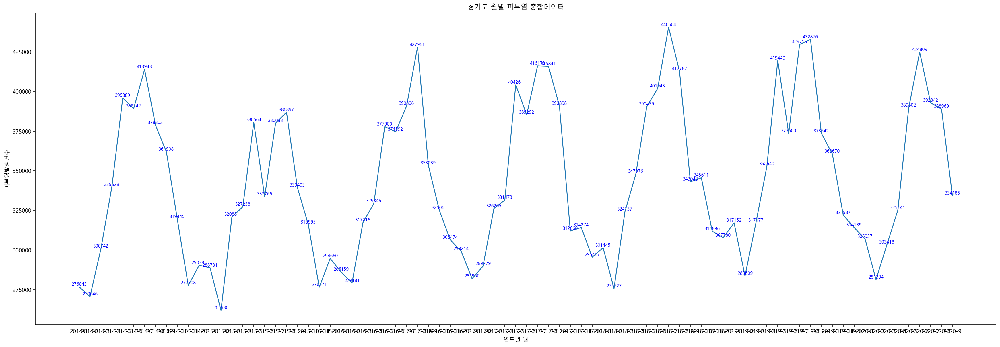

In [77]:
plt.figure(figsize=(30, 10))
plt.title("경기도 월별 피부염 총합데이터")
sns.lineplot(data=df_gyunggi_fool, x="연도별 월", y="피부염발생건수")
for i, v in enumerate(df_gyunggi_fool["연도별 월"]):
    plt.text(v, (df_gyunggi_fool["피부염발생건수"])[i], (df_gyunggi_fool["피부염발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

## 경기도 2014년도 데이터

In [78]:
df_gyunggi_2014 = df[(df["시도명"] == "경기도") | (df["연도"] == "2014")]
df_gyunggi_2014 = df_gyunggi_2014.drop(["연도별 월"], axis=1).copy()
df_gyunggi_2014["연도"] = df_gyunggi_2014["연도"].astype("str")
df_gyunggi_2014 = df_gyunggi_2014.groupby("월").sum()
df_gyunggi_2014 = df_gyunggi_2014.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_gyunggi_2014 = df_gyunggi_2014.reset_index()

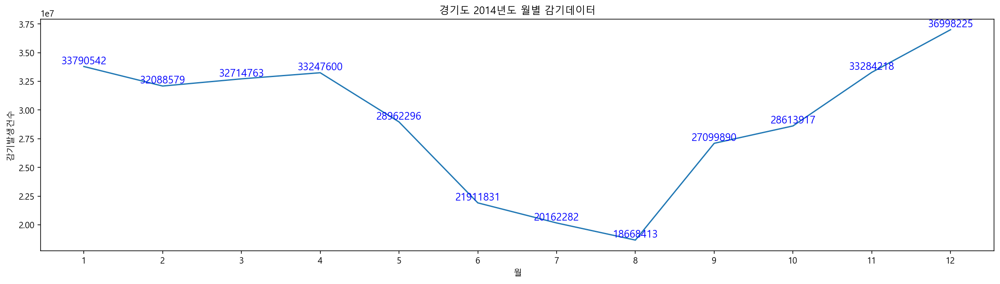

In [79]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2014년도 월별 감기데이터")
sns.lineplot(data=df_gyunggi_2014, x="월", y="감기발생건수")
for i, v in enumerate(df_gyunggi_2014["월"]):
    plt.text(v, (df_gyunggi_2014["감기발생건수"])[i], (df_gyunggi_2014["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

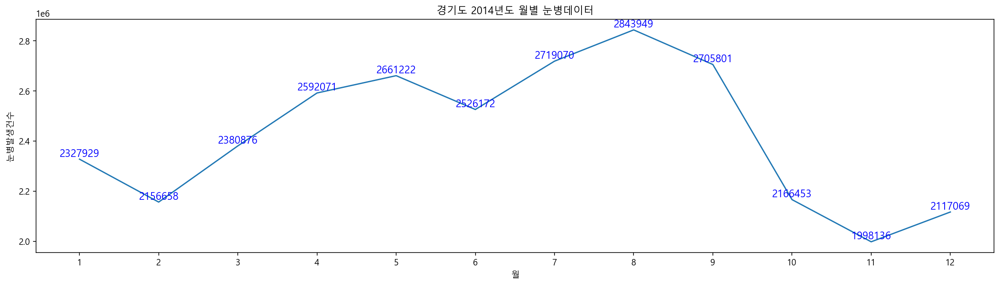

In [80]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2014년도 월별 눈병데이터")
sns.lineplot(data=df_gyunggi_2014, x="월", y="눈병발생건수")
for i, v in enumerate(df_gyunggi_2014["월"]):
    plt.text(v, (df_gyunggi_2014["눈병발생건수"])[i], (df_gyunggi_2014["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

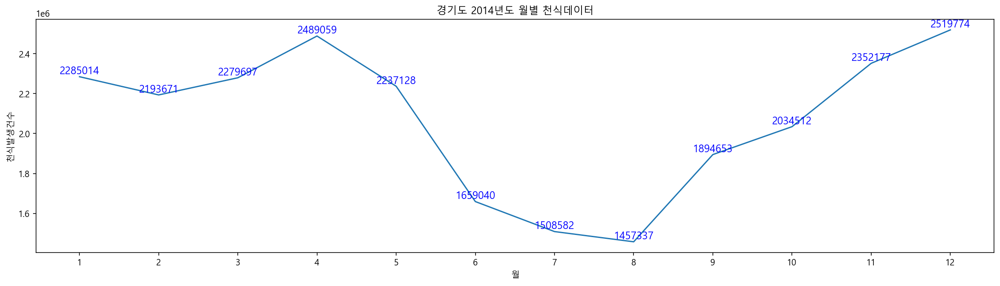

In [81]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2014년도 월별 천식데이터")
sns.lineplot(data=df_gyunggi_2014, x="월", y="천식발생건수")
for i, v in enumerate(df_gyunggi_2014["월"]):
    plt.text(v, (df_gyunggi_2014["천식발생건수"])[i], (df_gyunggi_2014["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

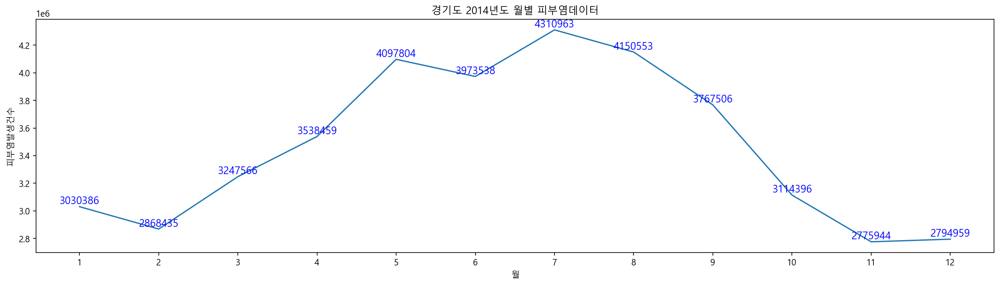

In [82]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2014년도 월별 피부염데이터")
sns.lineplot(data=df_gyunggi_2014, x="월", y="피부염발생건수")
for i, v in enumerate(df_gyunggi_2014["월"]):
    plt.text(v, (df_gyunggi_2014["피부염발생건수"])[i], (df_gyunggi_2014["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 경기도 2015년도 데이터

In [83]:
df_gyunggi_2015 = df[(df["시도명"] == "경기도") | (df["연도"] == "2015")]
df_gyunggi_2015 = df_gyunggi_2015.drop(["연도별 월"], axis=1).copy()
df_gyunggi_2015["연도"] = df_gyunggi_2015["연도"].astype("str")
df_gyunggi_2015 = df_gyunggi_2015.groupby("월").sum()
df_gyunggi_2015 = df_gyunggi_2015.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_gyunggi_2015 = df_gyunggi_2015.reset_index()

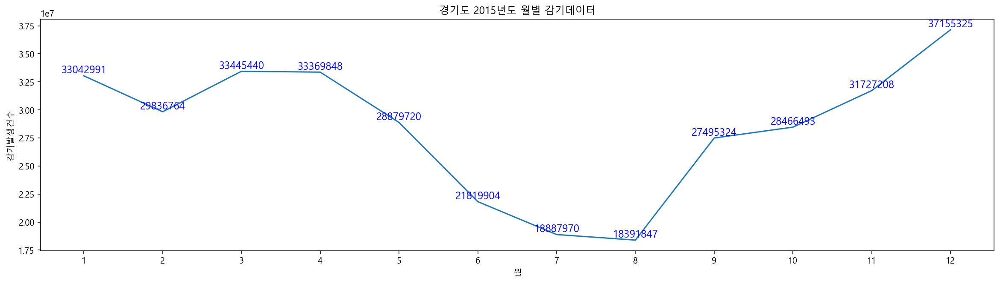

In [84]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2015년도 월별 감기데이터")
sns.lineplot(data=df_gyunggi_2015, x="월", y="감기발생건수")
for i, v in enumerate(df_gyunggi_2015["월"]):
    plt.text(v, (df_gyunggi_2015["감기발생건수"])[i], (df_gyunggi_2015["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

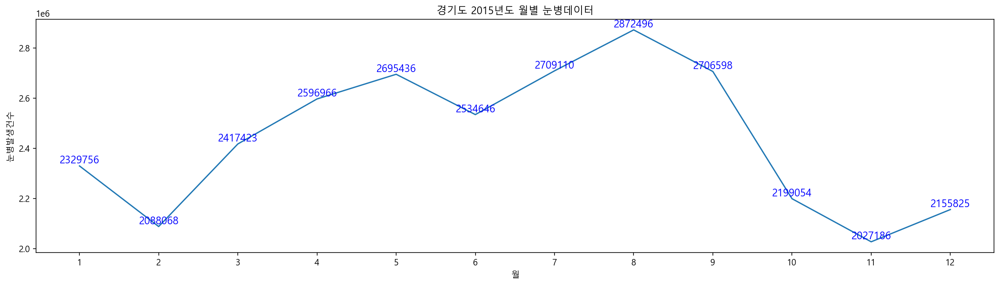

In [85]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2015년도 월별 눈병데이터")
sns.lineplot(data=df_gyunggi_2015, x="월", y="눈병발생건수")
for i, v in enumerate(df_gyunggi_2015["월"]):
    plt.text(v, (df_gyunggi_2015["눈병발생건수"])[i], (df_gyunggi_2015["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

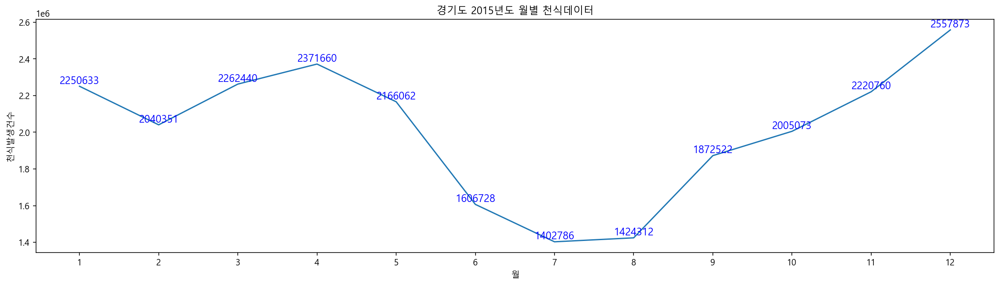

In [86]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2015년도 월별 천식데이터")
sns.lineplot(data=df_gyunggi_2015, x="월", y="천식발생건수")
for i, v in enumerate(df_gyunggi_2015["월"]):
    plt.text(v, (df_gyunggi_2015["천식발생건수"])[i], (df_gyunggi_2015["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

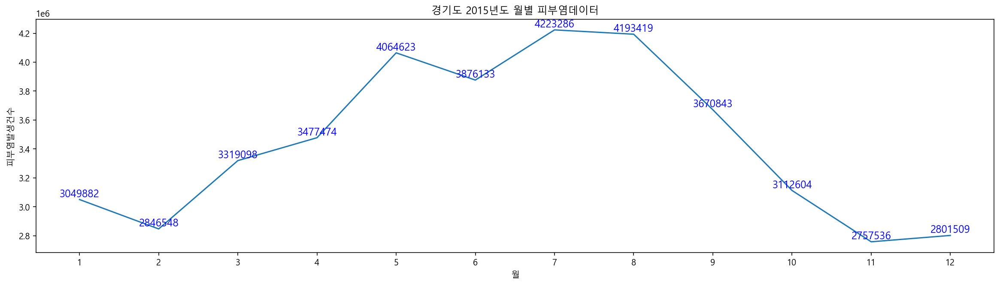

In [87]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2015년도 월별 피부염데이터")
sns.lineplot(data=df_gyunggi_2015, x="월", y="피부염발생건수")
for i, v in enumerate(df_gyunggi_2015["월"]):
    plt.text(v, (df_gyunggi_2015["피부염발생건수"])[i], (df_gyunggi_2015["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 경기도 2016년도 데이터

In [88]:
df_gyunggi_2016 = df[(df["시도명"] == "경기도") | (df["연도"] == "2016")]
df_gyunggi_2016 = df_gyunggi_2016.drop(["연도별 월"], axis=1).copy()
df_gyunggi_2016["연도"] = df_gyunggi_2016["연도"].astype("str")
df_gyunggi_2016 = df_gyunggi_2016.groupby("월").sum()
df_gyunggi_2016 = df_gyunggi_2016.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_gyunggi_2016 = df_gyunggi_2016.reset_index()

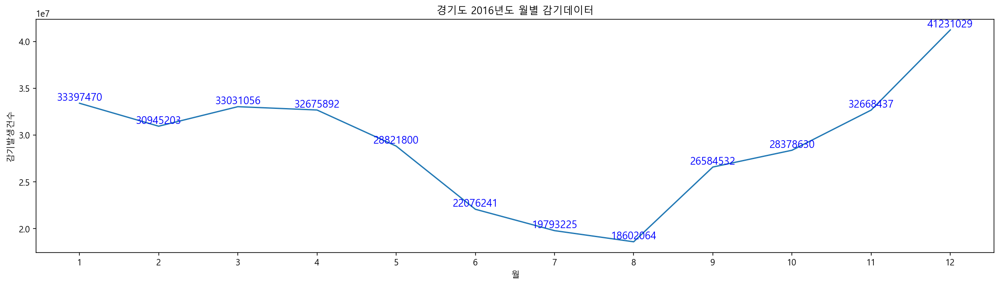

In [89]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2016년도 월별 감기데이터")
sns.lineplot(data=df_gyunggi_2016, x="월", y="감기발생건수")
for i, v in enumerate(df_gyunggi_2016["월"]):
    plt.text(v, (df_gyunggi_2016["감기발생건수"])[i], (df_gyunggi_2016["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

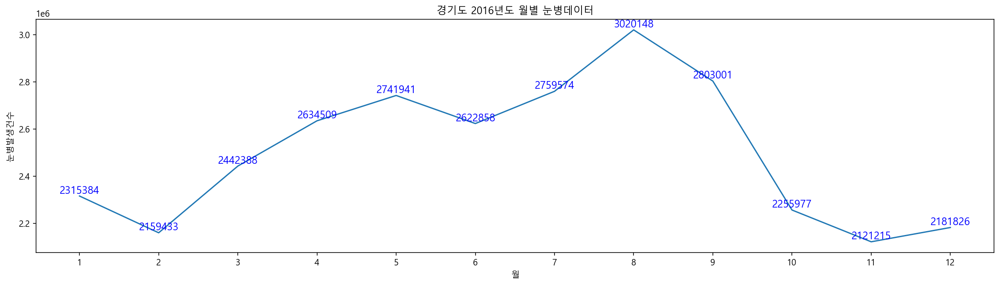

In [90]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2016년도 월별 눈병데이터")
sns.lineplot(data=df_gyunggi_2016, x="월", y="눈병발생건수")
for i, v in enumerate(df_gyunggi_2016["월"]):
    plt.text(v, (df_gyunggi_2016["눈병발생건수"])[i], (df_gyunggi_2016["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

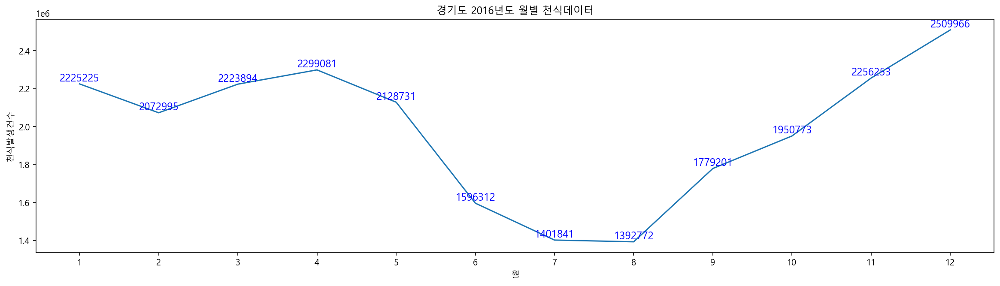

In [91]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2016년도 월별 천식데이터")
sns.lineplot(data=df_gyunggi_2016, x="월", y="천식발생건수")
for i, v in enumerate(df_gyunggi_2016["월"]):
    plt.text(v, (df_gyunggi_2016["천식발생건수"])[i], (df_gyunggi_2016["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

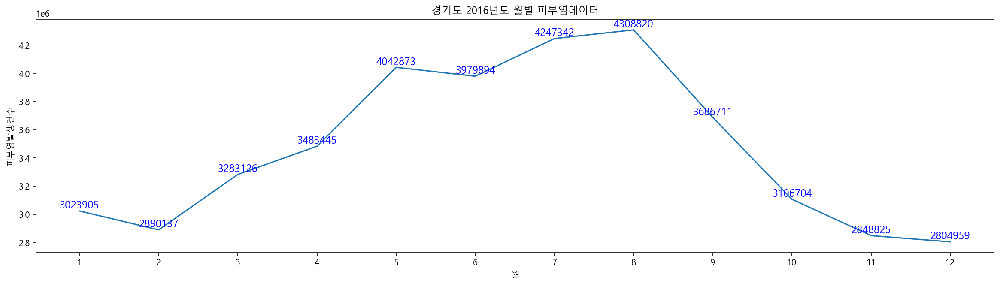

In [92]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2016년도 월별 피부염데이터")
sns.lineplot(data=df_gyunggi_2016, x="월", y="피부염발생건수")
for i, v in enumerate(df_gyunggi_2016["월"]):
    plt.text(v, (df_gyunggi_2016["피부염발생건수"])[i], (df_gyunggi_2016["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 경기도 2017년도 데이터

In [93]:
df_gyunggi_2017 = df[(df["시도명"] == "경기도") | (df["연도"] == "2017")]
df_gyunggi_2017 = df_gyunggi_2017.drop(["연도별 월"], axis=1).copy()
df_gyunggi_2017["연도"] = df_gyunggi_2017["연도"].astype("str")
df_gyunggi_2017 = df_gyunggi_2017.groupby("월").sum()
df_gyunggi_2017 = df_gyunggi_2017.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_gyunggi_2017 = df_gyunggi_2017.reset_index()

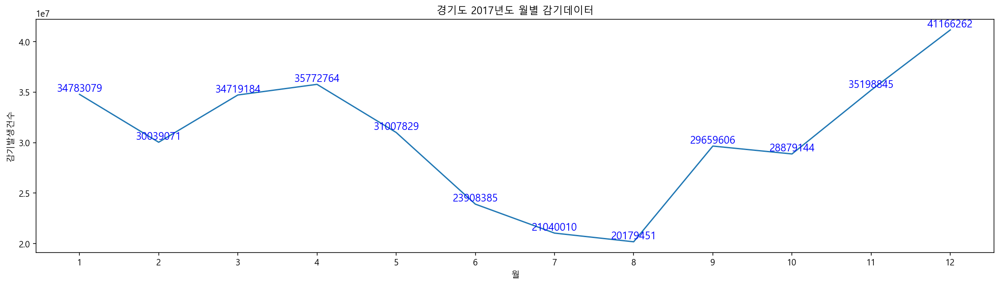

In [94]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2017년도 월별 감기데이터")
sns.lineplot(data=df_gyunggi_2017, x="월", y="감기발생건수")
for i, v in enumerate(df_gyunggi_2017["월"]):
    plt.text(v, (df_gyunggi_2017["감기발생건수"])[i], (df_gyunggi_2017["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')

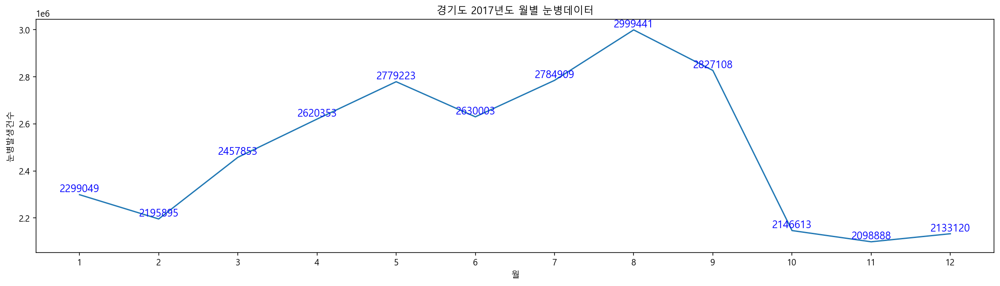

In [95]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2017년도 월별 눈병데이터")
sns.lineplot(data=df_gyunggi_2017, x="월", y="눈병발생건수")
for i, v in enumerate(df_gyunggi_2017["월"]):
    plt.text(v, (df_gyunggi_2017["눈병발생건수"])[i], (df_gyunggi_2017["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')

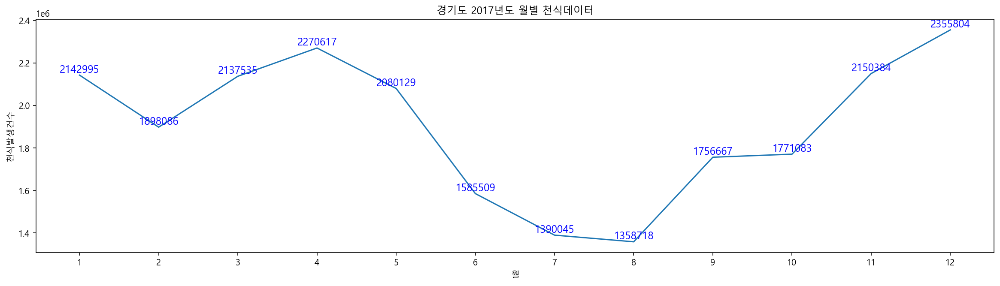

In [96]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2017년도 월별 천식데이터")
sns.lineplot(data=df_gyunggi_2017, x="월", y="천식발생건수")
for i, v in enumerate(df_gyunggi_2017["월"]):
    plt.text(v, (df_gyunggi_2017["천식발생건수"])[i], (df_gyunggi_2017["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')

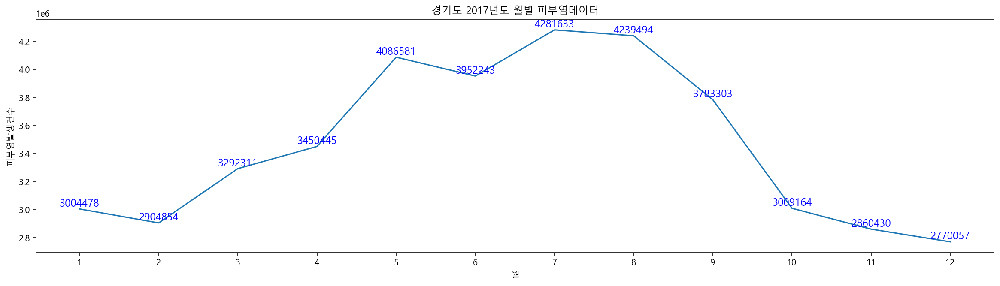

In [97]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2017년도 월별 피부염데이터")
sns.lineplot(data=df_gyunggi_2017, x="월", y="피부염발생건수")
for i, v in enumerate(df_gyunggi_2017["월"]):
    plt.text(v, (df_gyunggi_2017["피부염발생건수"])[i], (df_gyunggi_2017["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')

## 경기도 2018년도 데이터

In [98]:
df_gyunggi_2018 = df[(df["시도명"] == "경기도") | (df["연도"] == "2018")]
df_gyunggi_2018 = df_gyunggi_2018.drop(["연도별 월"], axis=1).copy()
df_gyunggi_2018["연도"] = df_gyunggi_2018["연도"].astype("str")
df_gyunggi_2018 = df_gyunggi_2018.groupby("월").sum()
df_gyunggi_2018 = df_gyunggi_2018.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_gyunggi_2018 = df_gyunggi_2018.reset_index()

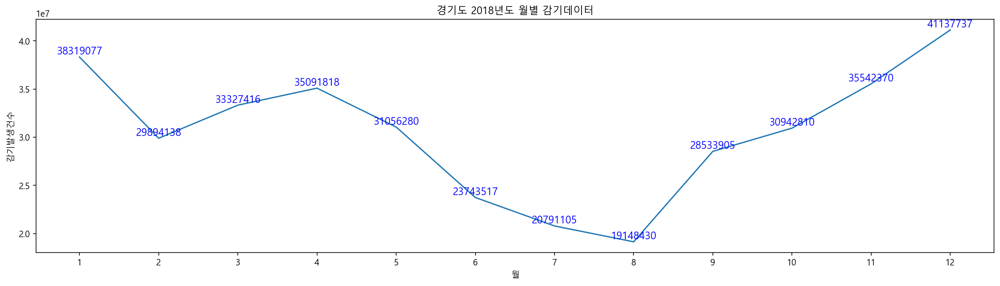

In [99]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2018년도 월별 감기데이터")
sns.lineplot(data=df_gyunggi_2018, x="월", y="감기발생건수")
for i, v in enumerate(df_gyunggi_2018["월"]):
    plt.text(v, (df_gyunggi_2018["감기발생건수"])[i], (df_gyunggi_2018["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

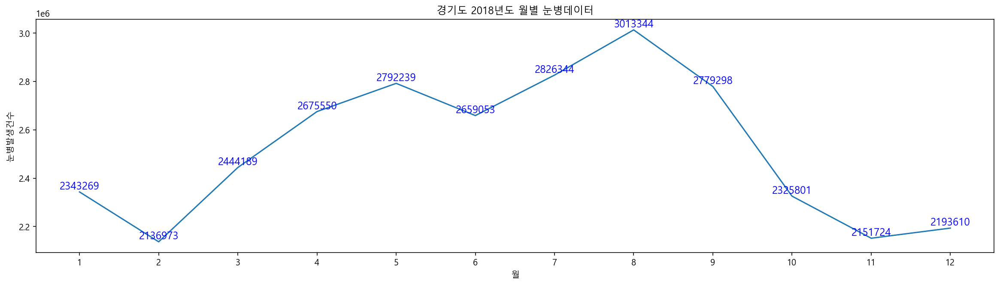

In [100]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2018년도 월별 눈병데이터")
sns.lineplot(data=df_gyunggi_2018, x="월", y="눈병발생건수")
for i, v in enumerate(df_gyunggi_2018["월"]):
    plt.text(v, (df_gyunggi_2018["눈병발생건수"])[i], (df_gyunggi_2018["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

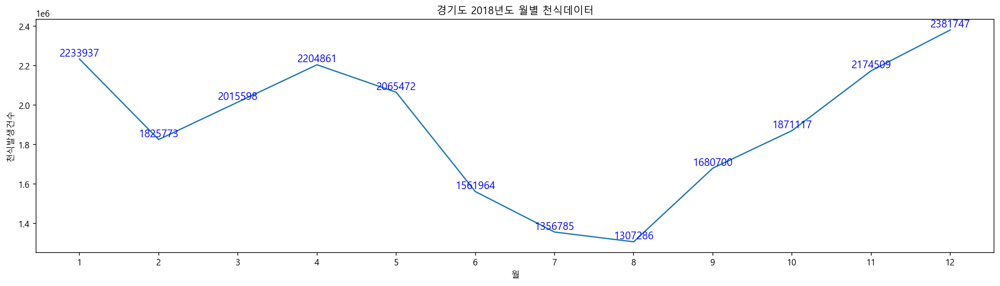

In [101]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2018년도 월별 천식데이터")
sns.lineplot(data=df_gyunggi_2018, x="월", y="천식발생건수")
for i, v in enumerate(df_gyunggi_2018["월"]):
    plt.text(v, (df_gyunggi_2018["천식발생건수"])[i], (df_gyunggi_2018["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

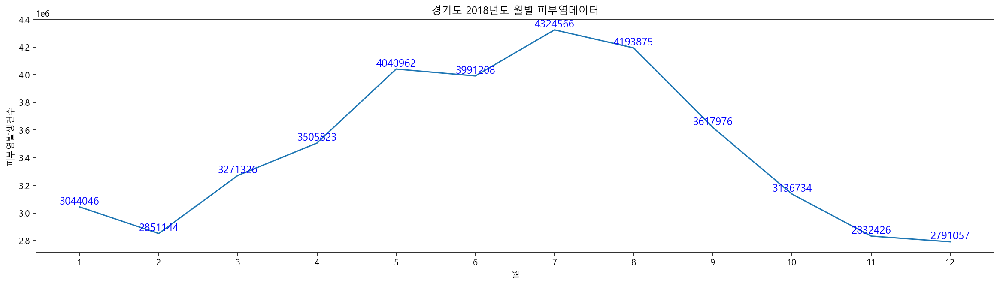

In [102]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2018년도 월별 피부염데이터")
sns.lineplot(data=df_gyunggi_2018, x="월", y="피부염발생건수")
for i, v in enumerate(df_gyunggi_2018["월"]):
    plt.text(v, (df_gyunggi_2018["피부염발생건수"])[i], (df_gyunggi_2018["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 경기도 2019년도 데이터

In [103]:
df_gyunggi_2019 = df[(df["시도명"] == "경기도") | (df["연도"] == "2019")]
df_gyunggi_2019 = df_gyunggi_2019.drop(["연도별 월"], axis=1).copy()
df_gyunggi_2019["연도"] = df_gyunggi_2019["연도"].astype("str")
df_gyunggi_2019 = df_gyunggi_2019.groupby("월").sum()
df_gyunggi_2019 = df_gyunggi_2019.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_gyunggi_2019 = df_gyunggi_2019.reset_index()

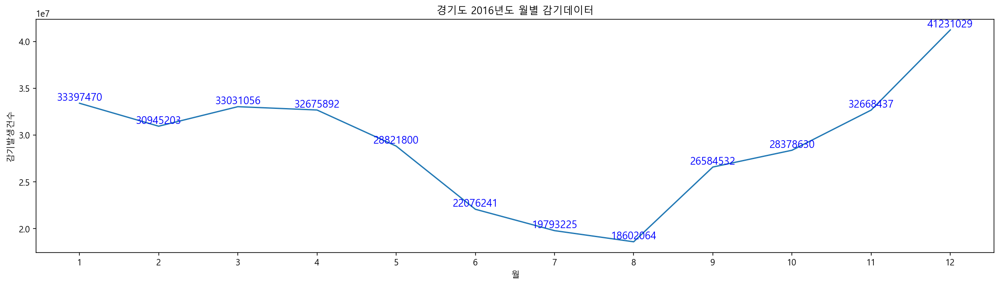

In [104]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2019년도 월별 감기데이터")
sns.lineplot(data=df_gyunggi_2019, x="월", y="감기발생건수")
for i, v in enumerate(df_gyunggi_2019["월"]):
    plt.text(v, (df_gyunggi_2019["감기발생건수"])[i], (df_gyunggi_2019["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

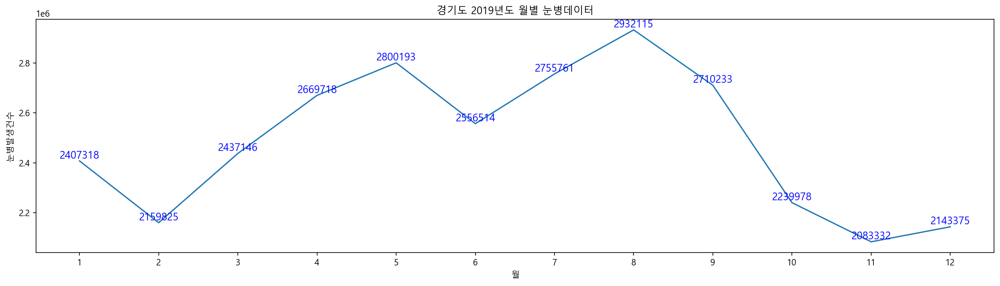

In [110]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2019년도 월별 눈병데이터")
sns.lineplot(data=df_gyunggi_2019, x="월", y="눈병발생건수")
for i, v in enumerate(df_gyunggi_2019["월"]):
    plt.text(v, (df_gyunggi_2019["눈병발생건수"])[i], (df_gyunggi_2019["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

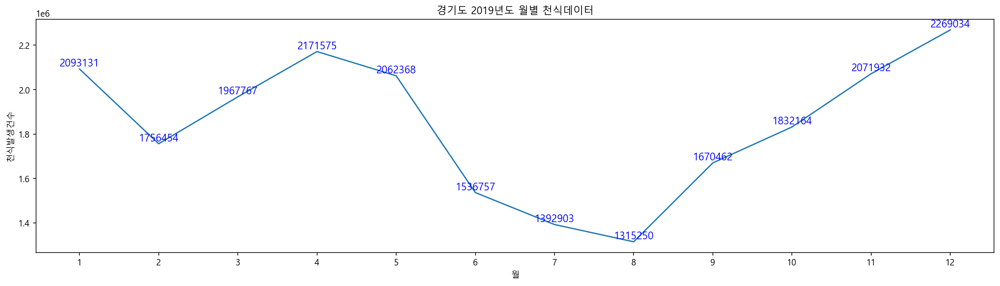

In [111]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2019년도 월별 천식데이터")
sns.lineplot(data=df_gyunggi_2019, x="월", y="천식발생건수")
for i, v in enumerate(df_gyunggi_2019["월"]):
    plt.text(v, (df_gyunggi_2019["천식발생건수"])[i], (df_gyunggi_2019["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

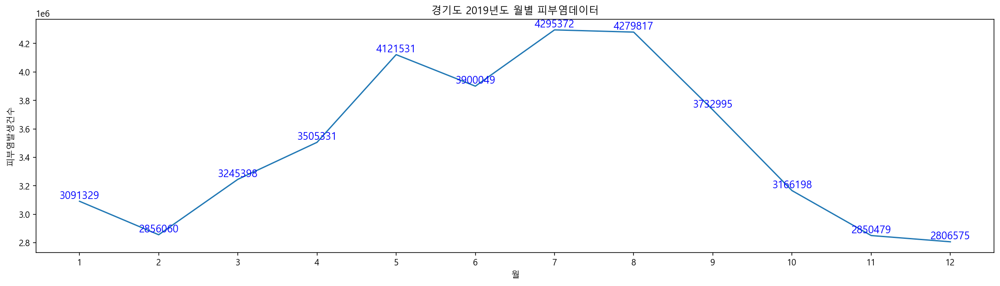

In [112]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2019년도 월별 피부염데이터")
sns.lineplot(data=df_gyunggi_2019, x="월", y="피부염발생건수")
for i, v in enumerate(df_gyunggi_2019["월"]):
    plt.text(v, (df_gyunggi_2019["피부염발생건수"])[i], (df_gyunggi_2019["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 경기도 2020년도 데이터

In [105]:
df_gyunggi_2020 = df[(df["시도명"] == "경기도") | (df["연도"] == "2020")]
df_gyunggi_2020 = df_gyunggi_2020.drop(["연도별 월"], axis=1).copy()
df_gyunggi_2020["연도"] = df_gyunggi_2020["연도"].astype("str")
df_gyunggi_2020 = df_gyunggi_2020.groupby("월").sum()
df_gyunggi_2020 = df_gyunggi_2020.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9"])
df_gyunggi_2020 = df_gyunggi_2020.reset_index()

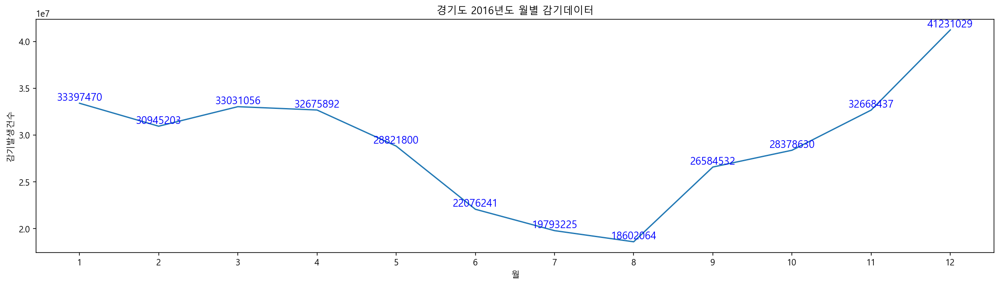

In [106]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2020년도 월별 감기데이터")
sns.lineplot(data=df_gyunggi_2020, x="월", y="감기발생건수")
for i, v in enumerate(df_gyunggi_2020["월"]):
    plt.text(v, (df_gyunggi_2020["감기발생건수"])[i], (df_gyunggi_2020["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

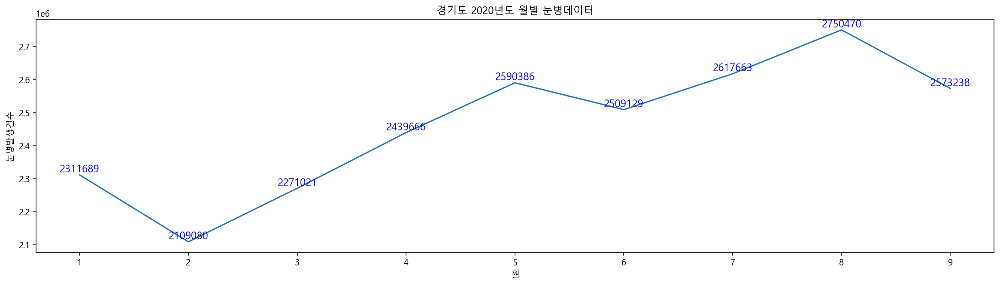

In [107]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2020년도 월별 눈병데이터")
sns.lineplot(data=df_gyunggi_2020, x="월", y="눈병발생건수")
for i, v in enumerate(df_gyunggi_2020["월"]):
    plt.text(v, (df_gyunggi_2020["눈병발생건수"])[i], (df_gyunggi_2020["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

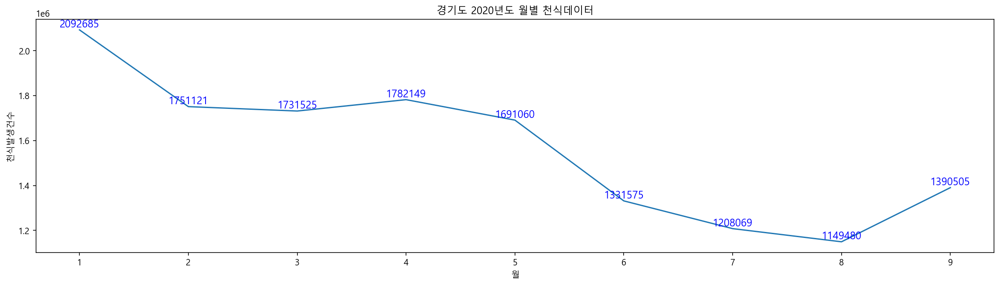

In [108]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2020년도 월별 천식데이터")
sns.lineplot(data=df_gyunggi_2020, x="월", y="천식발생건수")
for i, v in enumerate(df_gyunggi_2020["월"]):
    plt.text(v, (df_gyunggi_2020["천식발생건수"])[i], (df_gyunggi_2020["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

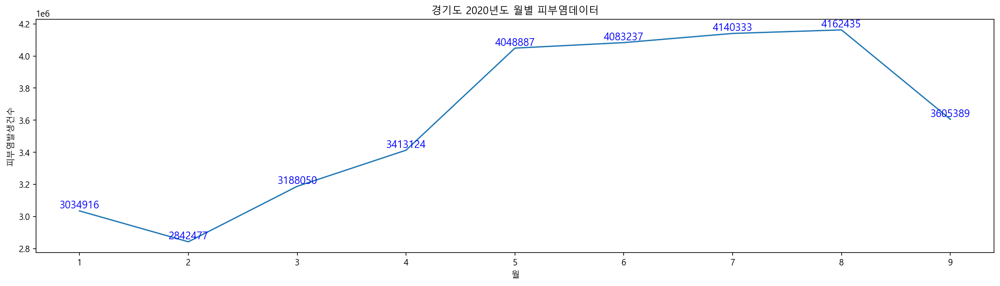

In [109]:
plt.figure(figsize=(20, 5))
plt.title("경기도 2020년도 월별 피부염데이터")
sns.lineplot(data=df_gyunggi_2020, x="월", y="피부염발생건수")
for i, v in enumerate(df_gyunggi_2020["월"]):
    plt.text(v, (df_gyunggi_2020["피부염발생건수"])[i], (df_gyunggi_2020["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

# 부산광역시 데이터

## 부산 전체 데이터

In [113]:
df_busan_fool = df[df["시도명"] == "부산광역시"]
df_busan_fool = df_busan_fool.groupby("연도별 월").sum().copy()
df_busan_fool = df_busan_fool.reindex(index=["2014-1", "2014-2", "2014-3", "2014-4", "2014-5", "2014-6", "2014-7", "2014-8", "2014-9"
                                  , "2014-10", "2014-11", "2014-12", "2015-1", "2015-2", "2015-3", "2015-4", "2015-5"
                                  , "2015-6", "2015-7", "2015-8", "2015-9", "2015-10", "2015-11", "2015-12", "2016-1"
                                  , "2016-2", "2016-3", "2016-4", "2016-5", "2016-6", "2016-7", "2016-8", "2016-9"
                                  , "2016-10", "2016-11", "2016-12", "2017-1", "2017-2", "2017-3", "2017-4", "2017-5"
                                  , "2017-6", "2017-7", "2017-8", "2017-9", "2017-10", "2017-11", "2017-12", "2018-1"
                                  , "2018-2", "2018-3", "2018-4", "2018-5", "2018-6", "2018-7", "2018-8", "2018-9"
                                  , "2018-10", "2018-11", "2018-12", "2019-1", "2019-2", "2019-3", "2019-4", "2019-5"
                                  , "2019-6", "2019-7", "2019-8", "2019-9", "2019-10", "2019-11", "2019-12", "2020-1"
                                  , "2020-2", "2020-3", "2020-4", "2020-5", "2020-6", "2020-7", "2020-8", "2020-9"])
df_busan_fool = df_busan_fool.reset_index()

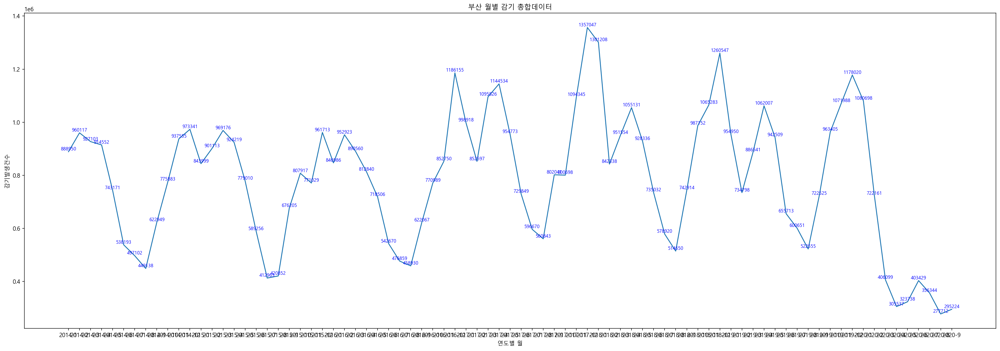

In [114]:
plt.figure(figsize=(30, 10))
plt.title("부산 월별 감기 총합데이터")
sns.lineplot(data=df_busan_fool, x="연도별 월", y="감기발생건수")
for i, v in enumerate(df_busan_fool["연도별 월"]):
    plt.text(v, (df_busan_fool["감기발생건수"])[i], (df_busan_fool["감기발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

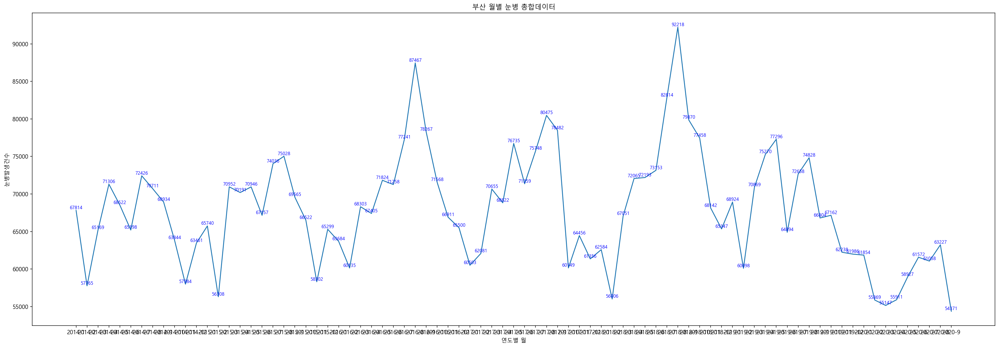

In [115]:
plt.figure(figsize=(30, 10))
plt.title("부산 월별 눈병 총합데이터")
sns.lineplot(data=df_busan_fool, x="연도별 월", y="눈병발생건수")
for i, v in enumerate(df_busan_fool["연도별 월"]):
    plt.text(v, (df_busan_fool["눈병발생건수"])[i], (df_busan_fool["눈병발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

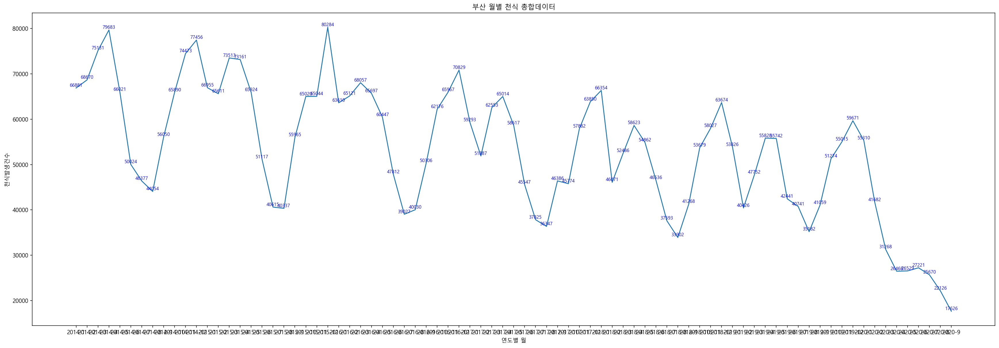

In [116]:
plt.figure(figsize=(30, 10))
plt.title("부산 월별 천식 총합데이터")
sns.lineplot(data=df_busan_fool, x="연도별 월", y="천식발생건수")
for i, v in enumerate(df_busan_fool["연도별 월"]):
    plt.text(v, (df_busan_fool["천식발생건수"])[i], (df_busan_fool["천식발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

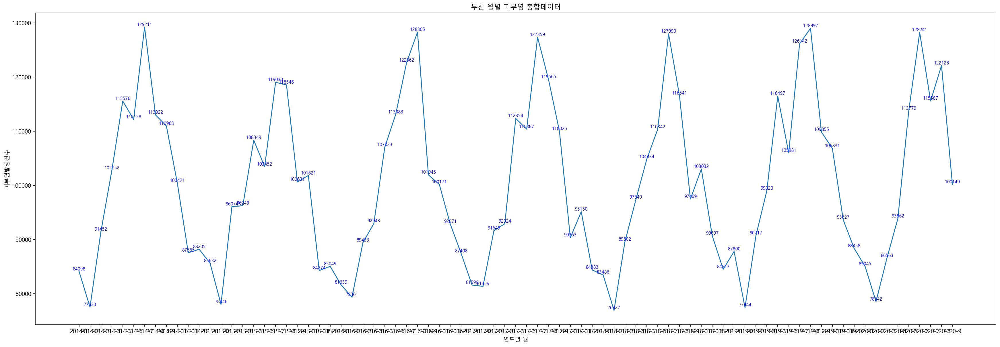

In [117]:
plt.figure(figsize=(30, 10))
plt.title("부산 월별 피부염 총합데이터")
sns.lineplot(data=df_busan_fool, x="연도별 월", y="피부염발생건수")
for i, v in enumerate(df_busan_fool["연도별 월"]):
    plt.text(v, (df_busan_fool["피부염발생건수"])[i], (df_busan_fool["피부염발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

## 부산 2014년도 데이터

In [118]:
df_busan_2014 = df[(df["시도명"] == "부산광역시") | (df["연도"] == "2014")]
df_busan_2014 = df_busan_2014.drop(["연도별 월"], axis=1).copy()
df_busan_2014["연도"] = df_busan_2014["연도"].astype("str")
df_busan_2014 = df_busan_2014.groupby("월").sum()
df_busan_2014 = df_busan_2014.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_busan_2014 = df_busan_2014.reset_index()

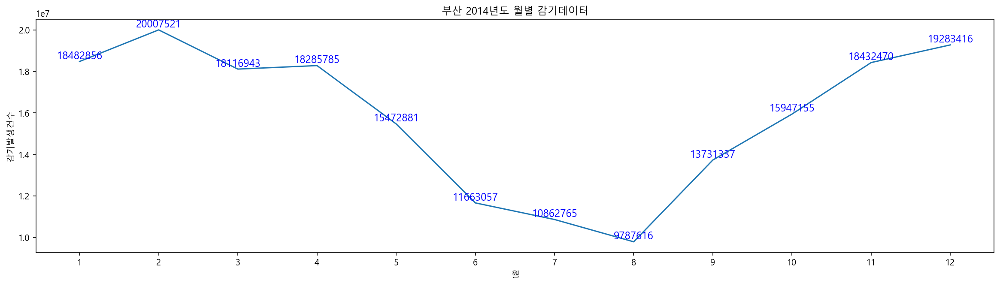

In [119]:
plt.figure(figsize=(20, 5))
plt.title("부산 2014년도 월별 감기데이터")
sns.lineplot(data=df_busan_2014, x="월", y="감기발생건수")
for i, v in enumerate(df_busan_2014["월"]):
    plt.text(v, (df_busan_2014["감기발생건수"])[i], (df_busan_2014["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

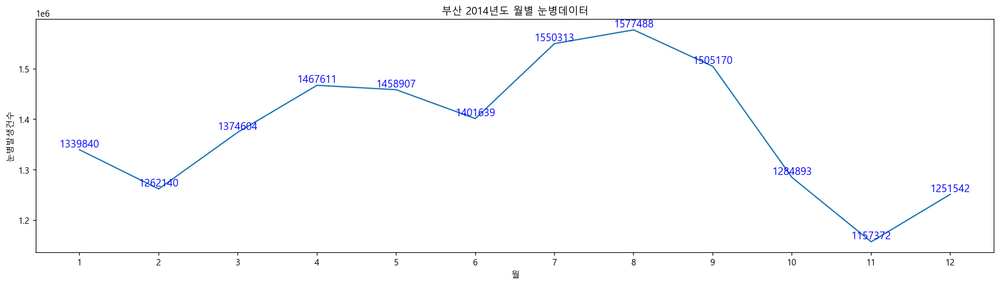

In [120]:
plt.figure(figsize=(20, 5))
plt.title("부산 2014년도 월별 눈병데이터")
sns.lineplot(data=df_busan_2014, x="월", y="눈병발생건수")
for i, v in enumerate(df_busan_2014["월"]):
    plt.text(v, (df_busan_2014["눈병발생건수"])[i], (df_busan_2014["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

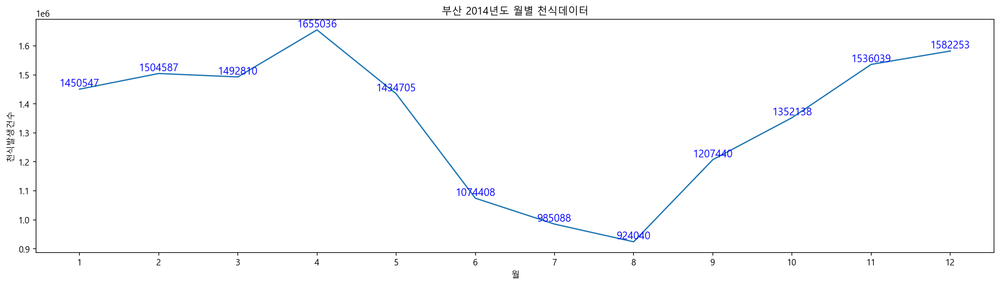

In [121]:
plt.figure(figsize=(20, 5))
plt.title("부산 2014년도 월별 천식데이터")
sns.lineplot(data=df_busan_2014, x="월", y="천식발생건수")
for i, v in enumerate(df_busan_2014["월"]):
    plt.text(v, (df_busan_2014["천식발생건수"])[i], (df_busan_2014["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

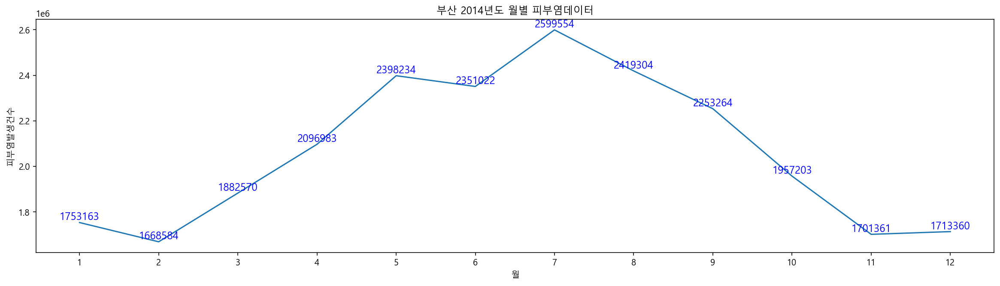

In [122]:
plt.figure(figsize=(20, 5))
plt.title("부산 2014년도 월별 피부염데이터")
sns.lineplot(data=df_busan_2014, x="월", y="피부염발생건수")
for i, v in enumerate(df_busan_2014["월"]):
    plt.text(v, (df_busan_2014["피부염발생건수"])[i], (df_busan_2014["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 부산 2015년도 데이터

In [123]:
df_busan_2015 = df[(df["시도명"] == "부산광역시") | (df["연도"] == "2015")]
df_busan_2015 = df_busan_2015.drop(["연도별 월"], axis=1).copy()
df_busan_2015["연도"] = df_busan_2015["연도"].astype("str")
df_busan_2015 = df_busan_2015.groupby("월").sum()
df_busan_2015 = df_busan_2015.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_busan_2015 = df_busan_2015.reset_index()

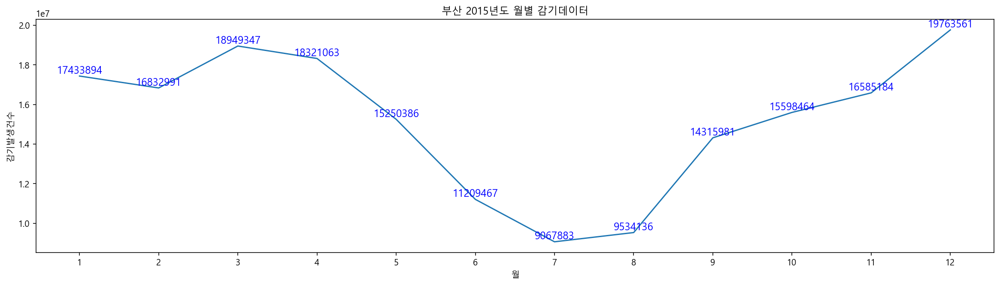

In [129]:
plt.figure(figsize=(20, 5))
plt.title("부산 2015년도 월별 감기데이터")
sns.lineplot(data=df_busan_2015, x="월", y="감기발생건수")
for i, v in enumerate(df_busan_2015["월"]):
    plt.text(v, (df_busan_2015["감기발생건수"])[i], (df_busan_2015["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

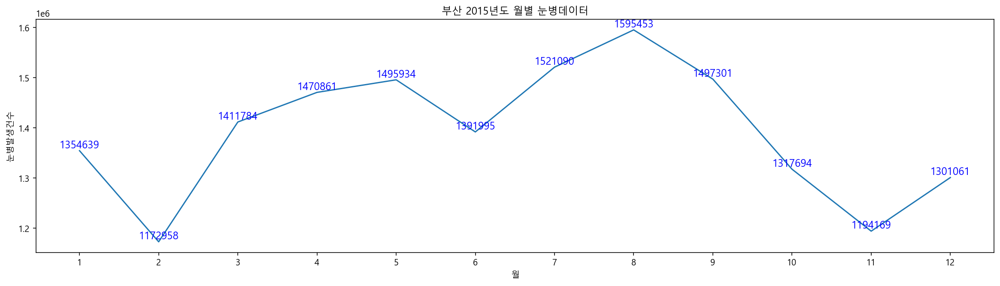

In [130]:
plt.figure(figsize=(20, 5))
plt.title("부산 2015년도 월별 눈병데이터")
sns.lineplot(data=df_busan_2015, x="월", y="눈병발생건수")
for i, v in enumerate(df_busan_2015["월"]):
    plt.text(v, (df_busan_2015["눈병발생건수"])[i], (df_busan_2015["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

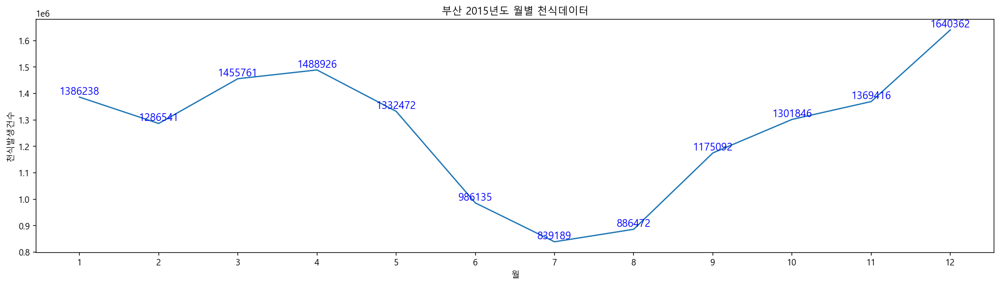

In [131]:
plt.figure(figsize=(20, 5))
plt.title("부산 2015년도 월별 천식데이터")
sns.lineplot(data=df_busan_2015, x="월", y="천식발생건수")
for i, v in enumerate(df_busan_2015["월"]):
    plt.text(v, (df_busan_2015["천식발생건수"])[i], (df_busan_2015["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

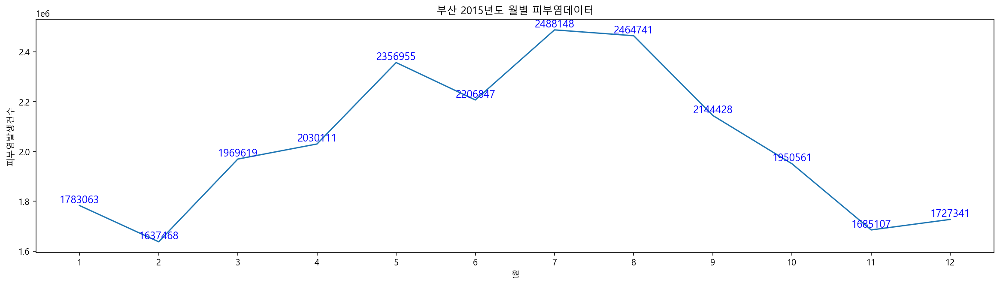

In [132]:
plt.figure(figsize=(20, 5))
plt.title("부산 2015년도 월별 피부염데이터")
sns.lineplot(data=df_busan_2015, x="월", y="피부염발생건수")
for i, v in enumerate(df_busan_2015["월"]):
    plt.text(v, (df_busan_2015["피부염발생건수"])[i], (df_busan_2015["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 부산 2016년도 데이터

In [133]:
df_busan_2016 = df[(df["시도명"] == "부산광역시") | (df["연도"] == "2016")]
df_busan_2016 = df_busan_2016.drop(["연도별 월"], axis=1).copy()
df_busan_2016["연도"] = df_busan_2016["연도"].astype("str")
df_busan_2016 = df_busan_2016.groupby("월").sum()
df_busan_2016 = df_busan_2016.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_busan_2016 = df_busan_2016.reset_index()

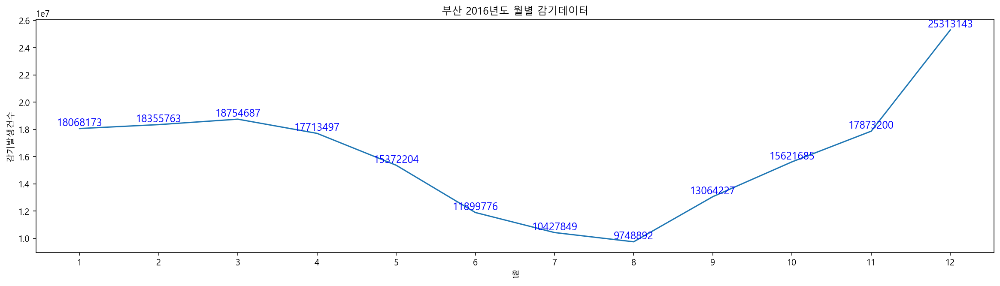

In [134]:
plt.figure(figsize=(20, 5))
plt.title("부산 2016년도 월별 감기데이터")
sns.lineplot(data=df_busan_2016, x="월", y="감기발생건수")
for i, v in enumerate(df_busan_2016["월"]):
    plt.text(v, (df_busan_2016["감기발생건수"])[i], (df_busan_2016["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

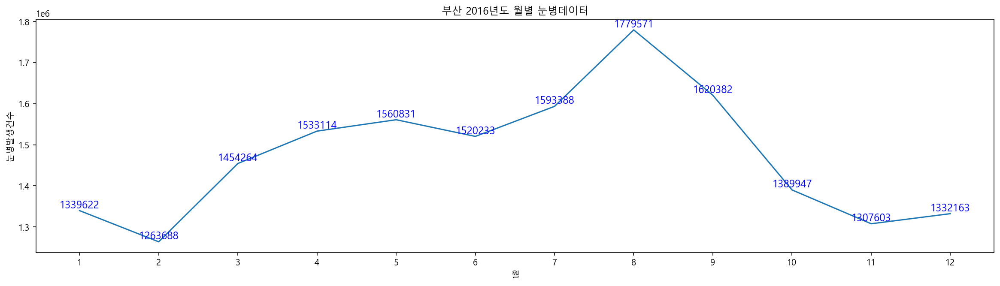

In [135]:
plt.figure(figsize=(20, 5))
plt.title("부산 2016년도 월별 눈병데이터")
sns.lineplot(data=df_busan_2016, x="월", y="눈병발생건수")
for i, v in enumerate(df_busan_2016["월"]):
    plt.text(v, (df_busan_2016["눈병발생건수"])[i], (df_busan_2016["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

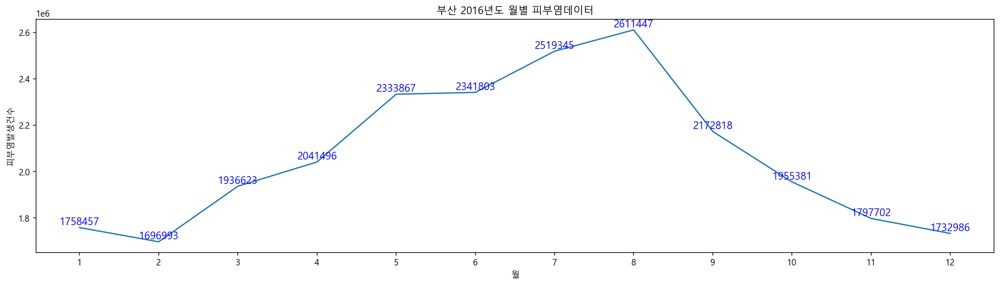

In [136]:
plt.figure(figsize=(20, 5))
plt.title("부산 2016년도 월별 피부염데이터")
sns.lineplot(data=df_busan_2016, x="월", y="피부염발생건수")
for i, v in enumerate(df_busan_2016["월"]):
    plt.text(v, (df_busan_2016["피부염발생건수"])[i], (df_busan_2016["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

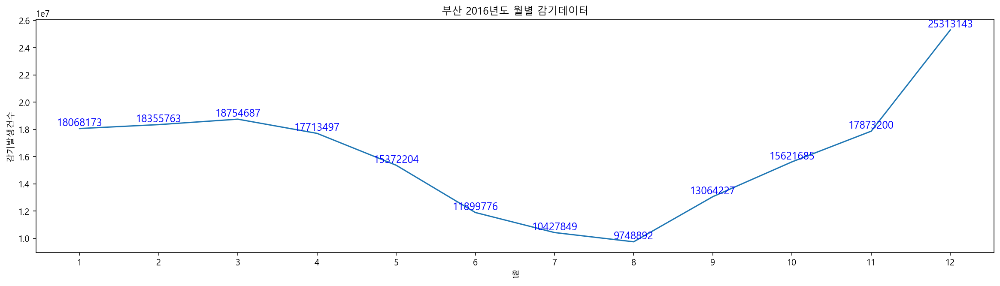

In [137]:
plt.figure(figsize=(20, 5))
plt.title("부산 2016년도 월별 감기데이터")
sns.lineplot(data=df_busan_2016, x="월", y="감기발생건수")
for i, v in enumerate(df_busan_2016["월"]):
    plt.text(v, (df_busan_2016["감기발생건수"])[i], (df_busan_2016["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 부산 2017년도 데이터

In [125]:
df_busan_2017 = df[(df["시도명"] == "부산광역시") | (df["연도"] == "2017")]
df_busan_2017 = df_busan_2017.drop(["연도별 월"], axis=1).copy()
df_busan_2017["연도"] = df_busan_2017["연도"].astype("str")
df_busan_2017 = df_busan_2017.groupby("월").sum()
df_busan_2017 = df_busan_2017.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_busan_2017 = df_busan_2017.reset_index()

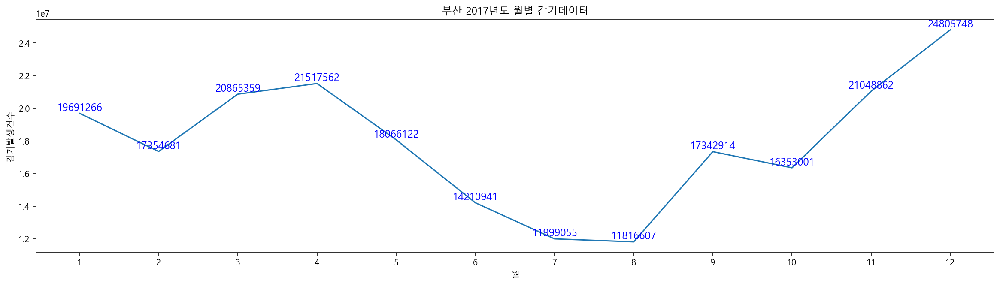

In [138]:
plt.figure(figsize=(20, 5))
plt.title("부산 2017년도 월별 감기데이터")
sns.lineplot(data=df_busan_2017, x="월", y="감기발생건수")
for i, v in enumerate(df_busan_2017["월"]):
    plt.text(v, (df_busan_2017["감기발생건수"])[i], (df_busan_2017["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

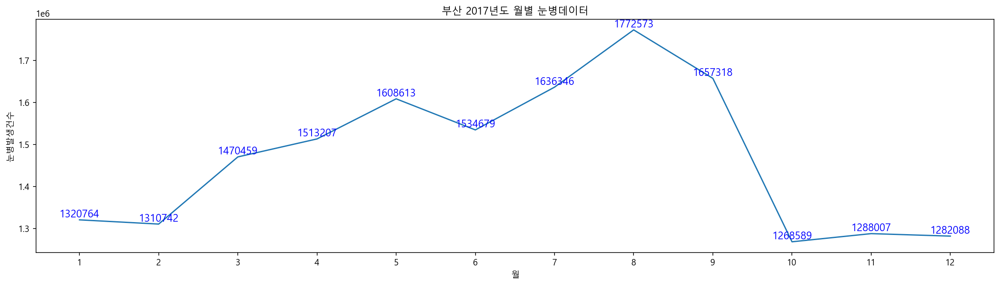

In [139]:
plt.figure(figsize=(20, 5))
plt.title("부산 2017년도 월별 눈병데이터")
sns.lineplot(data=df_busan_2017, x="월", y="눈병발생건수")
for i, v in enumerate(df_busan_2017["월"]):
    plt.text(v, (df_busan_2017["눈병발생건수"])[i], (df_busan_2017["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

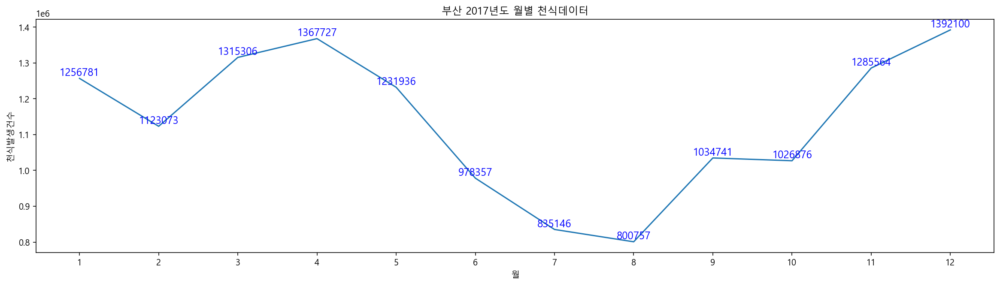

In [140]:
plt.figure(figsize=(20, 5))
plt.title("부산 2017년도 월별 천식데이터")
sns.lineplot(data=df_busan_2017, x="월", y="천식발생건수")
for i, v in enumerate(df_busan_2017["월"]):
    plt.text(v, (df_busan_2017["천식발생건수"])[i], (df_busan_2017["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

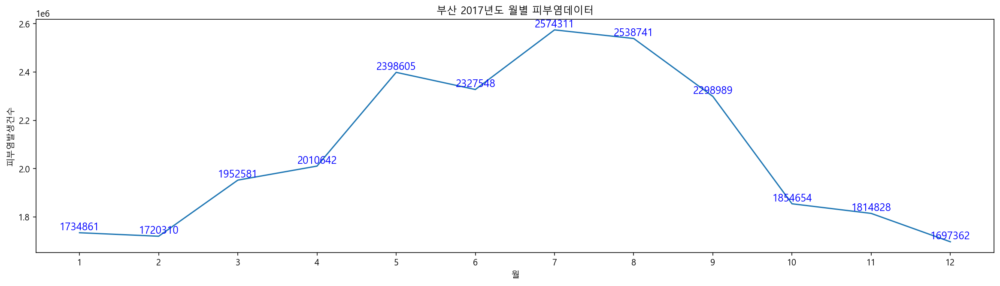

In [141]:
plt.figure(figsize=(20, 5))
plt.title("부산 2017년도 월별 피부염데이터")
sns.lineplot(data=df_busan_2017, x="월", y="피부염발생건수")
for i, v in enumerate(df_busan_2017["월"]):
    plt.text(v, (df_busan_2017["피부염발생건수"])[i], (df_busan_2017["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 부산 2018년도 데이터

In [126]:
df_busan_2018 = df[(df["시도명"] == "부산광역시") | (df["연도"] == "2018")]
df_busan_2018 = df_busan_2018.drop(["연도별 월"], axis=1).copy()
df_busan_2018["연도"] = df_busan_2018["연도"].astype("str")
df_busan_2018 = df_busan_2018.groupby("월").sum()
df_busan_2018 = df_busan_2018.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_busan_2018 = df_busan_2018.reset_index()

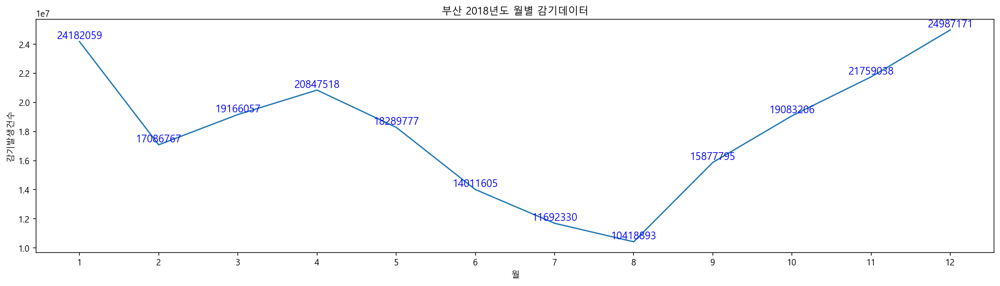

In [142]:
plt.figure(figsize=(20, 5))
plt.title("부산 2018년도 월별 감기데이터")
sns.lineplot(data=df_busan_2018, x="월", y="감기발생건수")
for i, v in enumerate(df_busan_2018["월"]):
    plt.text(v, (df_busan_2018["감기발생건수"])[i], (df_busan_2018["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

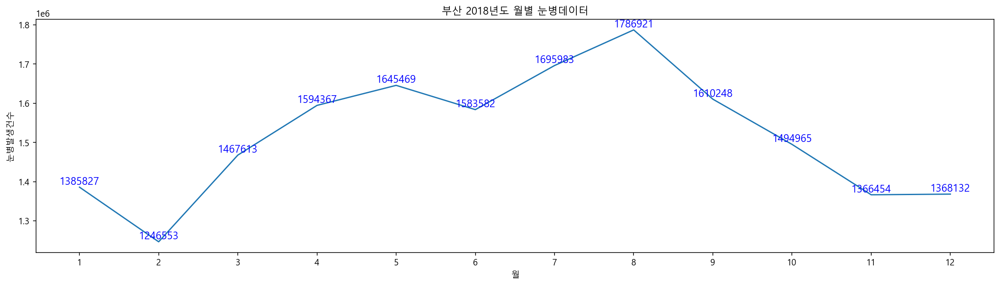

In [143]:
plt.figure(figsize=(20, 5))
plt.title("부산 2018년도 월별 눈병데이터")
sns.lineplot(data=df_busan_2018, x="월", y="눈병발생건수")
for i, v in enumerate(df_busan_2018["월"]):
    plt.text(v, (df_busan_2018["눈병발생건수"])[i], (df_busan_2018["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

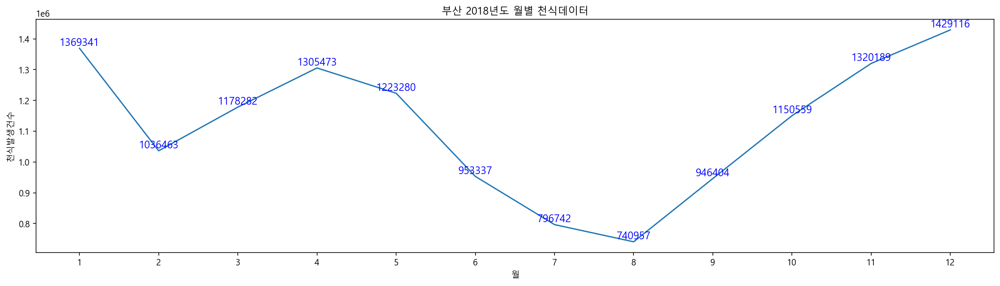

In [144]:
plt.figure(figsize=(20, 5))
plt.title("부산 2018년도 월별 천식데이터")
sns.lineplot(data=df_busan_2018, x="월", y="천식발생건수")
for i, v in enumerate(df_busan_2018["월"]):
    plt.text(v, (df_busan_2018["천식발생건수"])[i], (df_busan_2018["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

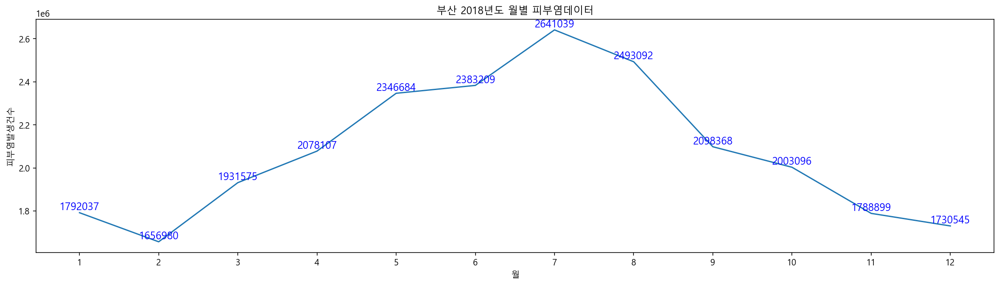

In [145]:
plt.figure(figsize=(20, 5))
plt.title("부산 2018년도 월별 피부염데이터")
sns.lineplot(data=df_busan_2018, x="월", y="피부염발생건수")
for i, v in enumerate(df_busan_2018["월"]):
    plt.text(v, (df_busan_2018["피부염발생건수"])[i], (df_busan_2018["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 부산 2019년도 데이터

In [127]:
df_busan_2019 = df[(df["시도명"] == "부산광역시") | (df["연도"] == "2019")]
df_busan_2019 = df_busan_2019.drop(["연도별 월"], axis=1).copy()
df_busan_2019["연도"] = df_busan_2019["연도"].astype("str")
df_busan_2019 = df_busan_2019.groupby("월").sum()
df_busan_2019 = df_busan_2019.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_busan_2019 = df_busan_2019.reset_index()

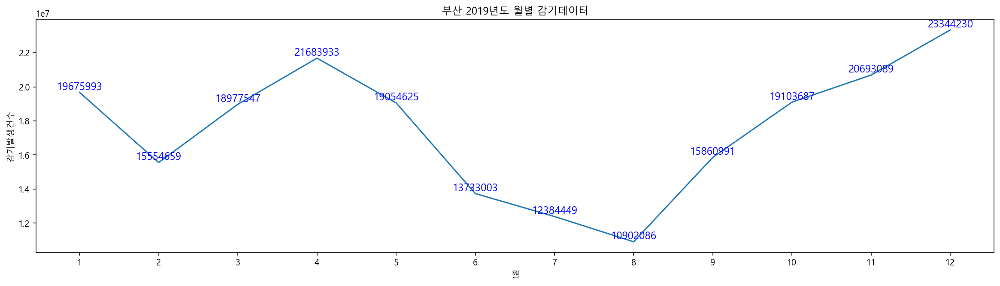

In [146]:
plt.figure(figsize=(20, 5))
plt.title("부산 2019년도 월별 감기데이터")
sns.lineplot(data=df_busan_2019, x="월", y="감기발생건수")
for i, v in enumerate(df_busan_2019["월"]):
    plt.text(v, (df_busan_2019["감기발생건수"])[i], (df_busan_2019["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

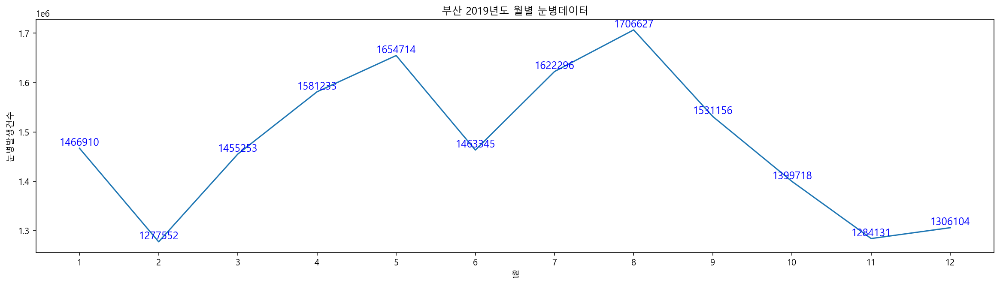

In [147]:
plt.figure(figsize=(20, 5))
plt.title("부산 2019년도 월별 눈병데이터")
sns.lineplot(data=df_busan_2019, x="월", y="눈병발생건수")
for i, v in enumerate(df_busan_2019["월"]):
    plt.text(v, (df_busan_2019["눈병발생건수"])[i], (df_busan_2019["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

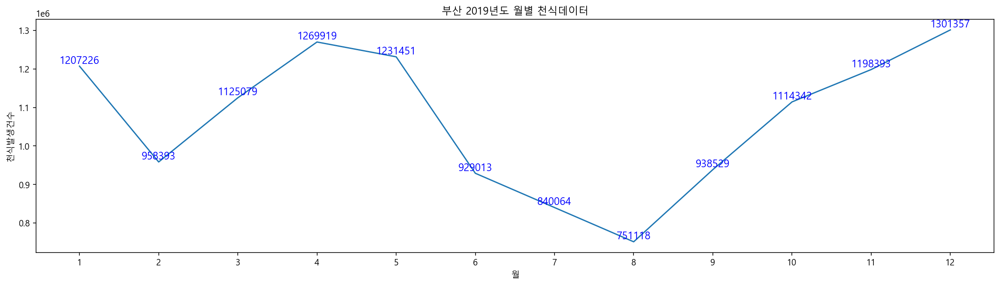

In [148]:
plt.figure(figsize=(20, 5))
plt.title("부산 2019년도 월별 천식데이터")
sns.lineplot(data=df_busan_2019, x="월", y="천식발생건수")
for i, v in enumerate(df_busan_2019["월"]):
    plt.text(v, (df_busan_2019["천식발생건수"])[i], (df_busan_2019["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

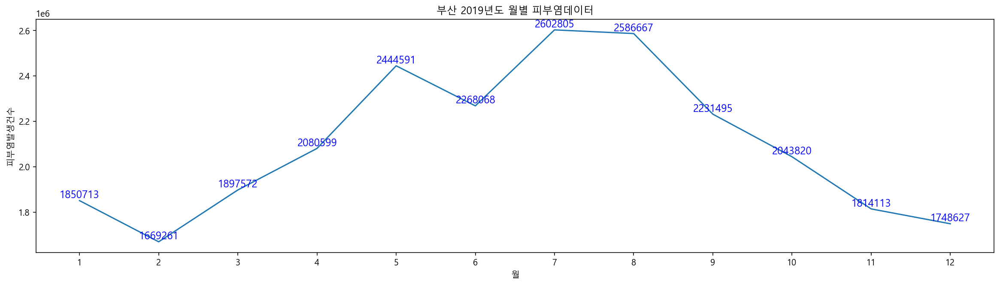

In [149]:
plt.figure(figsize=(20, 5))
plt.title("부산 2019년도 월별 피부염데이터")
sns.lineplot(data=df_busan_2019, x="월", y="피부염발생건수")
for i, v in enumerate(df_busan_2019["월"]):
    plt.text(v, (df_busan_2019["피부염발생건수"])[i], (df_busan_2019["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 부산 2020년도 데이터

In [150]:
df_busan_2020 = df[(df["시도명"] == "부산광역시") | (df["연도"] == "2020")]
df_busan_2020 = df_busan_2020.drop(["연도별 월"], axis=1).copy()
df_busan_2020["연도"] = df_busan_2020["연도"].astype("str")
df_busan_2020 = df_busan_2020.groupby("월").sum()
df_busan_2020 = df_busan_2020.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9"])
df_busan_2020 = df_busan_2020.reset_index()

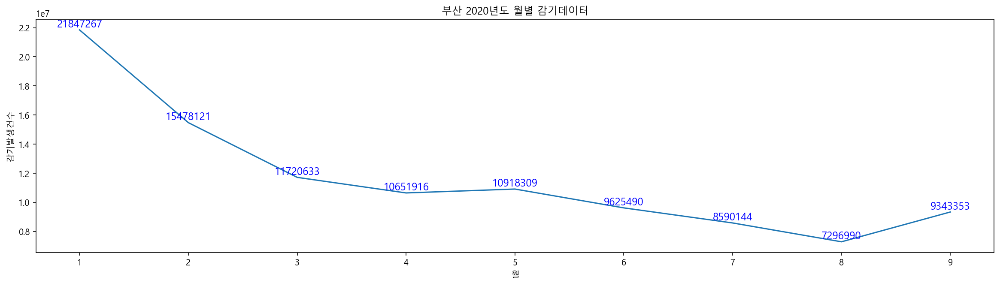

In [151]:
plt.figure(figsize=(20, 5))
plt.title("부산 2020년도 월별 감기데이터")
sns.lineplot(data=df_busan_2020, x="월", y="감기발생건수")
for i, v in enumerate(df_busan_2020["월"]):
    plt.text(v, (df_busan_2020["감기발생건수"])[i], (df_busan_2020["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

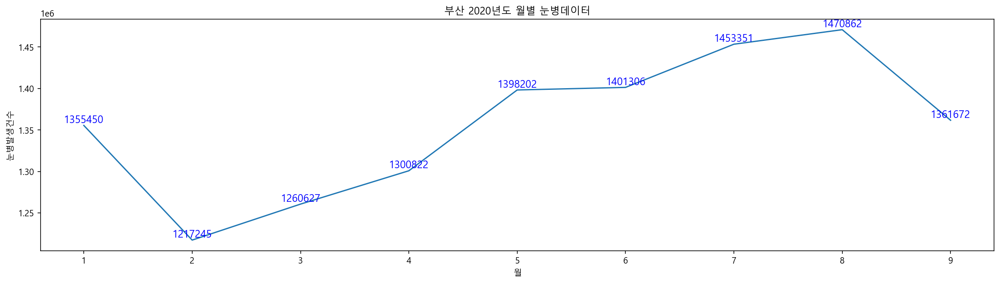

In [152]:
plt.figure(figsize=(20, 5))
plt.title("부산 2020년도 월별 눈병데이터")
sns.lineplot(data=df_busan_2020, x="월", y="눈병발생건수")
for i, v in enumerate(df_busan_2020["월"]):
    plt.text(v, (df_busan_2020["눈병발생건수"])[i], (df_busan_2020["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

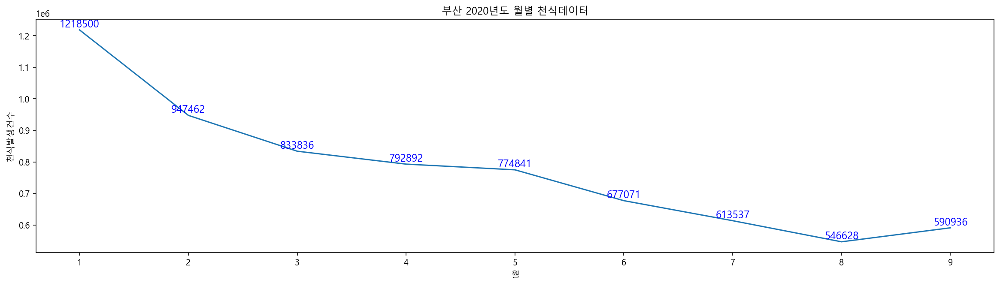

In [153]:
plt.figure(figsize=(20, 5))
plt.title("부산 2020년도 월별 천식데이터")
sns.lineplot(data=df_busan_2020, x="월", y="천식발생건수")
for i, v in enumerate(df_busan_2020["월"]):
    plt.text(v, (df_busan_2020["천식발생건수"])[i], (df_busan_2020["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

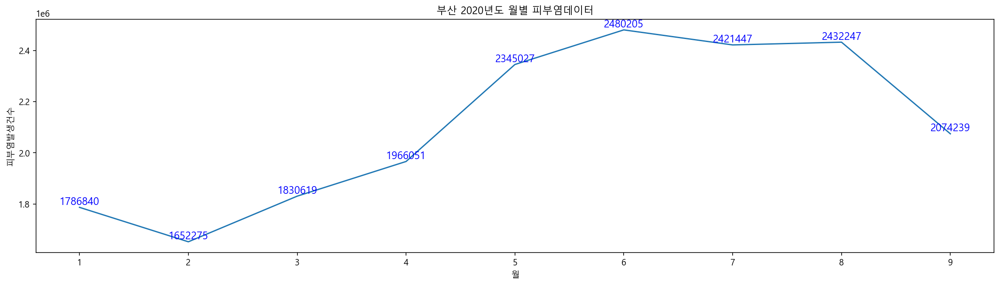

In [154]:
plt.figure(figsize=(20, 5))
plt.title("부산 2020년도 월별 피부염데이터")
sns.lineplot(data=df_busan_2020, x="월", y="피부염발생건수")
for i, v in enumerate(df_busan_2020["월"]):
    plt.text(v, (df_busan_2020["피부염발생건수"])[i], (df_busan_2020["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

# 대구광역시 데이터

## 대구 전체 데이터

In [155]:
df_daegu_fool = df[df["시도명"] == "대구광역시"]
df_daegu_fool = df_daegu_fool.groupby("연도별 월").sum().copy()
df_daegu_fool = df_daegu_fool.reindex(index=["2014-1", "2014-2", "2014-3", "2014-4", "2014-5", "2014-6", "2014-7", "2014-8", "2014-9"
                                  , "2014-10", "2014-11", "2014-12", "2015-1", "2015-2", "2015-3", "2015-4", "2015-5"
                                  , "2015-6", "2015-7", "2015-8", "2015-9", "2015-10", "2015-11", "2015-12", "2016-1"
                                  , "2016-2", "2016-3", "2016-4", "2016-5", "2016-6", "2016-7", "2016-8", "2016-9"
                                  , "2016-10", "2016-11", "2016-12", "2017-1", "2017-2", "2017-3", "2017-4", "2017-5"
                                  , "2017-6", "2017-7", "2017-8", "2017-9", "2017-10", "2017-11", "2017-12", "2018-1"
                                  , "2018-2", "2018-3", "2018-4", "2018-5", "2018-6", "2018-7", "2018-8", "2018-9"
                                  , "2018-10", "2018-11", "2018-12", "2019-1", "2019-2", "2019-3", "2019-4", "2019-5"
                                  , "2019-6", "2019-7", "2019-8", "2019-9", "2019-10", "2019-11", "2019-12", "2020-1"
                                  , "2020-2", "2020-3", "2020-4", "2020-5", "2020-6", "2020-7", "2020-8", "2020-9"])
df_daegu_fool = df_daegu_fool.reset_index()

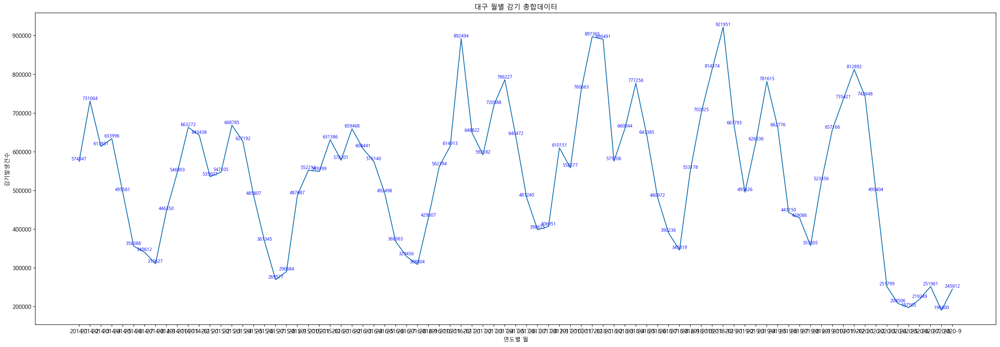

In [168]:
plt.figure(figsize=(30, 10))
plt.title("대구 월별 감기 총합데이터")
sns.lineplot(data=df_daegu_fool, x="연도별 월", y="감기발생건수")
for i, v in enumerate(df_daegu_fool["연도별 월"]):
    plt.text(v, (df_daegu_fool["감기발생건수"])[i], (df_daegu_fool["감기발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

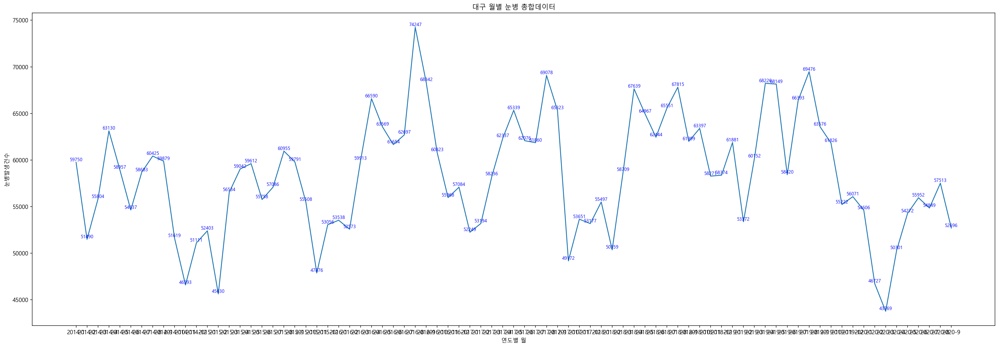

In [169]:
plt.figure(figsize=(30, 10))
plt.title("대구 월별 눈병 총합데이터")
sns.lineplot(data=df_daegu_fool, x="연도별 월", y="눈병발생건수")
for i, v in enumerate(df_daegu_fool["연도별 월"]):
    plt.text(v, (df_daegu_fool["눈병발생건수"])[i], (df_daegu_fool["눈병발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

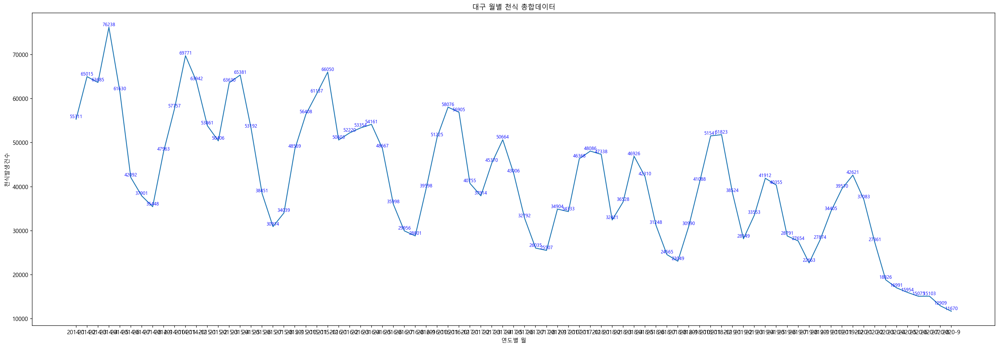

In [170]:
plt.figure(figsize=(30, 10))
plt.title("대구 월별 천식 총합데이터")
sns.lineplot(data=df_daegu_fool, x="연도별 월", y="천식발생건수")
for i, v in enumerate(df_daegu_fool["연도별 월"]):
    plt.text(v, (df_daegu_fool["천식발생건수"])[i], (df_daegu_fool["천식발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

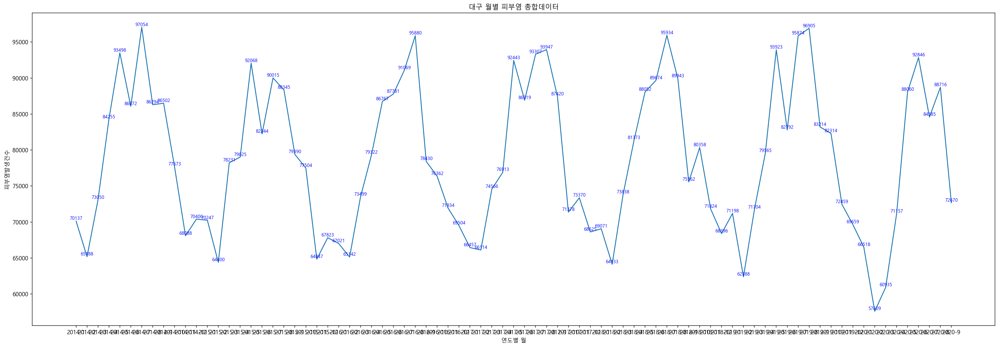

In [171]:
plt.figure(figsize=(30, 10))
plt.title("대구 월별 피부염 총합데이터")
sns.lineplot(data=df_daegu_fool, x="연도별 월", y="피부염발생건수")
for i, v in enumerate(df_daegu_fool["연도별 월"]):
    plt.text(v, (df_daegu_fool["피부염발생건수"])[i], (df_daegu_fool["피부염발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

## 대구 2014년도 데이터

In [161]:
df_daegu_2014 = df[(df["시도명"] == "대구광역시") | (df["연도"] == "2014")]
df_daegu_2014 = df_daegu_2014.drop(["연도별 월"], axis=1).copy()
df_daegu_2014["연도"] = df_daegu_2014["연도"].astype("str")
df_daegu_2014 = df_daegu_2014.groupby("월").sum()
df_daegu_2014 = df_daegu_2014.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_daegu_2014 = df_daegu_2014.reset_index()

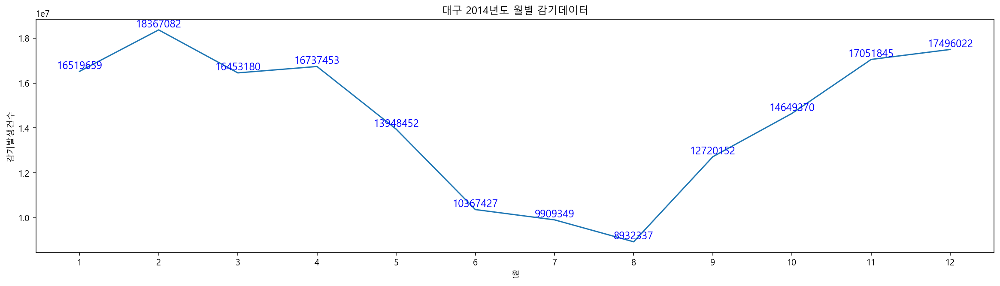

In [172]:
plt.figure(figsize=(20, 5))
plt.title("대구 2014년도 월별 감기데이터")
sns.lineplot(data=df_daegu_2014, x="월", y="감기발생건수")
for i, v in enumerate(df_daegu_2014["월"]):
    plt.text(v, (df_daegu_2014["감기발생건수"])[i], (df_daegu_2014["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

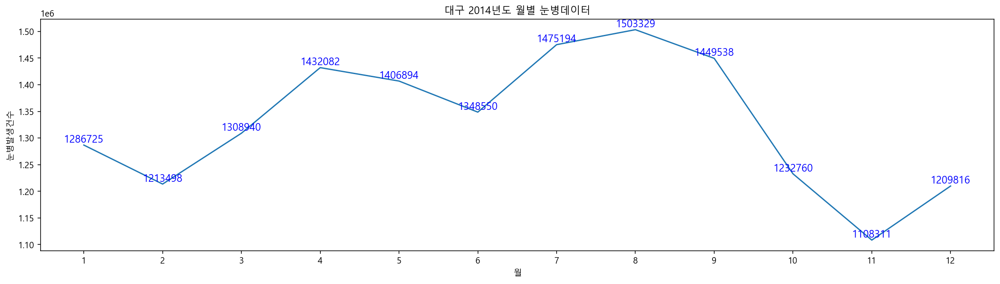

In [173]:
plt.figure(figsize=(20, 5))
plt.title("대구 2014년도 월별 눈병데이터")
sns.lineplot(data=df_daegu_2014, x="월", y="눈병발생건수")
for i, v in enumerate(df_daegu_2014["월"]):
    plt.text(v, (df_daegu_2014["눈병발생건수"])[i], (df_daegu_2014["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

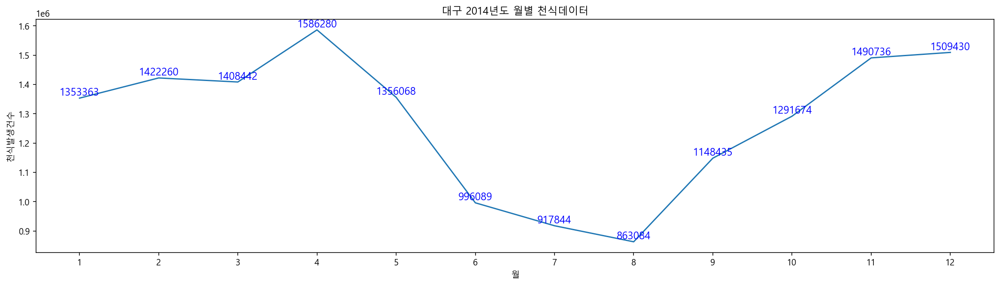

In [174]:
plt.figure(figsize=(20, 5))
plt.title("대구 2014년도 월별 천식데이터")
sns.lineplot(data=df_daegu_2014, x="월", y="천식발생건수")
for i, v in enumerate(df_daegu_2014["월"]):
    plt.text(v, (df_daegu_2014["천식발생건수"])[i], (df_daegu_2014["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

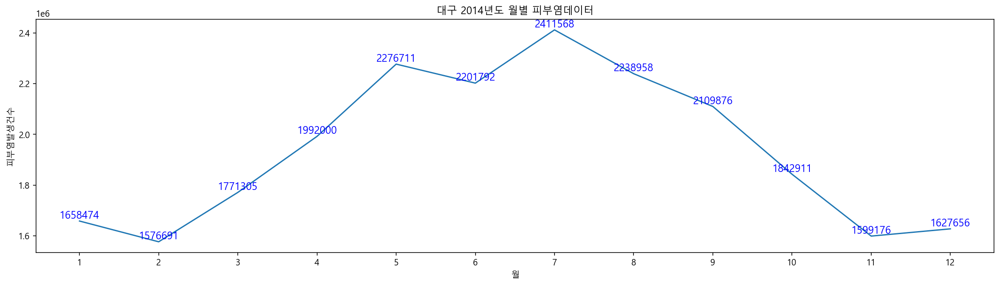

In [175]:
plt.figure(figsize=(20, 5))
plt.title("대구 2014년도 월별 피부염데이터")
sns.lineplot(data=df_daegu_2014, x="월", y="피부염발생건수")
for i, v in enumerate(df_daegu_2014["월"]):
    plt.text(v, (df_daegu_2014["피부염발생건수"])[i], (df_daegu_2014["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 대구 2015년도 데이터

In [162]:
df_daegu_2015 = df[(df["시도명"] == "대구광역시") | (df["연도"] == "2015")]
df_daegu_2015 = df_daegu_2015.drop(["연도별 월"], axis=1).copy()
df_daegu_2015["연도"] = df_daegu_2015["연도"].astype("str")
df_daegu_2015 = df_daegu_2015.groupby("월").sum()
df_daegu_2015 = df_daegu_2015.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_daegu_2015 = df_daegu_2015.reset_index()

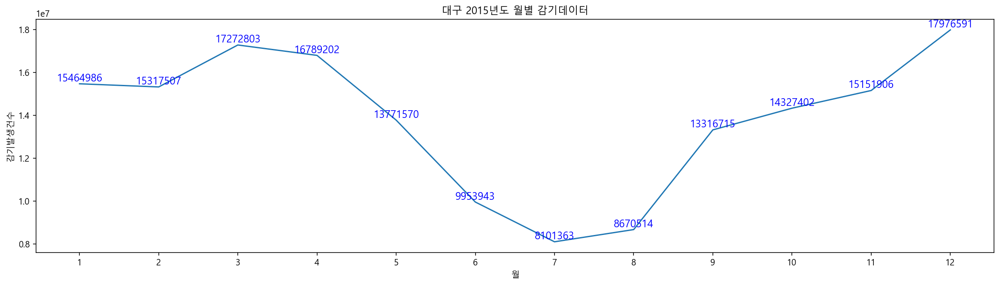

In [176]:
plt.figure(figsize=(20, 5))
plt.title("대구 2015년도 월별 감기데이터")
sns.lineplot(data=df_daegu_2015, x="월", y="감기발생건수")
for i, v in enumerate(df_daegu_2015["월"]):
    plt.text(v, (df_daegu_2015["감기발생건수"])[i], (df_daegu_2015["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

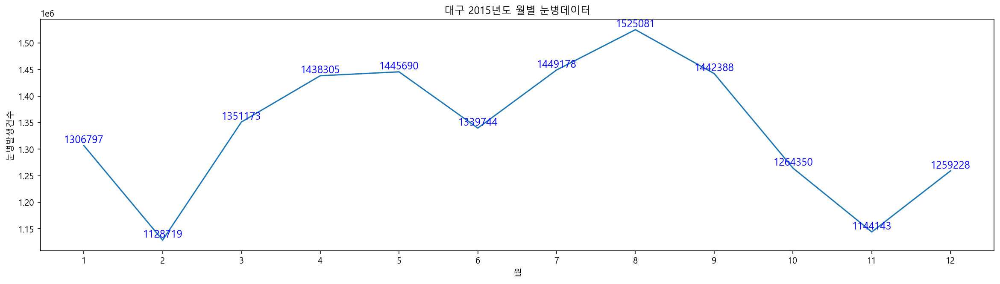

In [177]:
plt.figure(figsize=(20, 5))
plt.title("대구 2015년도 월별 눈병데이터")
sns.lineplot(data=df_daegu_2015, x="월", y="눈병발생건수")
for i, v in enumerate(df_daegu_2015["월"]):
    plt.text(v, (df_daegu_2015["눈병발생건수"])[i], (df_daegu_2015["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

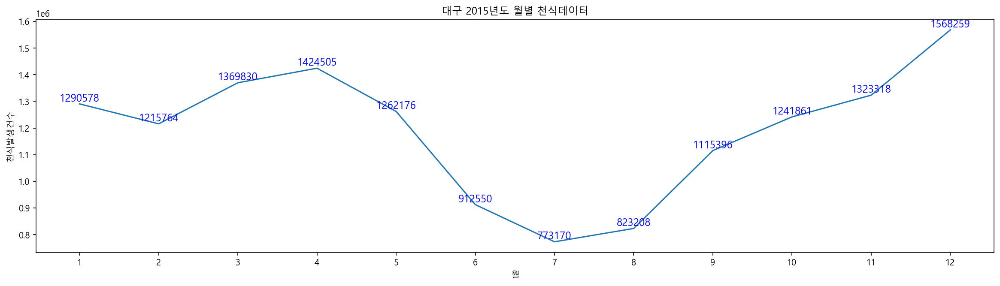

In [178]:
plt.figure(figsize=(20, 5))
plt.title("대구 2015년도 월별 천식데이터")
sns.lineplot(data=df_daegu_2015, x="월", y="천식발생건수")
for i, v in enumerate(df_daegu_2015["월"]):
    plt.text(v, (df_daegu_2015["천식발생건수"])[i], (df_daegu_2015["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

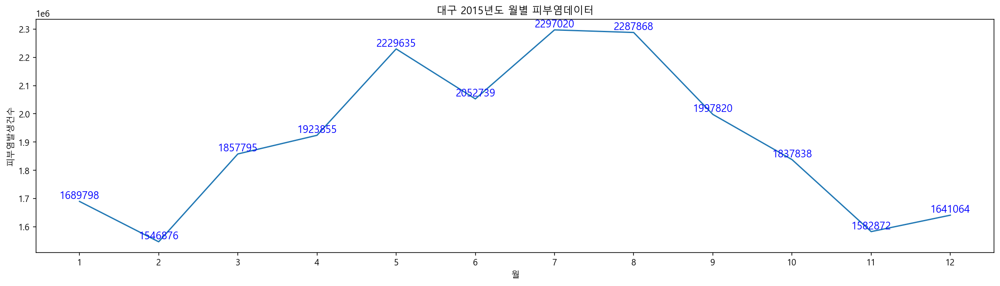

In [179]:
plt.figure(figsize=(20, 5))
plt.title("대구 2015년도 월별 피부염데이터")
sns.lineplot(data=df_daegu_2015, x="월", y="피부염발생건수")
for i, v in enumerate(df_daegu_2015["월"]):
    plt.text(v, (df_daegu_2015["피부염발생건수"])[i], (df_daegu_2015["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 대구 2016년도 데이터

In [163]:
df_daegu_2016 = df[(df["시도명"] == "대구광역시") | (df["연도"] == "2016")]
df_daegu_2016 = df_daegu_2016.drop(["연도별 월"], axis=1).copy()
df_daegu_2016["연도"] = df_daegu_2016["연도"].astype("str")
df_daegu_2016 = df_daegu_2016.groupby("월").sum()
df_daegu_2016 = df_daegu_2016.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_daegu_2016 = df_daegu_2016.reset_index()

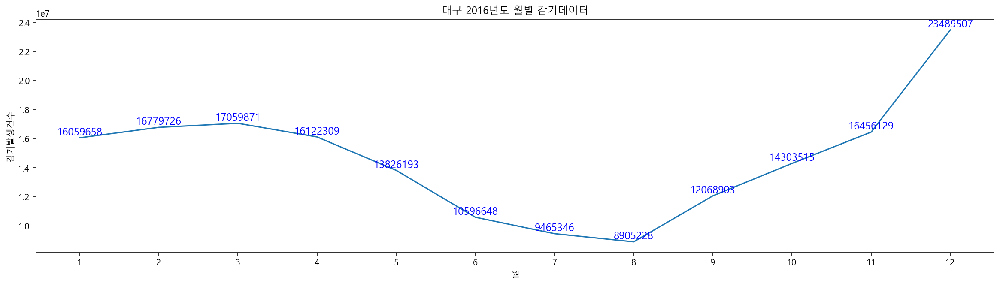

In [180]:
plt.figure(figsize=(20, 5))
plt.title("대구 2016년도 월별 감기데이터")
sns.lineplot(data=df_daegu_2016, x="월", y="감기발생건수")
for i, v in enumerate(df_daegu_2016["월"]):
    plt.text(v, (df_daegu_2016["감기발생건수"])[i], (df_daegu_2016["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

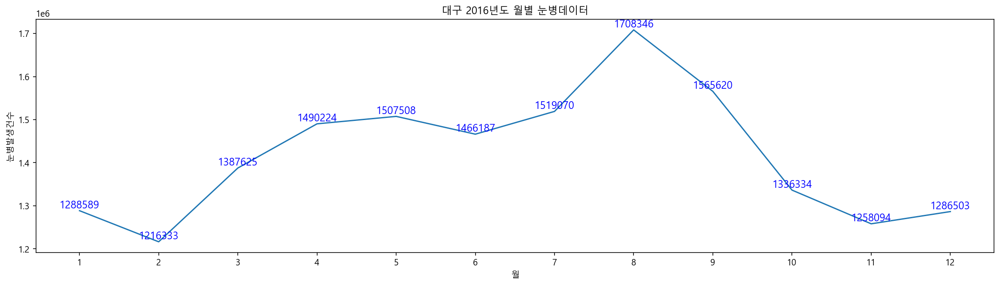

In [181]:
plt.figure(figsize=(20, 5))
plt.title("대구 2016년도 월별 눈병데이터")
sns.lineplot(data=df_daegu_2016, x="월", y="눈병발생건수")
for i, v in enumerate(df_daegu_2016["월"]):
    plt.text(v, (df_daegu_2016["눈병발생건수"])[i], (df_daegu_2016["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

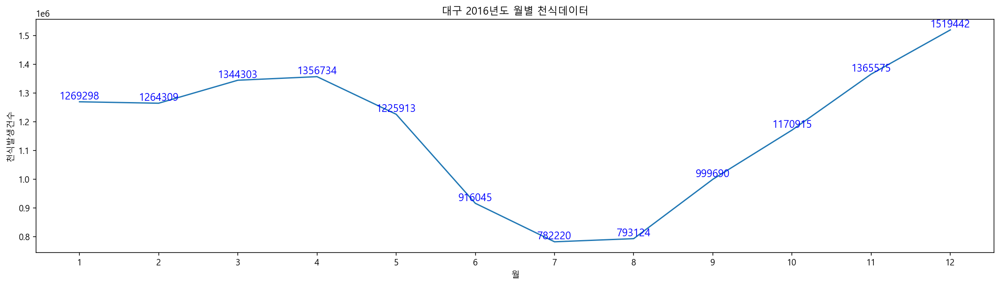

In [182]:
plt.figure(figsize=(20, 5))
plt.title("대구 2016년도 월별 천식데이터")
sns.lineplot(data=df_daegu_2016, x="월", y="천식발생건수")
for i, v in enumerate(df_daegu_2016["월"]):
    plt.text(v, (df_daegu_2016["천식발생건수"])[i], (df_daegu_2016["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

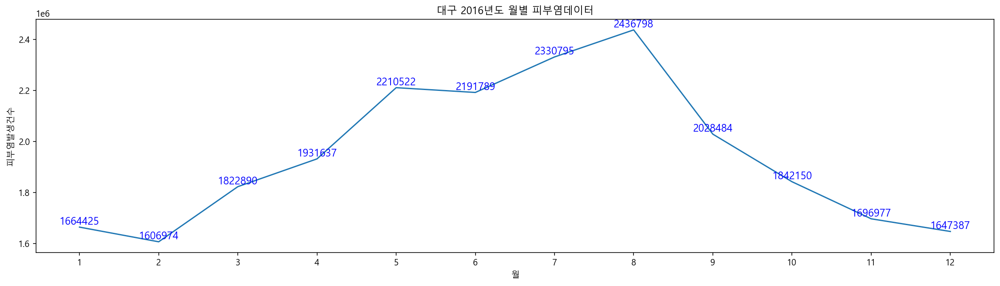

In [183]:
plt.figure(figsize=(20, 5))
plt.title("대구 2016년도 월별 피부염데이터")
sns.lineplot(data=df_daegu_2016, x="월", y="피부염발생건수")
for i, v in enumerate(df_daegu_2016["월"]):
    plt.text(v, (df_daegu_2016["피부염발생건수"])[i], (df_daegu_2016["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 대구 2017년도 데이터

In [164]:
df_daegu_2017 = df[(df["시도명"] == "대구광역시") | (df["연도"] == "2017")]
df_daegu_2017 = df_daegu_2017.drop(["연도별 월"], axis=1).copy()
df_daegu_2017["연도"] = df_daegu_2017["연도"].astype("str")
df_daegu_2017 = df_daegu_2017.groupby("월").sum()
df_daegu_2017 = df_daegu_2017.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_daegu_2017 = df_daegu_2017.reset_index()

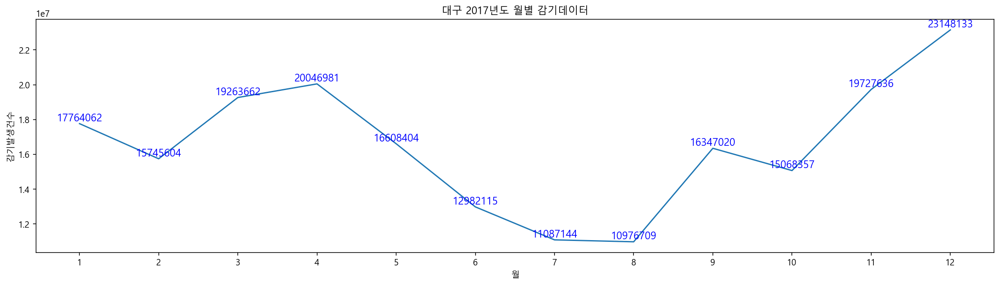

In [184]:
plt.figure(figsize=(20, 5))
plt.title("대구 2017년도 월별 감기데이터")
sns.lineplot(data=df_daegu_2017, x="월", y="감기발생건수")
for i, v in enumerate(df_daegu_2017["월"]):
    plt.text(v, (df_daegu_2017["감기발생건수"])[i], (df_daegu_2017["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

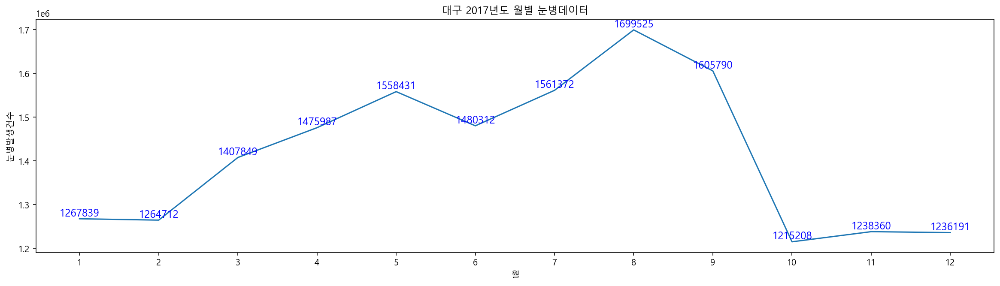

In [185]:
plt.figure(figsize=(20, 5))
plt.title("대구 2017년도 월별 눈병데이터")
sns.lineplot(data=df_daegu_2017, x="월", y="눈병발생건수")
for i, v in enumerate(df_daegu_2017["월"]):
    plt.text(v, (df_daegu_2017["눈병발생건수"])[i], (df_daegu_2017["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

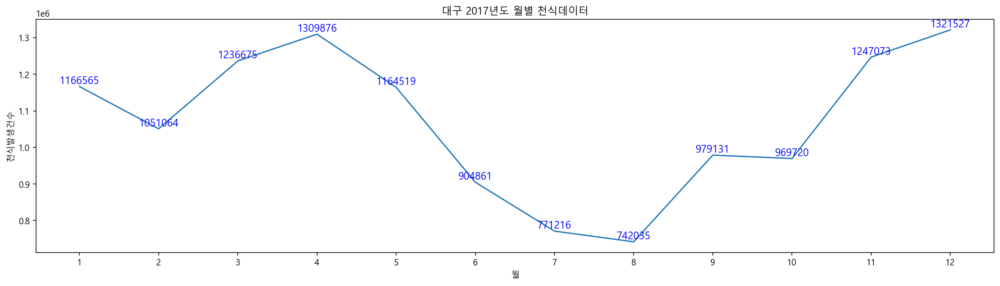

In [186]:
plt.figure(figsize=(20, 5))
plt.title("대구 2017년도 월별 천식데이터")
sns.lineplot(data=df_daegu_2017, x="월", y="천식발생건수")
for i, v in enumerate(df_daegu_2017["월"]):
    plt.text(v, (df_daegu_2017["천식발생건수"])[i], (df_daegu_2017["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

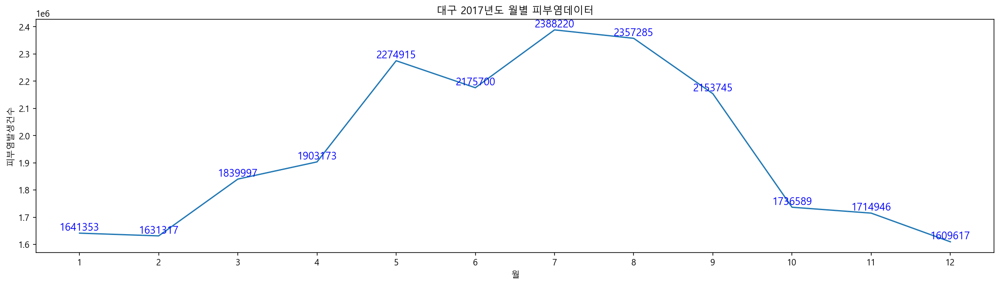

In [187]:
plt.figure(figsize=(20, 5))
plt.title("대구 2017년도 월별 피부염데이터")
sns.lineplot(data=df_daegu_2017, x="월", y="피부염발생건수")
for i, v in enumerate(df_daegu_2017["월"]):
    plt.text(v, (df_daegu_2017["피부염발생건수"])[i], (df_daegu_2017["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 대구 2018년도 데이터

In [165]:
df_daegu_2018 = df[(df["시도명"] == "대구광역시") | (df["연도"] == "2018")]
df_daegu_2018 = df_daegu_2018.drop(["연도별 월"], axis=1).copy()
df_daegu_2018["연도"] = df_daegu_2018["연도"].astype("str")
df_daegu_2018 = df_daegu_2018.groupby("월").sum()
df_daegu_2018 = df_daegu_2018.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_daegu_2018 = df_daegu_2018.reset_index()

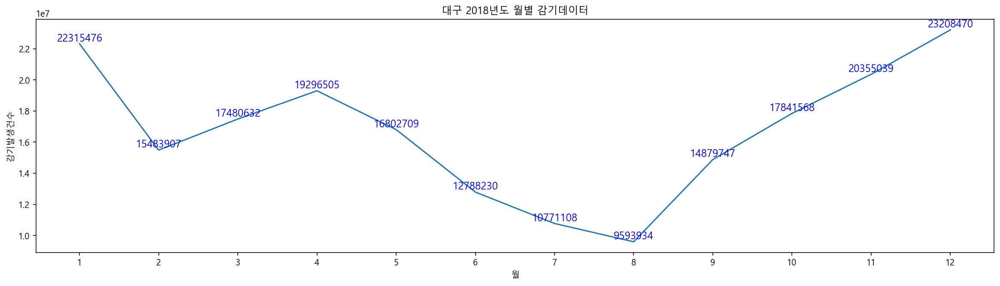

In [188]:
plt.figure(figsize=(20, 5))
plt.title("대구 2018년도 월별 감기데이터")
sns.lineplot(data=df_daegu_2018, x="월", y="감기발생건수")
for i, v in enumerate(df_daegu_2018["월"]):
    plt.text(v, (df_daegu_2018["감기발생건수"])[i], (df_daegu_2018["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

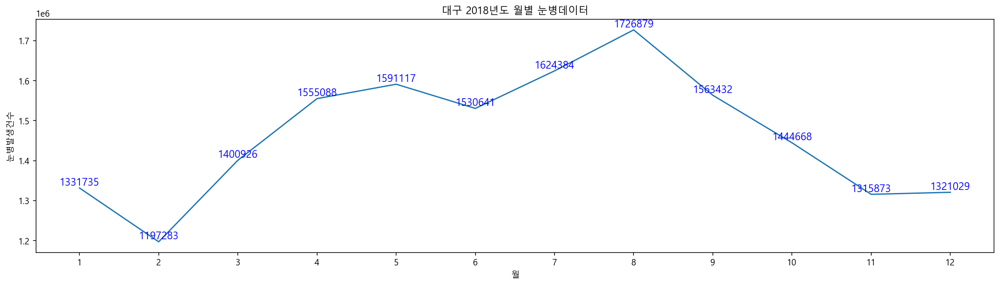

In [189]:
plt.figure(figsize=(20, 5))
plt.title("대구 2018년도 월별 눈병데이터")
sns.lineplot(data=df_daegu_2018, x="월", y="눈병발생건수")
for i, v in enumerate(df_daegu_2018["월"]):
    plt.text(v, (df_daegu_2018["눈병발생건수"])[i], (df_daegu_2018["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

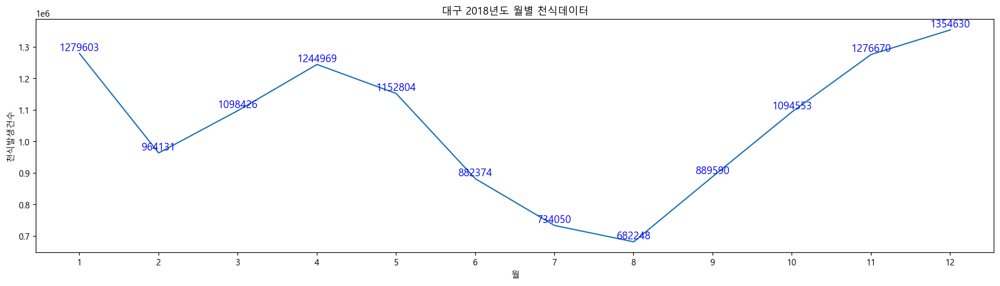

In [190]:
plt.figure(figsize=(20, 5))
plt.title("대구 2018년도 월별 천식데이터")
sns.lineplot(data=df_daegu_2018, x="월", y="천식발생건수")
for i, v in enumerate(df_daegu_2018["월"]):
    plt.text(v, (df_daegu_2018["천식발생건수"])[i], (df_daegu_2018["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

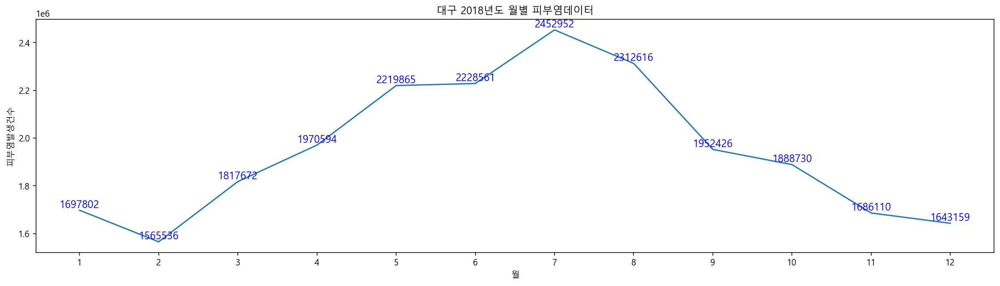

In [191]:
plt.figure(figsize=(20, 5))
plt.title("대구 2018년도 월별 피부염데이터")
sns.lineplot(data=df_daegu_2018, x="월", y="피부염발생건수")
for i, v in enumerate(df_daegu_2018["월"]):
    plt.text(v, (df_daegu_2018["피부염발생건수"])[i], (df_daegu_2018["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 대구 2019년도 데이터

In [166]:
df_daegu_2019 = df[(df["시도명"] == "대구광역시") | (df["연도"] == "2019")]
df_daegu_2019 = df_daegu_2019.drop(["연도별 월"], axis=1).copy()
df_daegu_2019["연도"] = df_daegu_2019["연도"].astype("str")
df_daegu_2019 = df_daegu_2019.groupby("월").sum()
df_daegu_2019 = df_daegu_2019.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_daegu_2019 = df_daegu_2019.reset_index()

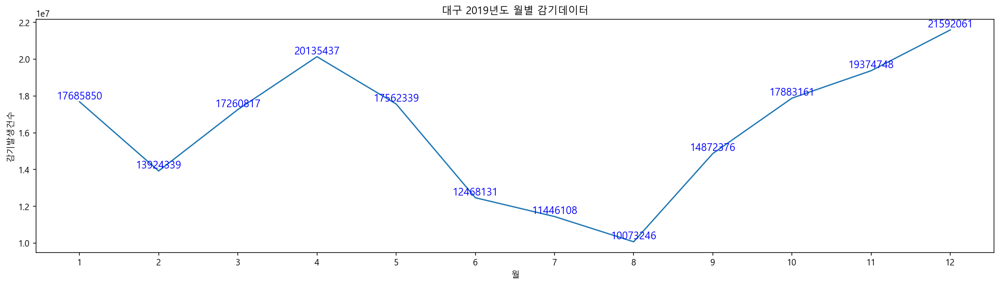

In [192]:
plt.figure(figsize=(20, 5))
plt.title("대구 2019년도 월별 감기데이터")
sns.lineplot(data=df_daegu_2019, x="월", y="감기발생건수")
for i, v in enumerate(df_daegu_2019["월"]):
    plt.text(v, (df_daegu_2019["감기발생건수"])[i], (df_daegu_2019["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

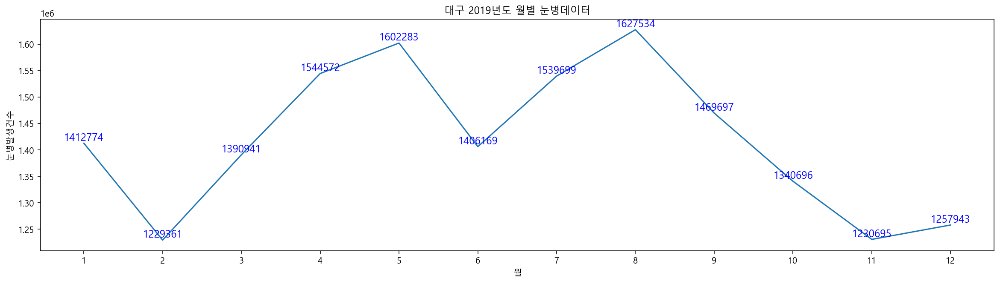

In [193]:
plt.figure(figsize=(20, 5))
plt.title("대구 2019년도 월별 눈병데이터")
sns.lineplot(data=df_daegu_2019, x="월", y="눈병발생건수")
for i, v in enumerate(df_daegu_2019["월"]):
    plt.text(v, (df_daegu_2019["눈병발생건수"])[i], (df_daegu_2019["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

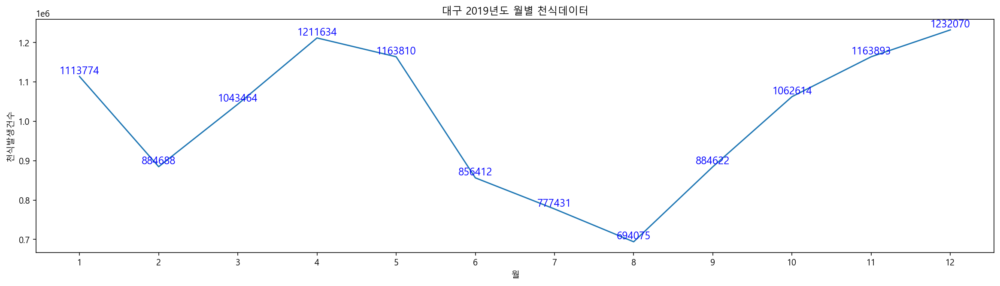

In [194]:
plt.figure(figsize=(20, 5))
plt.title("대구 2019년도 월별 천식데이터")
sns.lineplot(data=df_daegu_2019, x="월", y="천식발생건수")
for i, v in enumerate(df_daegu_2019["월"]):
    plt.text(v, (df_daegu_2019["천식발생건수"])[i], (df_daegu_2019["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

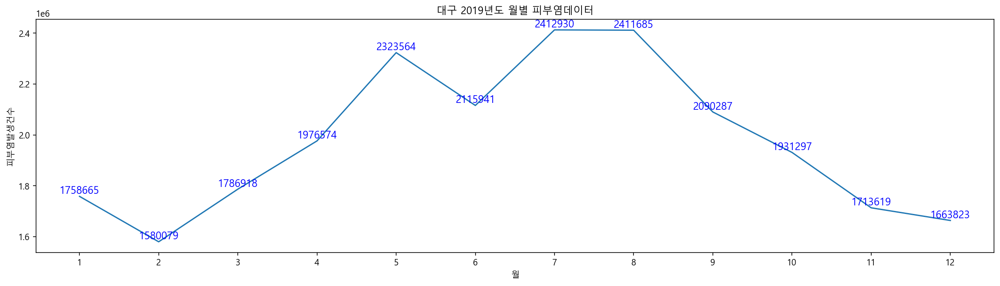

In [195]:
plt.figure(figsize=(20, 5))
plt.title("대구 2019년도 월별 피부염데이터")
sns.lineplot(data=df_daegu_2019, x="월", y="피부염발생건수")
for i, v in enumerate(df_daegu_2019["월"]):
    plt.text(v, (df_daegu_2019["피부염발생건수"])[i], (df_daegu_2019["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 대구 2020년도 데이터

In [167]:
df_daegu_2020 = df[(df["시도명"] == "대구광역시") | (df["연도"] == "2020")]
df_daegu_2020 = df_daegu_2020.drop(["연도별 월"], axis=1).copy()
df_daegu_2020["연도"] = df_daegu_2020["연도"].astype("str")
df_daegu_2020 = df_daegu_2020.groupby("월").sum()
df_daegu_2020 = df_daegu_2020.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9"])
df_daegu_2020 = df_daegu_2020.reset_index()

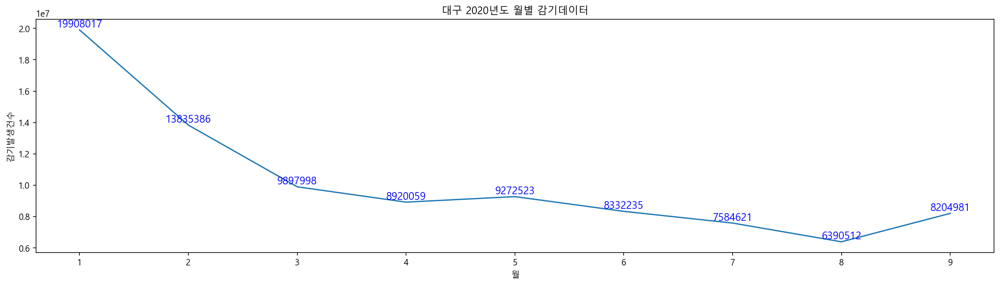

In [196]:
plt.figure(figsize=(20, 5))
plt.title("대구 2020년도 월별 감기데이터")
sns.lineplot(data=df_daegu_2020, x="월", y="감기발생건수")
for i, v in enumerate(df_daegu_2020["월"]):
    plt.text(v, (df_daegu_2020["감기발생건수"])[i], (df_daegu_2020["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

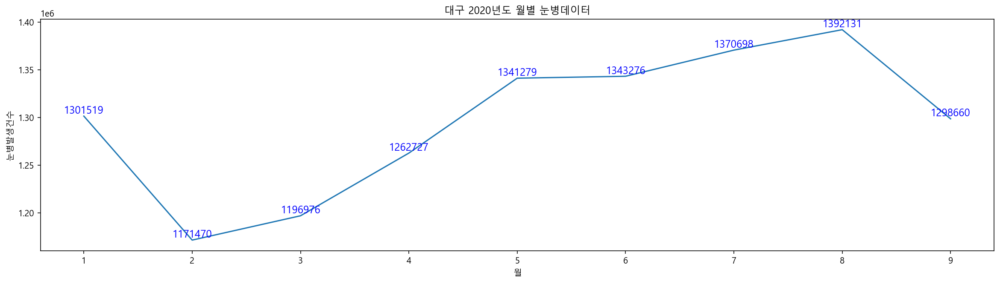

In [197]:
plt.figure(figsize=(20, 5))
plt.title("대구 2020년도 월별 눈병데이터")
sns.lineplot(data=df_daegu_2020, x="월", y="눈병발생건수")
for i, v in enumerate(df_daegu_2020["월"]):
    plt.text(v, (df_daegu_2020["눈병발생건수"])[i], (df_daegu_2020["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

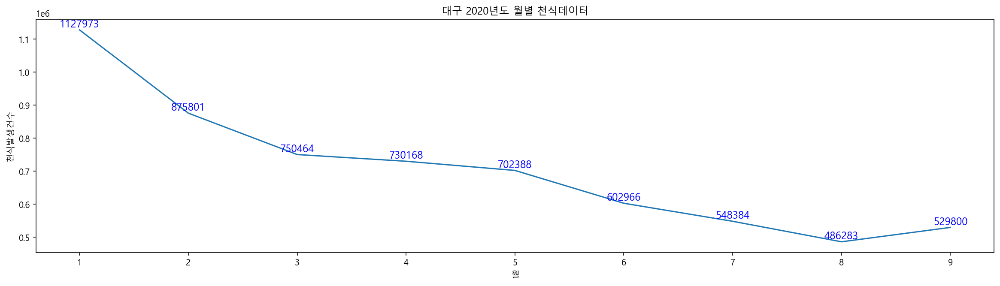

In [198]:
plt.figure(figsize=(20, 5))
plt.title("대구 2020년도 월별 천식데이터")
sns.lineplot(data=df_daegu_2020, x="월", y="천식발생건수")
for i, v in enumerate(df_daegu_2020["월"]):
    plt.text(v, (df_daegu_2020["천식발생건수"])[i], (df_daegu_2020["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

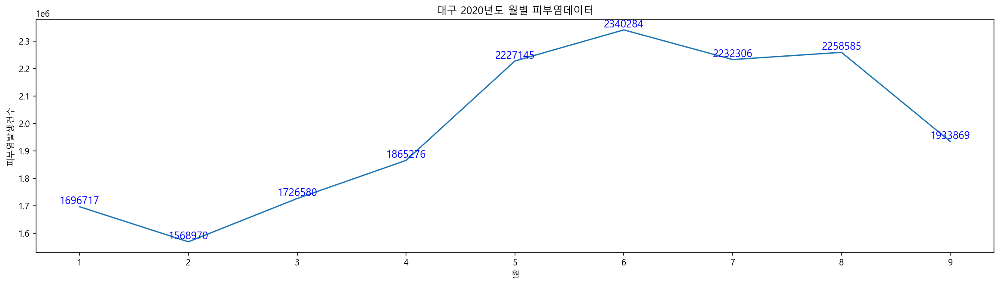

In [199]:
plt.figure(figsize=(20, 5))
plt.title("대구 2020년도 월별 피부염데이터")
sns.lineplot(data=df_daegu_2020, x="월", y="피부염발생건수")
for i, v in enumerate(df_daegu_2020["월"]):
    plt.text(v, (df_daegu_2020["피부염발생건수"])[i], (df_daegu_2020["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

# 인천광역시 데이터

## 인천 전체 데이터

In [202]:
df_incheon_fool = df[df["시도명"] == "인천광역시"]
df_incheon_fool = df_incheon_fool.groupby("연도별 월").sum().copy()
df_incheon_fool = df_incheon_fool.reindex(index=["2014-1", "2014-2", "2014-3", "2014-4", "2014-5", "2014-6", "2014-7", "2014-8", "2014-9"
                                  , "2014-10", "2014-11", "2014-12", "2015-1", "2015-2", "2015-3", "2015-4", "2015-5"
                                  , "2015-6", "2015-7", "2015-8", "2015-9", "2015-10", "2015-11", "2015-12", "2016-1"
                                  , "2016-2", "2016-3", "2016-4", "2016-5", "2016-6", "2016-7", "2016-8", "2016-9"
                                  , "2016-10", "2016-11", "2016-12", "2017-1", "2017-2", "2017-3", "2017-4", "2017-5"
                                  , "2017-6", "2017-7", "2017-8", "2017-9", "2017-10", "2017-11", "2017-12", "2018-1"
                                  , "2018-2", "2018-3", "2018-4", "2018-5", "2018-6", "2018-7", "2018-8", "2018-9"
                                  , "2018-10", "2018-11", "2018-12", "2019-1", "2019-2", "2019-3", "2019-4", "2019-5"
                                  , "2019-6", "2019-7", "2019-8", "2019-9", "2019-10", "2019-11", "2019-12", "2020-1"
                                  , "2020-2", "2020-3", "2020-4", "2020-5", "2020-6", "2020-7", "2020-8", "2020-9"])
df_incheon_fool = df_incheon_fool.reset_index()

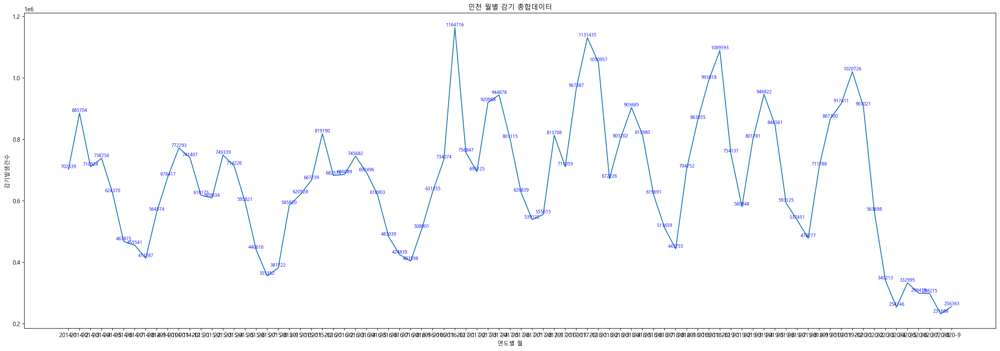

In [203]:
plt.figure(figsize=(30, 10))
plt.title("인천 월별 감기 총합데이터")
sns.lineplot(data=df_incheon_fool, x="연도별 월", y="감기발생건수")
for i, v in enumerate(df_incheon_fool["연도별 월"]):
    plt.text(v, (df_incheon_fool["감기발생건수"])[i], (df_incheon_fool["감기발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

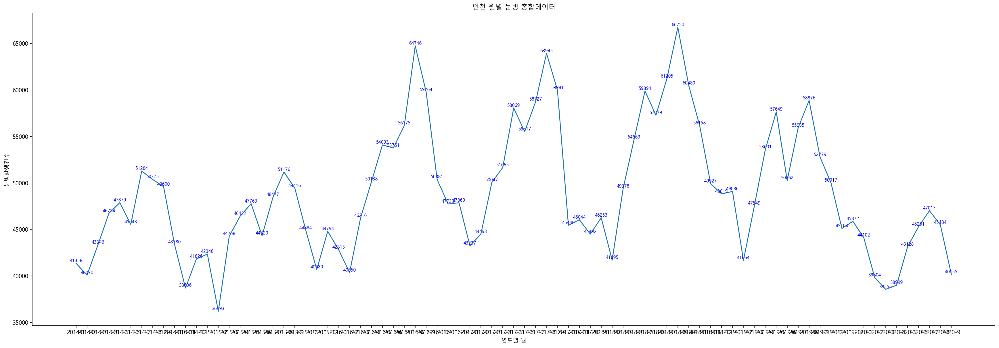

In [204]:
plt.figure(figsize=(30, 10))
plt.title("인천 월별 눈병 총합데이터")
sns.lineplot(data=df_incheon_fool, x="연도별 월", y="눈병발생건수")
for i, v in enumerate(df_incheon_fool["연도별 월"]):
    plt.text(v, (df_incheon_fool["눈병발생건수"])[i], (df_incheon_fool["눈병발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

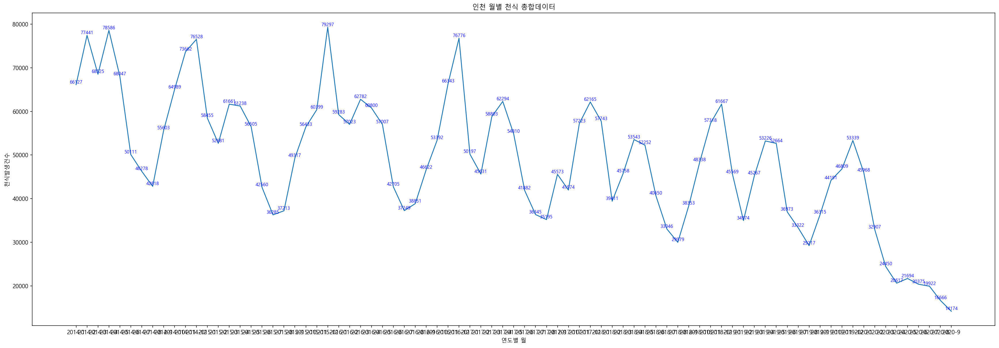

In [205]:
plt.figure(figsize=(30, 10))
plt.title("인천 월별 천식 총합데이터")
sns.lineplot(data=df_incheon_fool, x="연도별 월", y="천식발생건수")
for i, v in enumerate(df_incheon_fool["연도별 월"]):
    plt.text(v, (df_incheon_fool["천식발생건수"])[i], (df_incheon_fool["천식발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

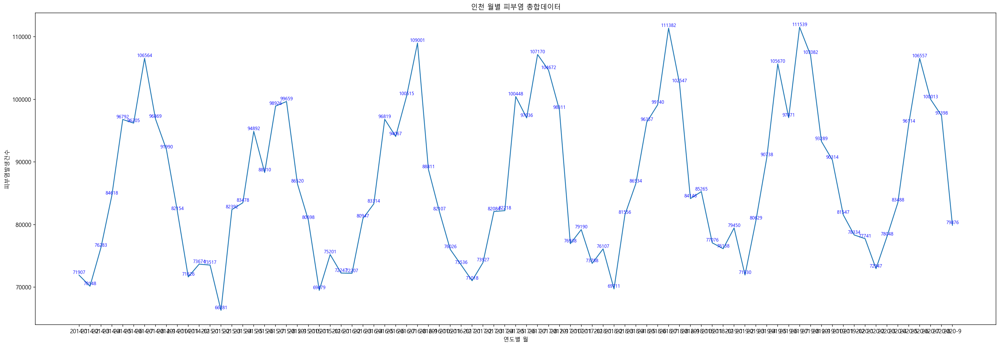

In [206]:
plt.figure(figsize=(30, 10))
plt.title("인천 월별 피부염 총합데이터")
sns.lineplot(data=df_incheon_fool, x="연도별 월", y="피부염발생건수")
for i, v in enumerate(df_incheon_fool["연도별 월"]):
    plt.text(v, (df_incheon_fool["피부염발생건수"])[i], (df_incheon_fool["피부염발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

## 인천 2014년 데이터

In [207]:
df_incheon_2014 = df[(df["시도명"] == "인천광역시") | (df["연도"] == "2014")]
df_incheon_2014 = df_incheon_2014.drop(["연도별 월"], axis=1).copy()
df_incheon_2014["연도"] = df_incheon_2014["연도"].astype("str")
df_incheon_2014 = df_incheon_2014.groupby("월").sum()
df_incheon_2014 = df_incheon_2014.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_incheon_2014 = df_incheon_2014.reset_index()

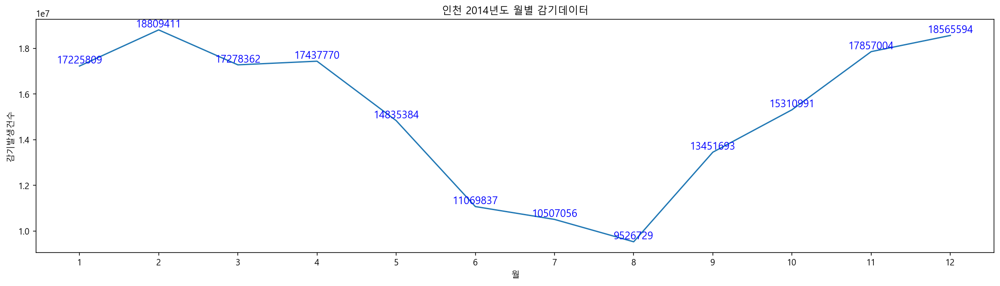

In [208]:
plt.figure(figsize=(20, 5))
plt.title("인천 2014년도 월별 감기데이터")
sns.lineplot(data=df_incheon_2014, x="월", y="감기발생건수")
for i, v in enumerate(df_incheon_2014["월"]):
    plt.text(v, (df_incheon_2014["감기발생건수"])[i], (df_incheon_2014["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

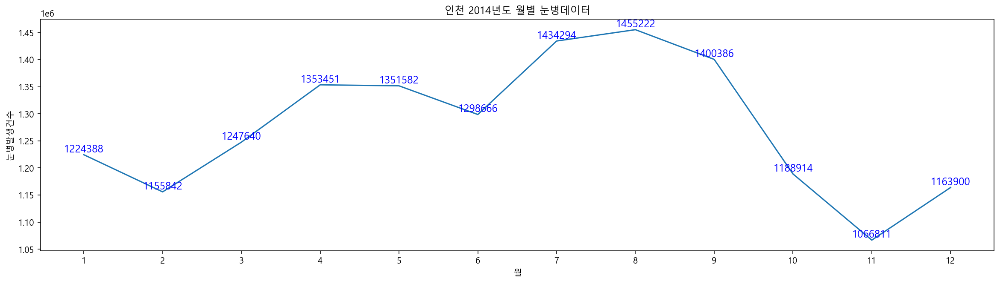

In [209]:
plt.figure(figsize=(20, 5))
plt.title("인천 2014년도 월별 눈병데이터")
sns.lineplot(data=df_incheon_2014, x="월", y="눈병발생건수")
for i, v in enumerate(df_incheon_2014["월"]):
    plt.text(v, (df_incheon_2014["눈병발생건수"])[i], (df_incheon_2014["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

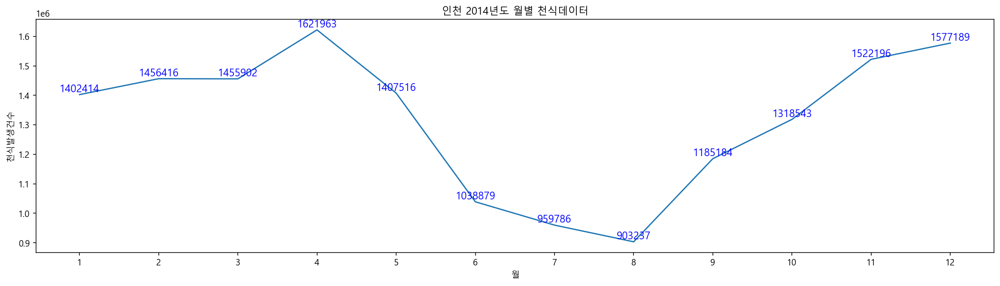

In [210]:
plt.figure(figsize=(20, 5))
plt.title("인천 2014년도 월별 천식데이터")
sns.lineplot(data=df_incheon_2014, x="월", y="천식발생건수")
for i, v in enumerate(df_incheon_2014["월"]):
    plt.text(v, (df_incheon_2014["천식발생건수"])[i], (df_incheon_2014["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

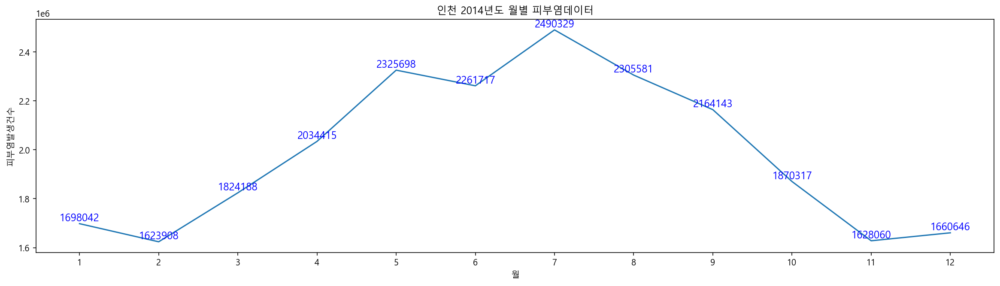

In [211]:
plt.figure(figsize=(20, 5))
plt.title("인천 2014년도 월별 피부염데이터")
sns.lineplot(data=df_incheon_2014, x="월", y="피부염발생건수")
for i, v in enumerate(df_incheon_2014["월"]):
    plt.text(v, (df_incheon_2014["피부염발생건수"])[i], (df_incheon_2014["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 인천 2015년 데이터

In [212]:
df_incheon_2015 = df[(df["시도명"] == "인천광역시") | (df["연도"] == "2015")]
df_incheon_2015 = df_incheon_2015.drop(["연도별 월"], axis=1).copy()
df_incheon_2015["연도"] = df_incheon_2015["연도"].astype("str")
df_incheon_2015 = df_incheon_2015.groupby("월").sum()
df_incheon_2015 = df_incheon_2015.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_incheon_2015 = df_incheon_2015.reset_index()

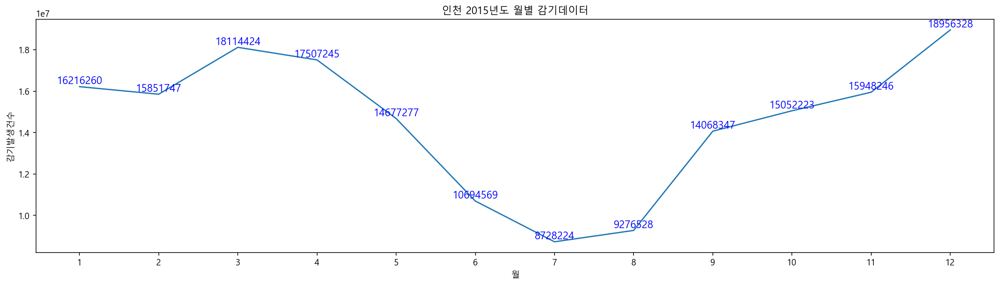

In [215]:
plt.figure(figsize=(20, 5))
plt.title("인천 2015년도 월별 감기데이터")
sns.lineplot(data=df_incheon_2015, x="월", y="감기발생건수")
for i, v in enumerate(df_incheon_2015["월"]):
    plt.text(v, (df_incheon_2015["감기발생건수"])[i], (df_incheon_2015["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

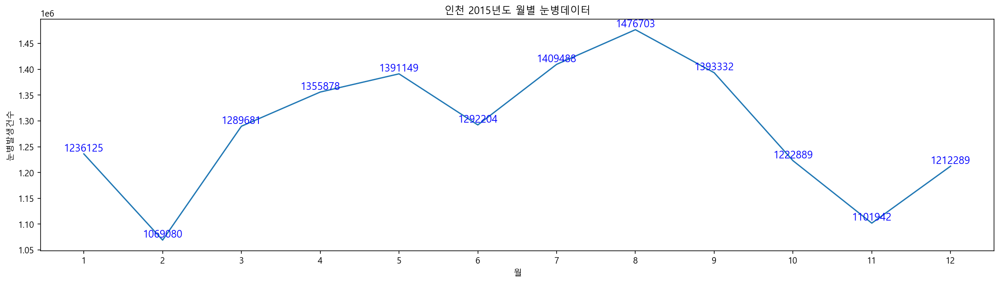

In [216]:
plt.figure(figsize=(20, 5))
plt.title("인천 2015년도 월별 눈병데이터")
sns.lineplot(data=df_incheon_2015, x="월", y="눈병발생건수")
for i, v in enumerate(df_incheon_2015["월"]):
    plt.text(v, (df_incheon_2015["눈병발생건수"])[i], (df_incheon_2015["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

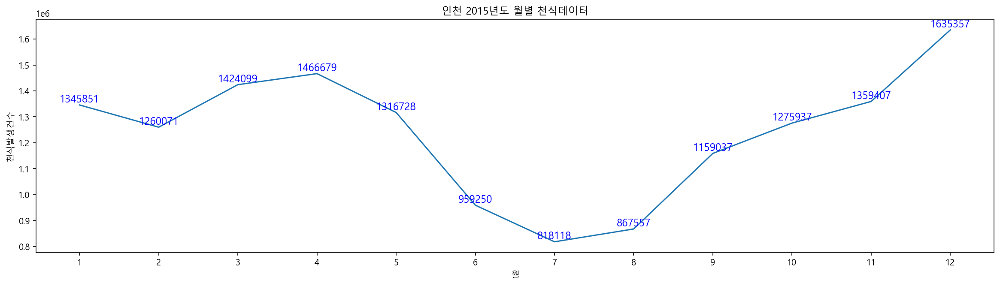

In [217]:
plt.figure(figsize=(20, 5))
plt.title("인천 2015년도 월별 천식데이터")
sns.lineplot(data=df_incheon_2015, x="월", y="천식발생건수")
for i, v in enumerate(df_incheon_2015["월"]):
    plt.text(v, (df_incheon_2015["천식발생건수"])[i], (df_incheon_2015["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

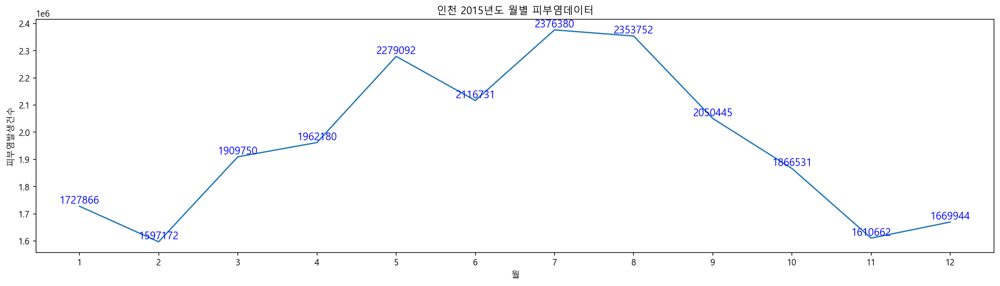

In [218]:
plt.figure(figsize=(20, 5))
plt.title("인천 2015년도 월별 피부염데이터")
sns.lineplot(data=df_incheon_2015, x="월", y="피부염발생건수")
for i, v in enumerate(df_incheon_2015["월"]):
    plt.text(v, (df_incheon_2015["피부염발생건수"])[i], (df_incheon_2015["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 인천 2016년 데이터

In [219]:
df_incheon_2016 = df[(df["시도명"] == "인천광역시") | (df["연도"] == "2016")]
df_incheon_2016 = df_incheon_2016.drop(["연도별 월"], axis=1).copy()
df_incheon_2016["연도"] = df_incheon_2016["연도"].astype("str")
df_incheon_2016 = df_incheon_2016.groupby("월").sum()
df_incheon_2016 = df_incheon_2016.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_incheon_2016 = df_incheon_2016.reset_index()

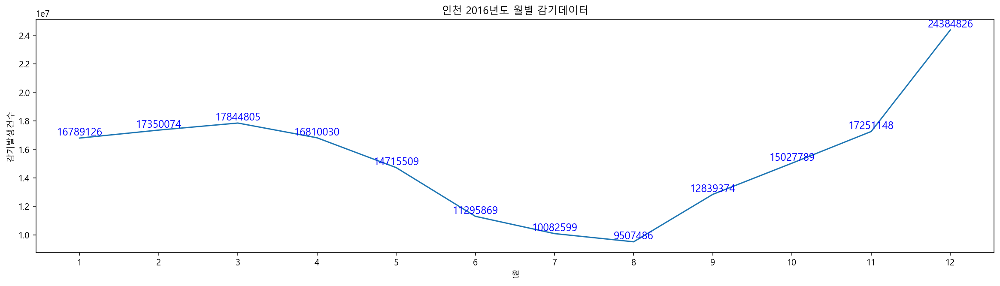

In [220]:
plt.figure(figsize=(20, 5))
plt.title("인천 2016년도 월별 감기데이터")
sns.lineplot(data=df_incheon_2016, x="월", y="감기발생건수")
for i, v in enumerate(df_incheon_2016["월"]):
    plt.text(v, (df_incheon_2016["감기발생건수"])[i], (df_incheon_2016["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

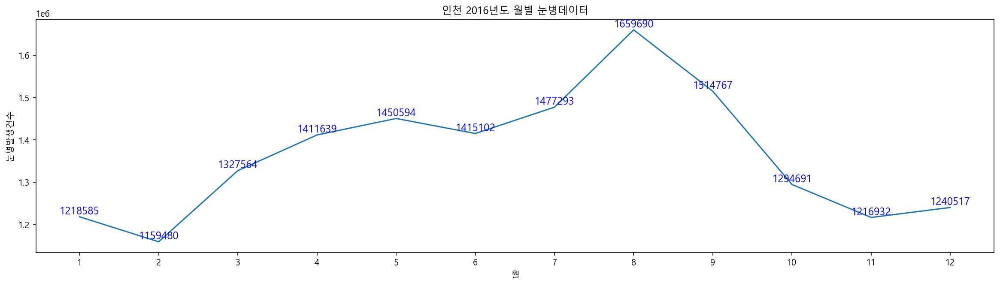

In [221]:
plt.figure(figsize=(20, 5))
plt.title("인천 2016년도 월별 눈병데이터")
sns.lineplot(data=df_incheon_2016, x="월", y="눈병발생건수")
for i, v in enumerate(df_incheon_2016["월"]):
    plt.text(v, (df_incheon_2016["눈병발생건수"])[i], (df_incheon_2016["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

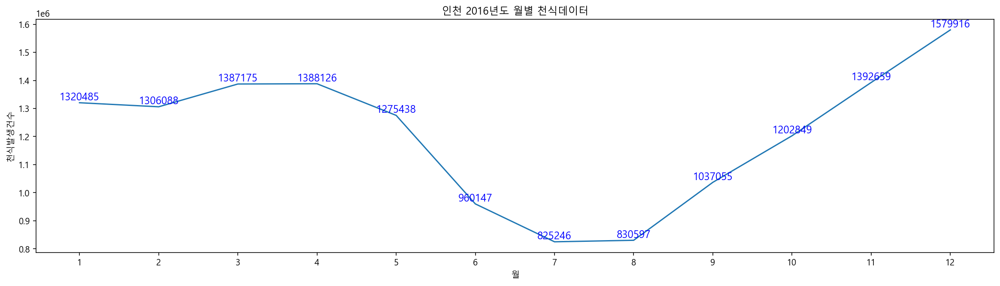

In [222]:
plt.figure(figsize=(20, 5))
plt.title("인천 2016년도 월별 천식데이터")
sns.lineplot(data=df_incheon_2016, x="월", y="천식발생건수")
for i, v in enumerate(df_incheon_2016["월"]):
    plt.text(v, (df_incheon_2016["천식발생건수"])[i], (df_incheon_2016["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

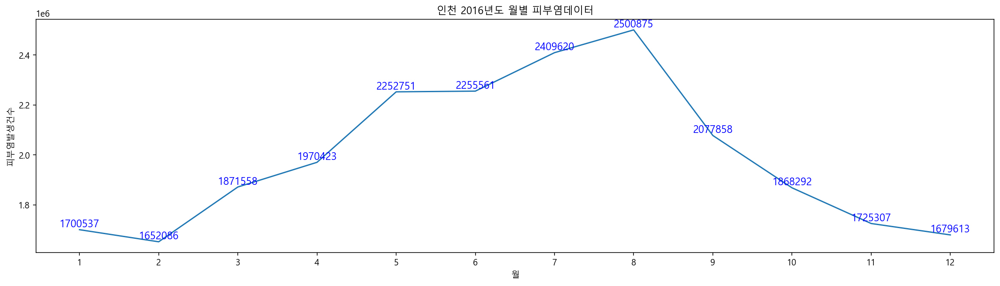

In [223]:
plt.figure(figsize=(20, 5))
plt.title("인천 2016년도 월별 피부염데이터")
sns.lineplot(data=df_incheon_2016, x="월", y="피부염발생건수")
for i, v in enumerate(df_incheon_2016["월"]):
    plt.text(v, (df_incheon_2016["피부염발생건수"])[i], (df_incheon_2016["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 인천 2017년 데이터

In [224]:
df_incheon_2017 = df[(df["시도명"] == "인천광역시") | (df["연도"] == "2017")]
df_incheon_2017 = df_incheon_2017.drop(["연도별 월"], axis=1).copy()
df_incheon_2017["연도"] = df_incheon_2017["연도"].astype("str")
df_incheon_2017 = df_incheon_2017.groupby("월").sum()
df_incheon_2017 = df_incheon_2017.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_incheon_2017 = df_incheon_2017.reset_index()

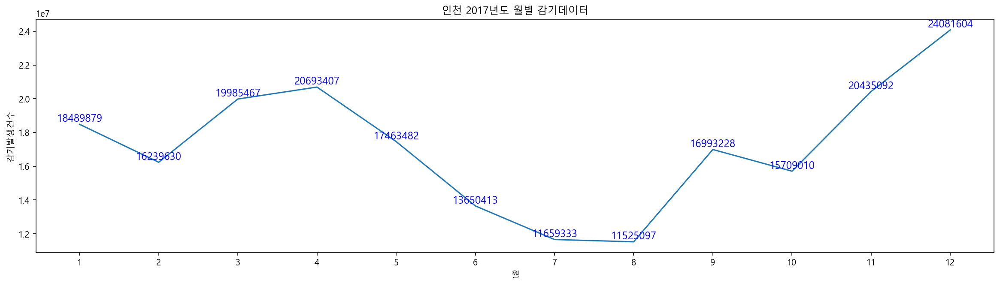

In [225]:
plt.figure(figsize=(20, 5))
plt.title("인천 2017년도 월별 감기데이터")
sns.lineplot(data=df_incheon_2017, x="월", y="감기발생건수")
for i, v in enumerate(df_incheon_2017["월"]):
    plt.text(v, (df_incheon_2017["감기발생건수"])[i], (df_incheon_2017["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

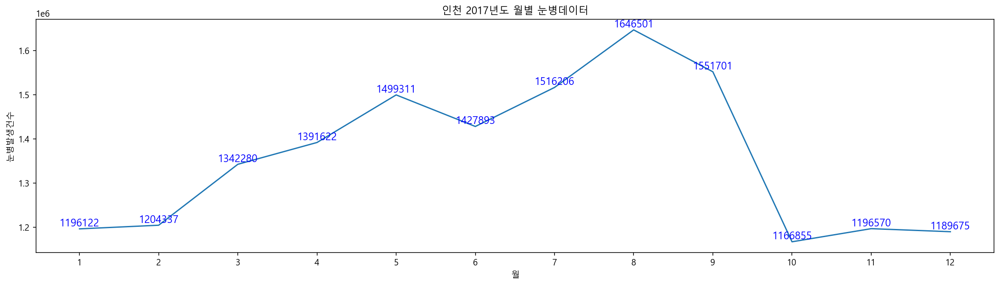

In [226]:
plt.figure(figsize=(20, 5))
plt.title("인천 2017년도 월별 눈병데이터")
sns.lineplot(data=df_incheon_2017, x="월", y="눈병발생건수")
for i, v in enumerate(df_incheon_2017["월"]):
    plt.text(v, (df_incheon_2017["눈병발생건수"])[i], (df_incheon_2017["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

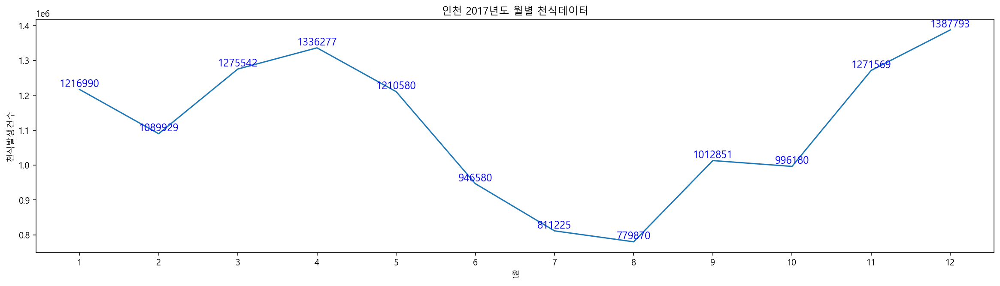

In [227]:
plt.figure(figsize=(20, 5))
plt.title("인천 2017년도 월별 천식데이터")
sns.lineplot(data=df_incheon_2017, x="월", y="천식발생건수")
for i, v in enumerate(df_incheon_2017["월"]):
    plt.text(v, (df_incheon_2017["천식발생건수"])[i], (df_incheon_2017["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

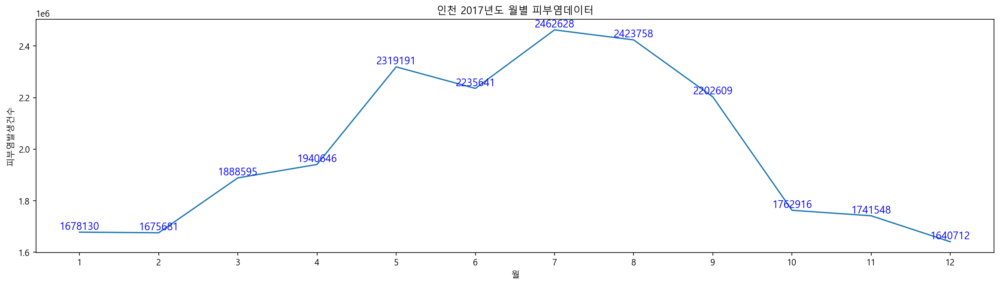

In [228]:
plt.figure(figsize=(20, 5))
plt.title("인천 2017년도 월별 피부염데이터")
sns.lineplot(data=df_incheon_2017, x="월", y="피부염발생건수")
for i, v in enumerate(df_incheon_2017["월"]):
    plt.text(v, (df_incheon_2017["피부염발생건수"])[i], (df_incheon_2017["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 인천 2018년 데이터

In [229]:
df_incheon_2018 = df[(df["시도명"] == "인천광역시") | (df["연도"] == "2018")]
df_incheon_2018 = df_incheon_2018.drop(["연도별 월"], axis=1).copy()
df_incheon_2018["연도"] = df_incheon_2018["연도"].astype("str")
df_incheon_2018 = df_incheon_2018.groupby("월").sum()
df_incheon_2018 = df_incheon_2018.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_incheon_2018 = df_incheon_2018.reset_index()

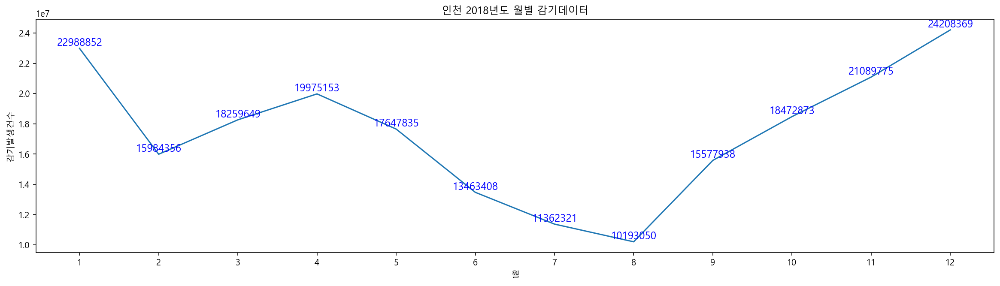

In [230]:
plt.figure(figsize=(20, 5))
plt.title("인천 2018년도 월별 감기데이터")
sns.lineplot(data=df_incheon_2018, x="월", y="감기발생건수")
for i, v in enumerate(df_incheon_2018["월"]):
    plt.text(v, (df_incheon_2018["감기발생건수"])[i], (df_incheon_2018["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

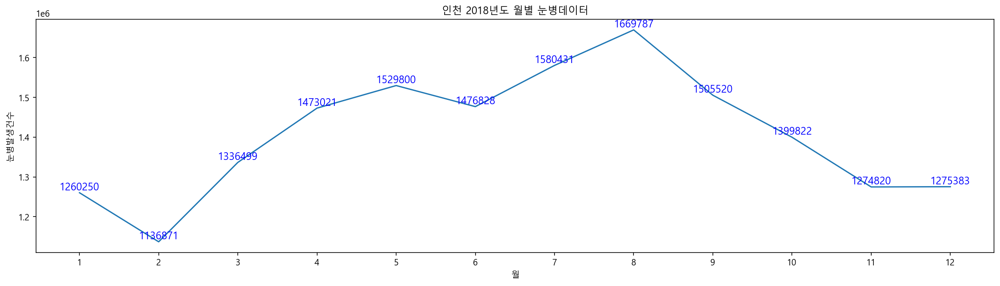

In [231]:
plt.figure(figsize=(20, 5))
plt.title("인천 2018년도 월별 눈병데이터")
sns.lineplot(data=df_incheon_2018, x="월", y="눈병발생건수")
for i, v in enumerate(df_incheon_2018["월"]):
    plt.text(v, (df_incheon_2018["눈병발생건수"])[i], (df_incheon_2018["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

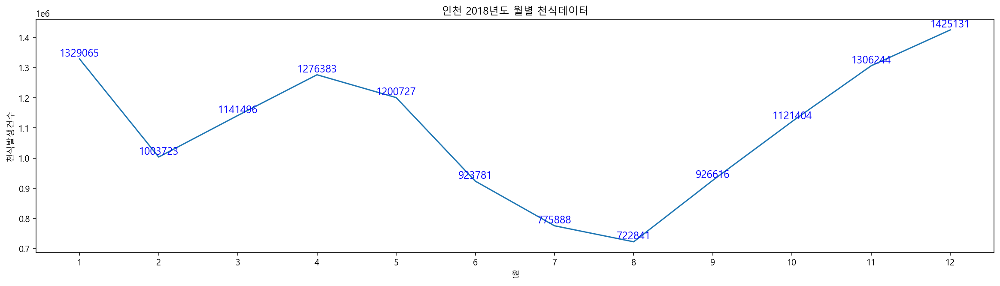

In [232]:
plt.figure(figsize=(20, 5))
plt.title("인천 2018년도 월별 천식데이터")
sns.lineplot(data=df_incheon_2018, x="월", y="천식발생건수")
for i, v in enumerate(df_incheon_2018["월"]):
    plt.text(v, (df_incheon_2018["천식발생건수"])[i], (df_incheon_2018["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

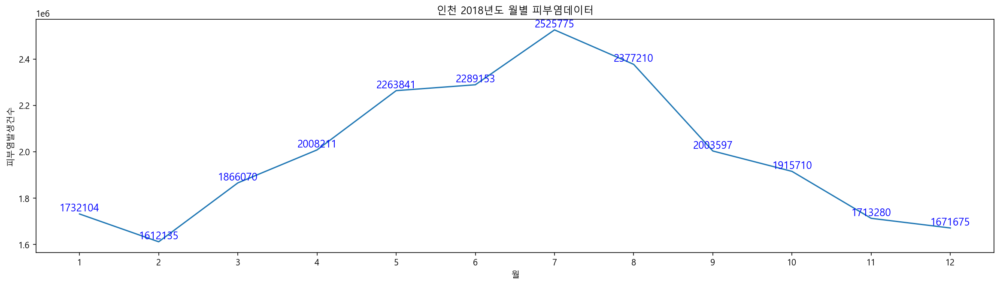

In [233]:
plt.figure(figsize=(20, 5))
plt.title("인천 2018년도 월별 피부염데이터")
sns.lineplot(data=df_incheon_2018, x="월", y="피부염발생건수")
for i, v in enumerate(df_incheon_2018["월"]):
    plt.text(v, (df_incheon_2018["피부염발생건수"])[i], (df_incheon_2018["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 인천 2019년 데이터

In [234]:
df_incheon_2019 = df[(df["시도명"] == "인천광역시") | (df["연도"] == "2019")]
df_incheon_2019 = df_incheon_2019.drop(["연도별 월"], axis=1).copy()
df_incheon_2019["연도"] = df_incheon_2019["연도"].astype("str")
df_incheon_2019 = df_incheon_2019.groupby("월").sum()
df_incheon_2019 = df_incheon_2019.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_incheon_2019 = df_incheon_2019.reset_index()

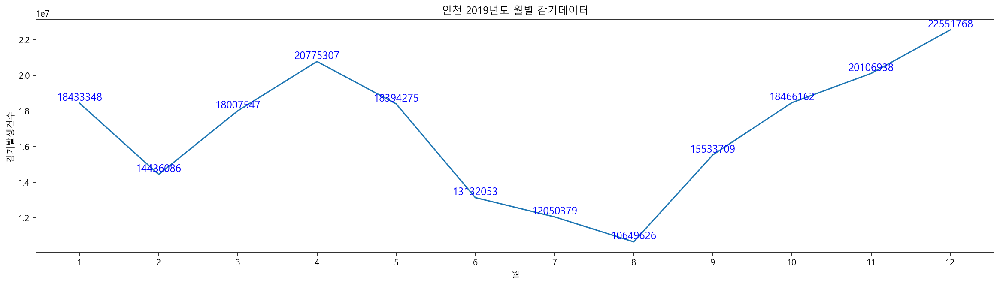

In [235]:
plt.figure(figsize=(20, 5))
plt.title("인천 2019년도 월별 감기데이터")
sns.lineplot(data=df_incheon_2019, x="월", y="감기발생건수")
for i, v in enumerate(df_incheon_2019["월"]):
    plt.text(v, (df_incheon_2019["감기발생건수"])[i], (df_incheon_2019["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

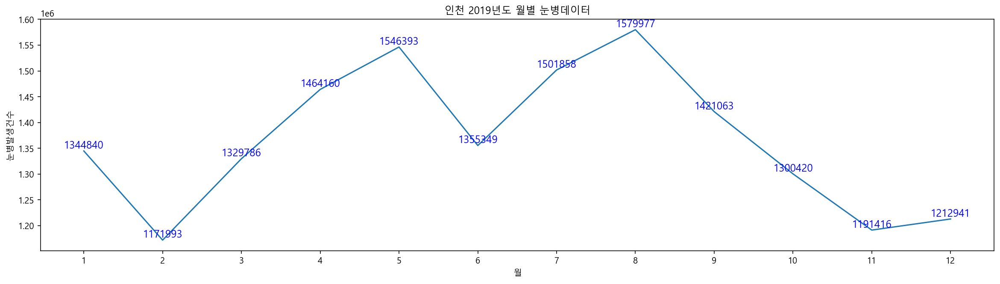

In [236]:
plt.figure(figsize=(20, 5))
plt.title("인천 2019년도 월별 눈병데이터")
sns.lineplot(data=df_incheon_2019, x="월", y="눈병발생건수")
for i, v in enumerate(df_incheon_2019["월"]):
    plt.text(v, (df_incheon_2019["눈병발생건수"])[i], (df_incheon_2019["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

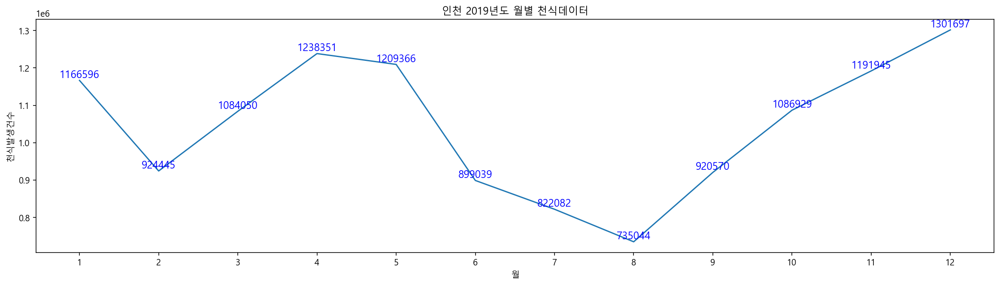

In [237]:
plt.figure(figsize=(20, 5))
plt.title("인천 2019년도 월별 천식데이터")
sns.lineplot(data=df_incheon_2019, x="월", y="천식발생건수")
for i, v in enumerate(df_incheon_2019["월"]):
    plt.text(v, (df_incheon_2019["천식발생건수"])[i], (df_incheon_2019["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

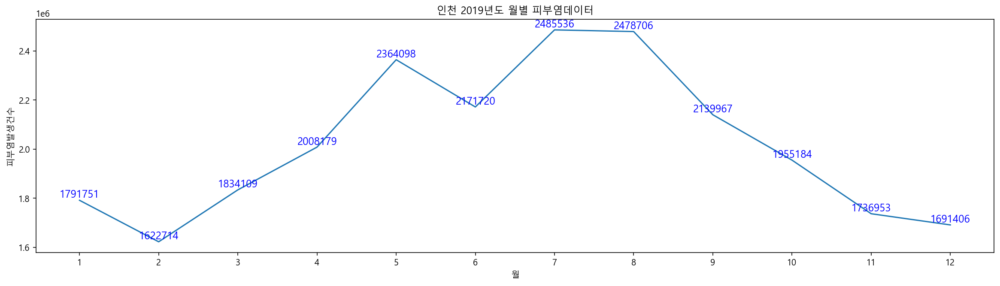

In [238]:
plt.figure(figsize=(20, 5))
plt.title("인천 2019년도 월별 피부염데이터")
sns.lineplot(data=df_incheon_2019, x="월", y="피부염발생건수")
for i, v in enumerate(df_incheon_2019["월"]):
    plt.text(v, (df_incheon_2019["피부염발생건수"])[i], (df_incheon_2019["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 인천 2020년 데이터

In [239]:
df_incheon_2020 = df[(df["시도명"] == "인천광역시") | (df["연도"] == "2020")]
df_incheon_2020 = df_incheon_2020.drop(["연도별 월"], axis=1).copy()
df_incheon_2020["연도"] = df_incheon_2020["연도"].astype("str")
df_incheon_2020 = df_incheon_2020.groupby("월").sum()
df_incheon_2020 = df_incheon_2020.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9"])
df_incheon_2020 = df_incheon_2020.reset_index()

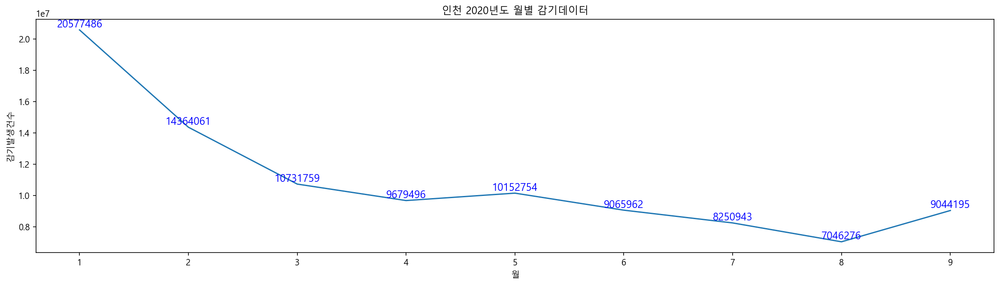

In [240]:
plt.figure(figsize=(20, 5))
plt.title("인천 2020년도 월별 감기데이터")
sns.lineplot(data=df_incheon_2020, x="월", y="감기발생건수")
for i, v in enumerate(df_incheon_2020["월"]):
    plt.text(v, (df_incheon_2020["감기발생건수"])[i], (df_incheon_2020["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

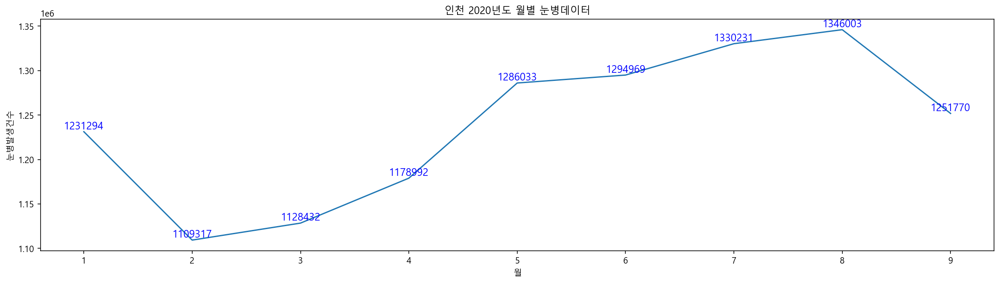

In [241]:
plt.figure(figsize=(20, 5))
plt.title("인천 2020년도 월별 눈병데이터")
sns.lineplot(data=df_incheon_2020, x="월", y="눈병발생건수")
for i, v in enumerate(df_incheon_2020["월"]):
    plt.text(v, (df_incheon_2020["눈병발생건수"])[i], (df_incheon_2020["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

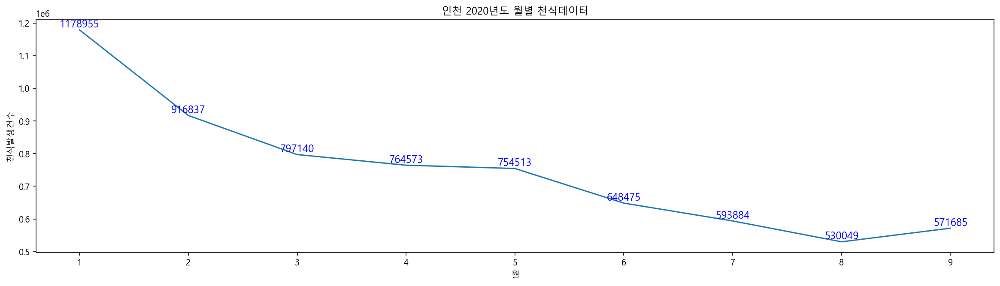

In [242]:
plt.figure(figsize=(20, 5))
plt.title("인천 2020년도 월별 천식데이터")
sns.lineplot(data=df_incheon_2020, x="월", y="천식발생건수")
for i, v in enumerate(df_incheon_2020["월"]):
    plt.text(v, (df_incheon_2020["천식발생건수"])[i], (df_incheon_2020["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

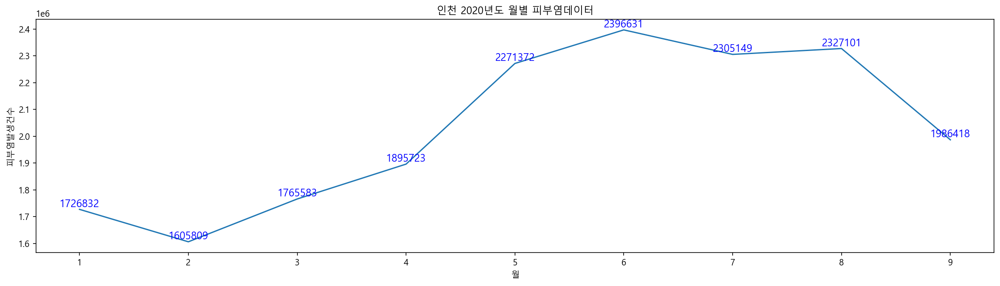

In [243]:
plt.figure(figsize=(20, 5))
plt.title("인천 2020년도 월별 피부염데이터")
sns.lineplot(data=df_incheon_2020, x="월", y="피부염발생건수")
for i, v in enumerate(df_incheon_2020["월"]):
    plt.text(v, (df_incheon_2020["피부염발생건수"])[i], (df_incheon_2020["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

# 광주광역시 데이터

## 광주 전체 데이터

In [244]:
df_gwangju_fool = df[df["시도명"] == "광주광역시"]
df_gwangju_fool = df_gwangju_fool.groupby("연도별 월").sum().copy()
df_gwangju_fool = df_gwangju_fool.reindex(index=["2014-1", "2014-2", "2014-3", "2014-4", "2014-5", "2014-6", "2014-7", "2014-8", "2014-9"
                                  , "2014-10", "2014-11", "2014-12", "2015-1", "2015-2", "2015-3", "2015-4", "2015-5"
                                  , "2015-6", "2015-7", "2015-8", "2015-9", "2015-10", "2015-11", "2015-12", "2016-1"
                                  , "2016-2", "2016-3", "2016-4", "2016-5", "2016-6", "2016-7", "2016-8", "2016-9"
                                  , "2016-10", "2016-11", "2016-12", "2017-1", "2017-2", "2017-3", "2017-4", "2017-5"
                                  , "2017-6", "2017-7", "2017-8", "2017-9", "2017-10", "2017-11", "2017-12", "2018-1"
                                  , "2018-2", "2018-3", "2018-4", "2018-5", "2018-6", "2018-7", "2018-8", "2018-9"
                                  , "2018-10", "2018-11", "2018-12", "2019-1", "2019-2", "2019-3", "2019-4", "2019-5"
                                  , "2019-6", "2019-7", "2019-8", "2019-9", "2019-10", "2019-11", "2019-12", "2020-1"
                                  , "2020-2", "2020-3", "2020-4", "2020-5", "2020-6", "2020-7", "2020-8", "2020-9"])
df_gwangju_fool = df_gwangju_fool.reset_index()

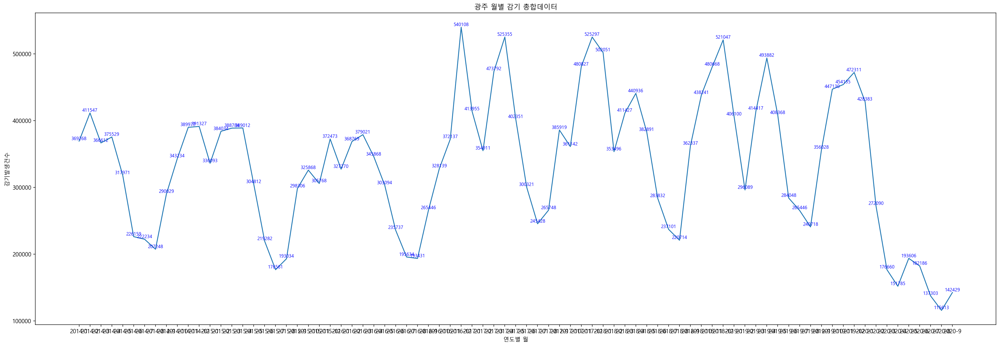

In [245]:
plt.figure(figsize=(30, 10))
plt.title("광주 월별 감기 총합데이터")
sns.lineplot(data=df_gwangju_fool, x="연도별 월", y="감기발생건수")
for i, v in enumerate(df_gwangju_fool["연도별 월"]):
    plt.text(v, (df_gwangju_fool["감기발생건수"])[i], (df_gwangju_fool["감기발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

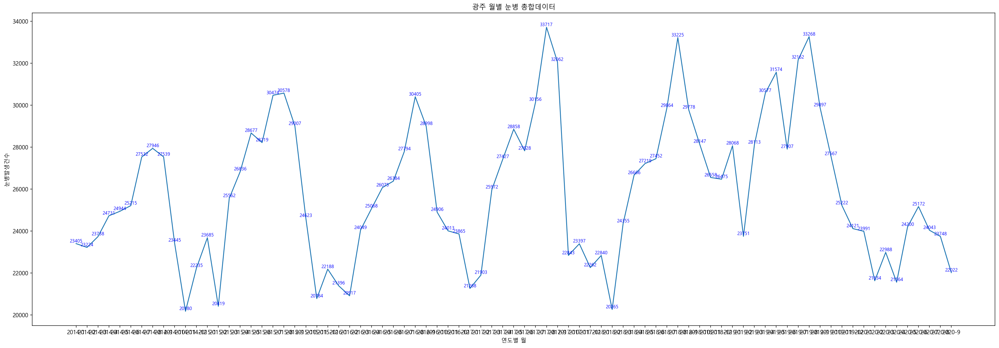

In [246]:
plt.figure(figsize=(30, 10))
plt.title("광주 월별 눈병 총합데이터")
sns.lineplot(data=df_gwangju_fool, x="연도별 월", y="눈병발생건수")
for i, v in enumerate(df_gwangju_fool["연도별 월"]):
    plt.text(v, (df_gwangju_fool["눈병발생건수"])[i], (df_gwangju_fool["눈병발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

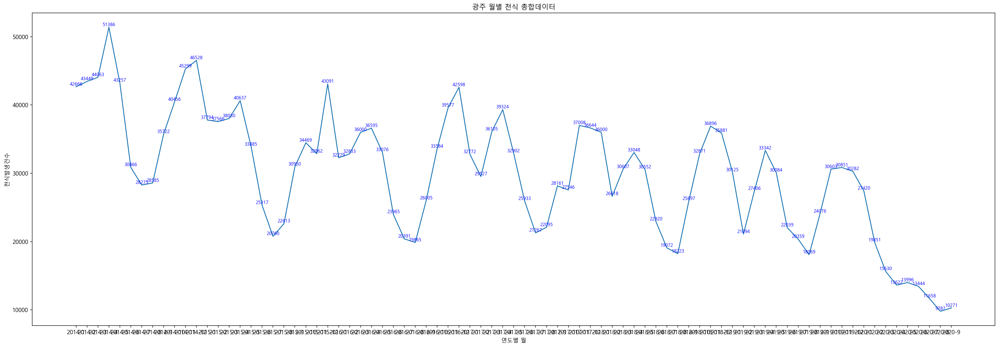

In [247]:
plt.figure(figsize=(30, 10))
plt.title("광주 월별 천식 총합데이터")
sns.lineplot(data=df_gwangju_fool, x="연도별 월", y="천식발생건수")
for i, v in enumerate(df_gwangju_fool["연도별 월"]):
    plt.text(v, (df_gwangju_fool["천식발생건수"])[i], (df_gwangju_fool["천식발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

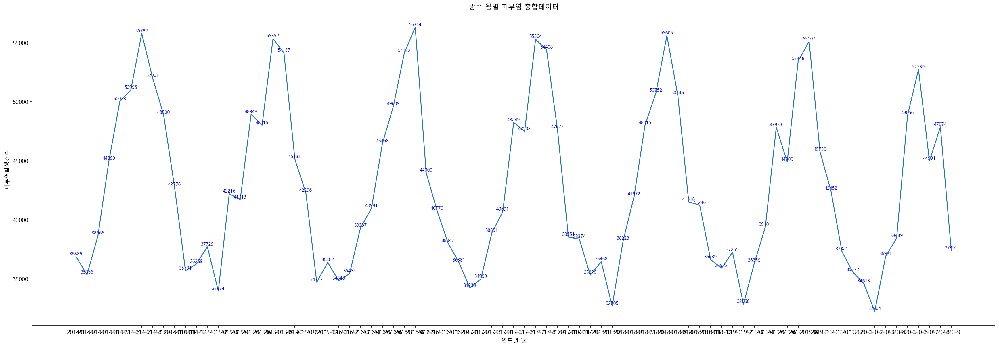

In [248]:
plt.figure(figsize=(30, 10))
plt.title("광주 월별 피부염 총합데이터")
sns.lineplot(data=df_gwangju_fool, x="연도별 월", y="피부염발생건수")
for i, v in enumerate(df_gwangju_fool["연도별 월"]):
    plt.text(v, (df_gwangju_fool["피부염발생건수"])[i], (df_gwangju_fool["피부염발생건수"])[i],fontsize = 8, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

## 광주 2014년 데이터

In [249]:
df_gwangju_2014 = df[(df["시도명"] == "광주광역시") | (df["연도"] == "2014")]
df_gwangju_2014 = df_gwangju_2014.drop(["연도별 월"], axis=1).copy()
df_gwangju_2014["연도"] = df_gwangju_2014["연도"].astype("str")
df_gwangju_2014 = df_gwangju_2014.groupby("월").sum()
df_gwangju_2014 = df_gwangju_2014.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_gwangju_2014 = df_gwangju_2014.reset_index()

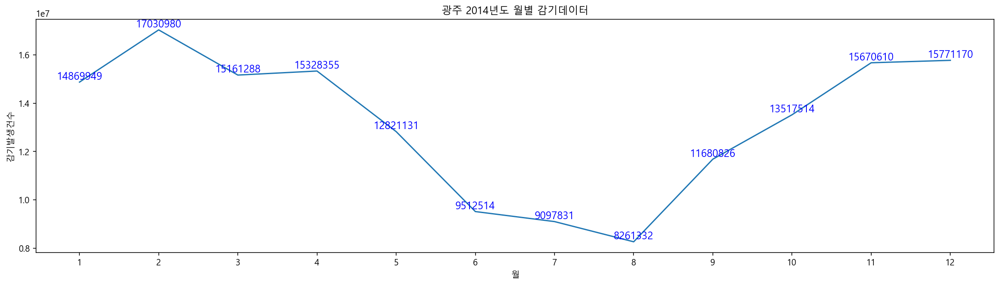

In [250]:
plt.figure(figsize=(20, 5))
plt.title("광주 2014년도 월별 감기데이터")
sns.lineplot(data=df_gwangju_2014, x="월", y="감기발생건수")
for i, v in enumerate(df_gwangju_2014["월"]):
    plt.text(v, (df_gwangju_2014["감기발생건수"])[i], (df_gwangju_2014["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

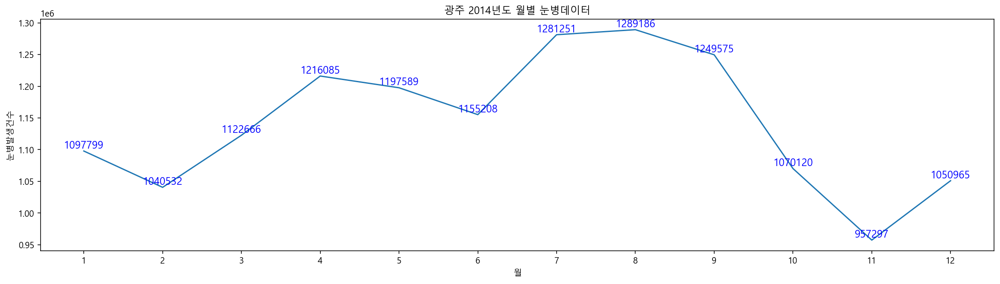

In [251]:
plt.figure(figsize=(20, 5))
plt.title("광주 2014년도 월별 눈병데이터")
sns.lineplot(data=df_gwangju_2014, x="월", y="눈병발생건수")
for i, v in enumerate(df_gwangju_2014["월"]):
    plt.text(v, (df_gwangju_2014["눈병발생건수"])[i], (df_gwangju_2014["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

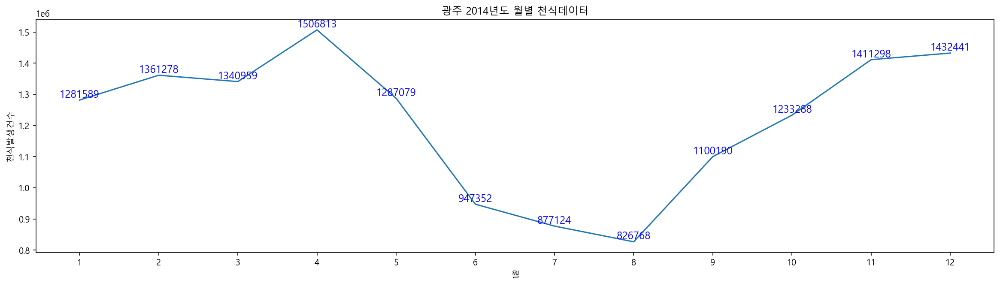

In [252]:
plt.figure(figsize=(20, 5))
plt.title("광주 2014년도 월별 천식데이터")
sns.lineplot(data=df_gwangju_2014, x="월", y="천식발생건수")
for i, v in enumerate(df_gwangju_2014["월"]):
    plt.text(v, (df_gwangju_2014["천식발생건수"])[i], (df_gwangju_2014["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

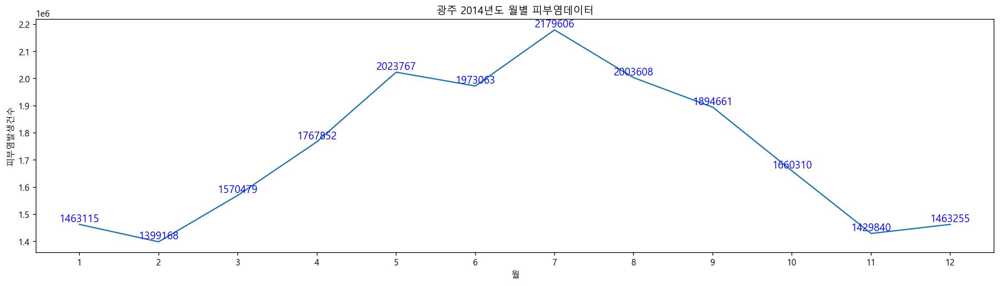

In [253]:
plt.figure(figsize=(20, 5))
plt.title("광주 2014년도 월별 피부염데이터")
sns.lineplot(data=df_gwangju_2014, x="월", y="피부염발생건수")
for i, v in enumerate(df_gwangju_2014["월"]):
    plt.text(v, (df_gwangju_2014["피부염발생건수"])[i], (df_gwangju_2014["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 광주 2015년 데이터

In [254]:
df_gwangju_2015 = df[(df["시도명"] == "광주광역시") | (df["연도"] == "2015")]
df_gwangju_2015 = df_gwangju_2015.drop(["연도별 월"], axis=1).copy()
df_gwangju_2015["연도"] = df_gwangju_2015["연도"].astype("str")
df_gwangju_2015 = df_gwangju_2015.groupby("월").sum()
df_gwangju_2015 = df_gwangju_2015.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_gwangju_2015 = df_gwangju_2015.reset_index()

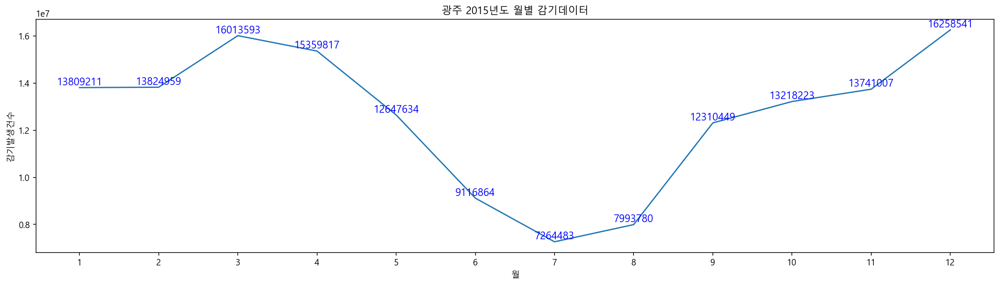

In [255]:
plt.figure(figsize=(20, 5))
plt.title("광주 2015년도 월별 감기데이터")
sns.lineplot(data=df_gwangju_2015, x="월", y="감기발생건수")
for i, v in enumerate(df_gwangju_2015["월"]):
    plt.text(v, (df_gwangju_2015["감기발생건수"])[i], (df_gwangju_2015["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

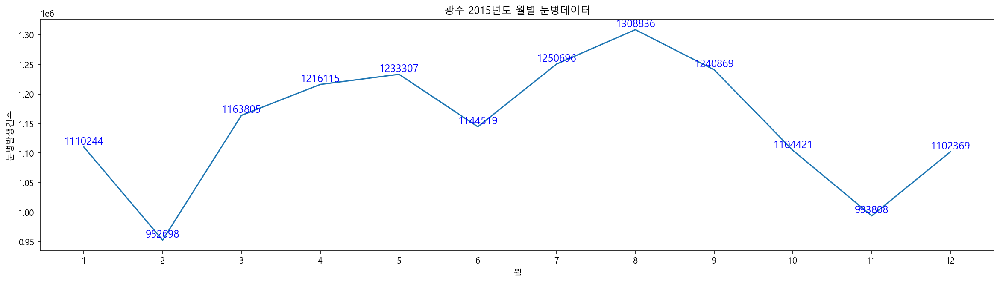

In [256]:
plt.figure(figsize=(20, 5))
plt.title("광주 2015년도 월별 눈병데이터")
sns.lineplot(data=df_gwangju_2015, x="월", y="눈병발생건수")
for i, v in enumerate(df_gwangju_2015["월"]):
    plt.text(v, (df_gwangju_2015["눈병발생건수"])[i], (df_gwangju_2015["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

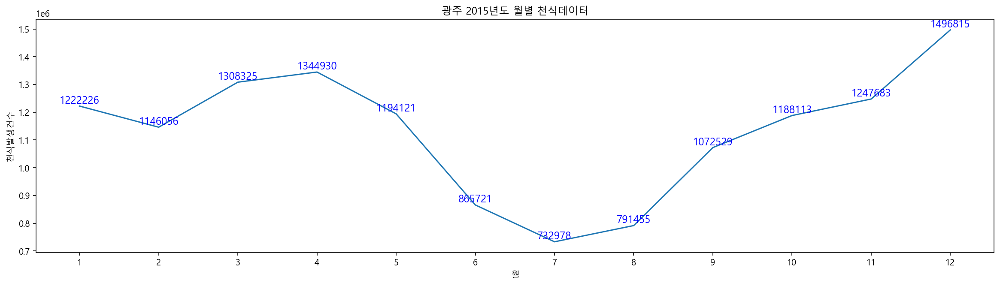

In [257]:
plt.figure(figsize=(20, 5))
plt.title("광주 2015년도 월별 천식데이터")
sns.lineplot(data=df_gwangju_2015, x="월", y="천식발생건수")
for i, v in enumerate(df_gwangju_2015["월"]):
    plt.text(v, (df_gwangju_2015["천식발생건수"])[i], (df_gwangju_2015["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

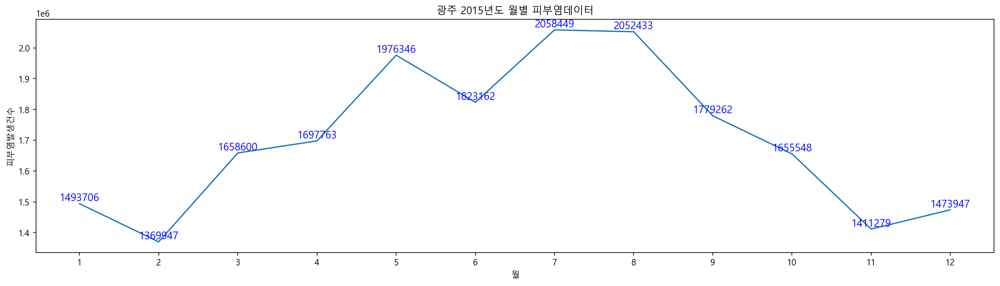

In [258]:
plt.figure(figsize=(20, 5))
plt.title("광주 2015년도 월별 피부염데이터")
sns.lineplot(data=df_gwangju_2015, x="월", y="피부염발생건수")
for i, v in enumerate(df_gwangju_2015["월"]):
    plt.text(v, (df_gwangju_2015["피부염발생건수"])[i], (df_gwangju_2015["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 광주 2016년 데이터

In [260]:
df_gwangju_2016 = df[(df["시도명"] == "광주광역시") | (df["연도"] == "2016")]
df_gwangju_2016 = df_gwangju_2016.drop(["연도별 월"], axis=1).copy()
df_gwangju_2016["연도"] = df_gwangju_2016["연도"].astype("str")
df_gwangju_2016 = df_gwangju_2016.groupby("월").sum()
df_gwangju_2016 = df_gwangju_2016.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_gwangju_2016 = df_gwangju_2016.reset_index()

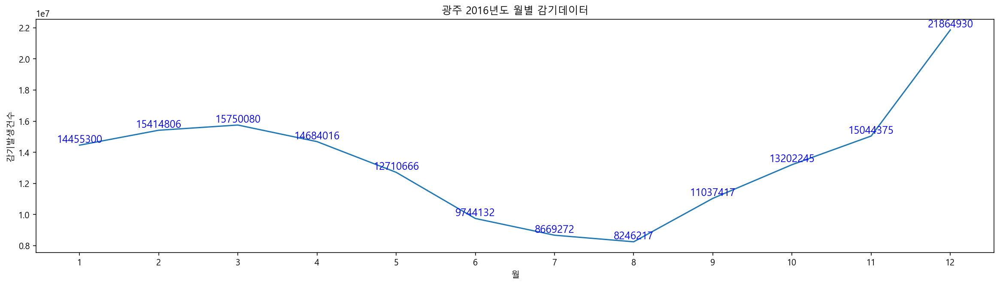

In [261]:
plt.figure(figsize=(20, 5))
plt.title("광주 2016년도 월별 감기데이터")
sns.lineplot(data=df_gwangju_2016, x="월", y="감기발생건수")
for i, v in enumerate(df_gwangju_2016["월"]):
    plt.text(v, (df_gwangju_2016["감기발생건수"])[i], (df_gwangju_2016["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

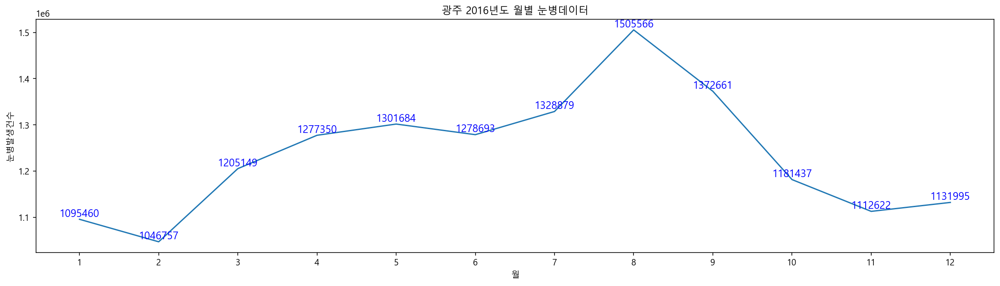

In [262]:
plt.figure(figsize=(20, 5))
plt.title("광주 2016년도 월별 눈병데이터")
sns.lineplot(data=df_gwangju_2016, x="월", y="눈병발생건수")
for i, v in enumerate(df_gwangju_2016["월"]):
    plt.text(v, (df_gwangju_2016["눈병발생건수"])[i], (df_gwangju_2016["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

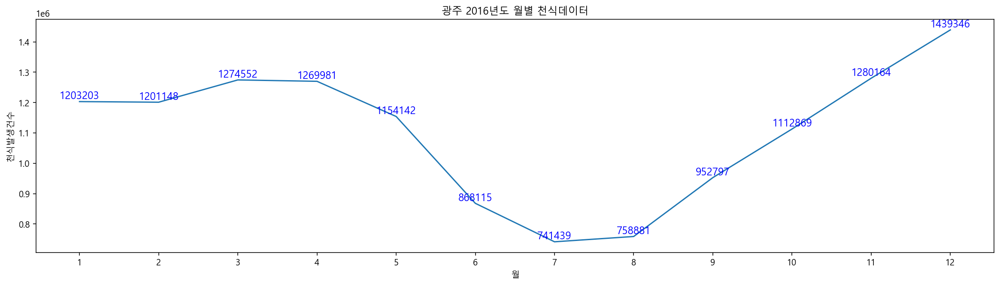

In [263]:
plt.figure(figsize=(20, 5))
plt.title("광주 2016년도 월별 천식데이터")
sns.lineplot(data=df_gwangju_2016, x="월", y="천식발생건수")
for i, v in enumerate(df_gwangju_2016["월"]):
    plt.text(v, (df_gwangju_2016["천식발생건수"])[i], (df_gwangju_2016["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

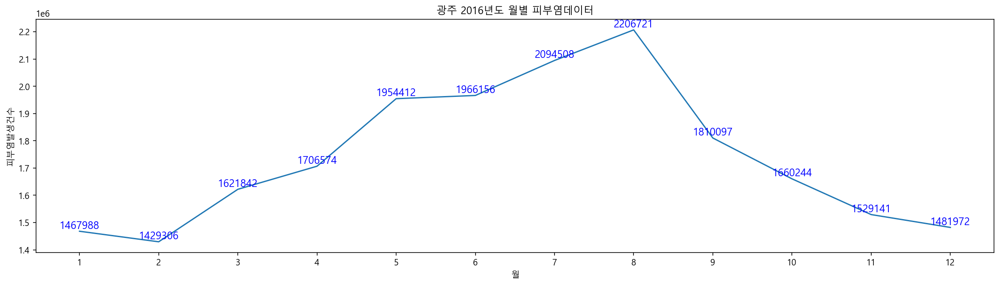

In [264]:
plt.figure(figsize=(20, 5))
plt.title("광주 2016년도 월별 피부염데이터")
sns.lineplot(data=df_gwangju_2016, x="월", y="피부염발생건수")
for i, v in enumerate(df_gwangju_2016["월"]):
    plt.text(v, (df_gwangju_2016["피부염발생건수"])[i], (df_gwangju_2016["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

## 광주 2017년 데이터

In [265]:
df_gwangju_2017 = df[(df["시도명"] == "광주광역시") | (df["연도"] == "2017")]
df_gwangju_2017 = df_gwangju_2017.drop(["연도별 월"], axis=1).copy()
df_gwangju_2017["연도"] = df_gwangju_2017["연도"].astype("str")
df_gwangju_2017 = df_gwangju_2017.groupby("월").sum()
df_gwangju_2017 = df_gwangju_2017.reindex(index=["1", "2", "3", "4", "5", "6", "7", "8", "9", "10", "11", "12"])
df_gwangju_2017 = df_gwangju_2017.reset_index()

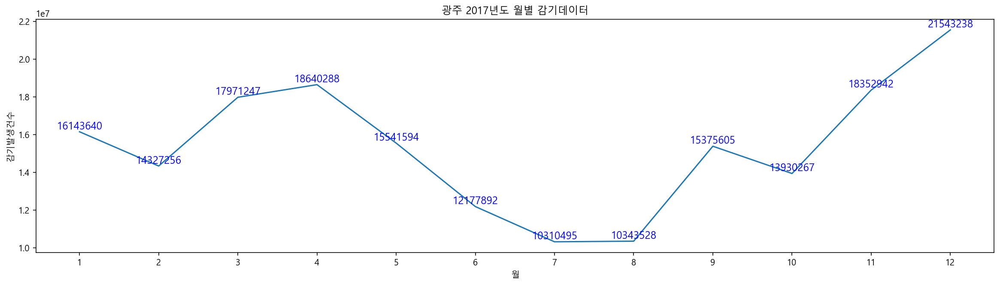

In [266]:
plt.figure(figsize=(20, 5))
plt.title("광주 2017년도 월별 감기데이터")
sns.lineplot(data=df_gwangju_2017, x="월", y="감기발생건수")
for i, v in enumerate(df_gwangju_2017["월"]):
    plt.text(v, (df_gwangju_2017["감기발생건수"])[i], (df_gwangju_2017["감기발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom')  

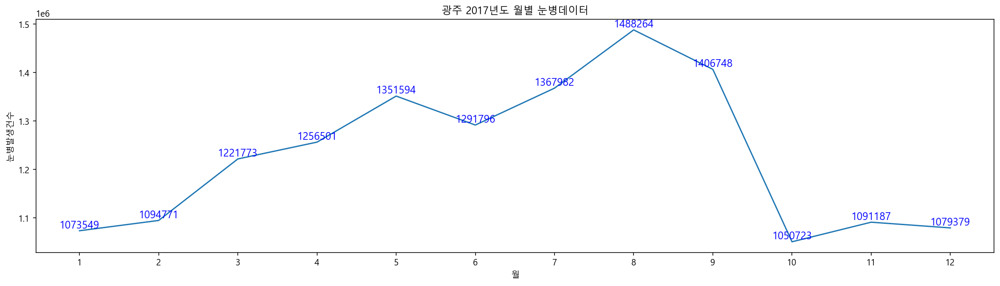

In [267]:
plt.figure(figsize=(20, 5))
plt.title("광주 2017년도 월별 눈병데이터")
sns.lineplot(data=df_gwangju_2017, x="월", y="눈병발생건수")
for i, v in enumerate(df_gwangju_2017["월"]):
    plt.text(v, (df_gwangju_2017["눈병발생건수"])[i], (df_gwangju_2017["눈병발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

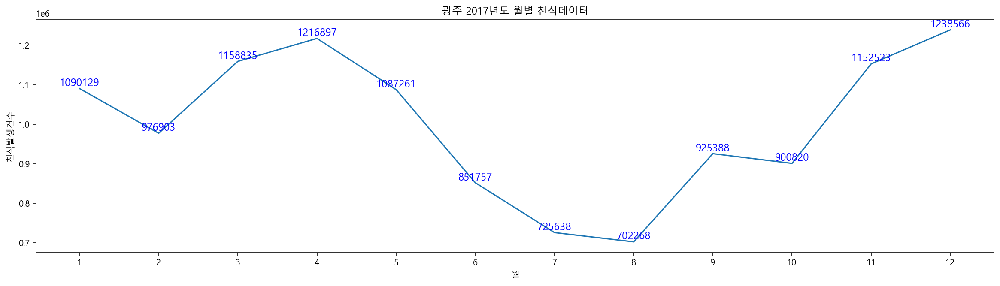

In [268]:
plt.figure(figsize=(20, 5))
plt.title("광주 2017년도 월별 천식데이터")
sns.lineplot(data=df_gwangju_2017, x="월", y="천식발생건수")
for i, v in enumerate(df_gwangju_2017["월"]):
    plt.text(v, (df_gwangju_2017["천식발생건수"])[i], (df_gwangju_2017["천식발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 

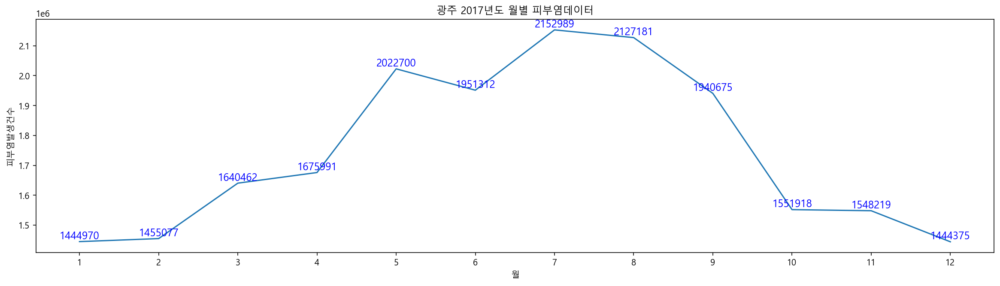

In [269]:
plt.figure(figsize=(20, 5))
plt.title("광주 2017년도 월별 피부염데이터")
sns.lineplot(data=df_gwangju_2017, x="월", y="피부염발생건수")
for i, v in enumerate(df_gwangju_2017["월"]):
    plt.text(v, (df_gwangju_2017["피부염발생건수"])[i], (df_gwangju_2017["피부염발생건수"])[i],fontsize = 12, 
             color='blue', horizontalalignment='center', verticalalignment='bottom') 